In [ ]:
!pip install mat73 opencv-python numpy scipy matplotlib statannotations scikit-learn pandas>=2.2 seaborn plotly umap-learn hdbscan torch torchvision tqdm scprep
!pip install --upgrade pip

ERROR: Could not find a version that satisfies the requirement pickle (from versions: none)
ERROR: No matching distribution found for pickle


In [2]:
# import libraries
import os
os.environ["SCIPY_ARRAY_API"] = "1" 
import sys
sys.path.append("../")
from natsort import natsorted
from tifffile import imread
import pandas as pd 
from skimage import measure
import numpy as np
import matplotlib.pyplot as plt
import mat73
import cv2 as cv
import imageio
import math as mt
import scipy.io
from tqdm import tqdm
import os
from nmco.nuclear_features import (
    global_morphology as BG,
    img_texture as IT,
    int_dist_features as IDF,
    boundary_local_curvature as BLC,
    radial_analysis as RA
)

import pickle
import skimage 
import seaborn as sns
import matplotlib.patches as mpatches
from statannotations.Annotator import Annotator
import napari
import pickle
from skimage.transform import rescale, resize, downscale_local_mean
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from utilities import confidence_ellipse
from sklearn.manifold import TSNE

In [3]:
nmco_features_filtered_live=pd.read_csv('nmco_features_filtered_jumbled_26th_aug.csv', index_col = 0)

# with open('raw_images_cleaned.pkl', 'rb') as f:
#     labelled_images = pickle.load(f)
# with open('labelled_images_cleaned.pkl', 'rb') as f:
#     raw_images = pickle.load(f)    
# with open('hi_images_cleaned.pkl', 'rb') as f:
#     hi_images = pickle.load(f)
# nmco_features_filtered_live

In [4]:
nmco_features_filtered_live = nmco_features_filtered_live.drop('Unnamed: 0.1',axis = 1)


In [5]:
paired_palette = sns.color_palette("Paired", n_colors=8)
custom_paired_palette={
    'Healthy': paired_palette[1],
    'Diabetic':paired_palette[5],
    'Prediabetic': paired_palette[7],
    'Hypertension':paired_palette[3]    
}

custom_paired_palette_2={
    'Healthy_compressed': paired_palette[1],
    'Diabetic_compressed':paired_palette[5],
    'Prediabetic_compressed': paired_palette[7],
    'Hypertension_compressed':paired_palette[3],    
    'Healthy_control': paired_palette[0],
    'Diabetic_control':paired_palette[4],
    'Prediabetic_control': paired_palette[6],
    'Hypertension_control':paired_palette[2]   
}

force_palette = sns.color_palette("Dark2", n_colors=8)
custom_force_palette={
    'control': force_palette[1],
    'compressed':force_palette[0]
} 

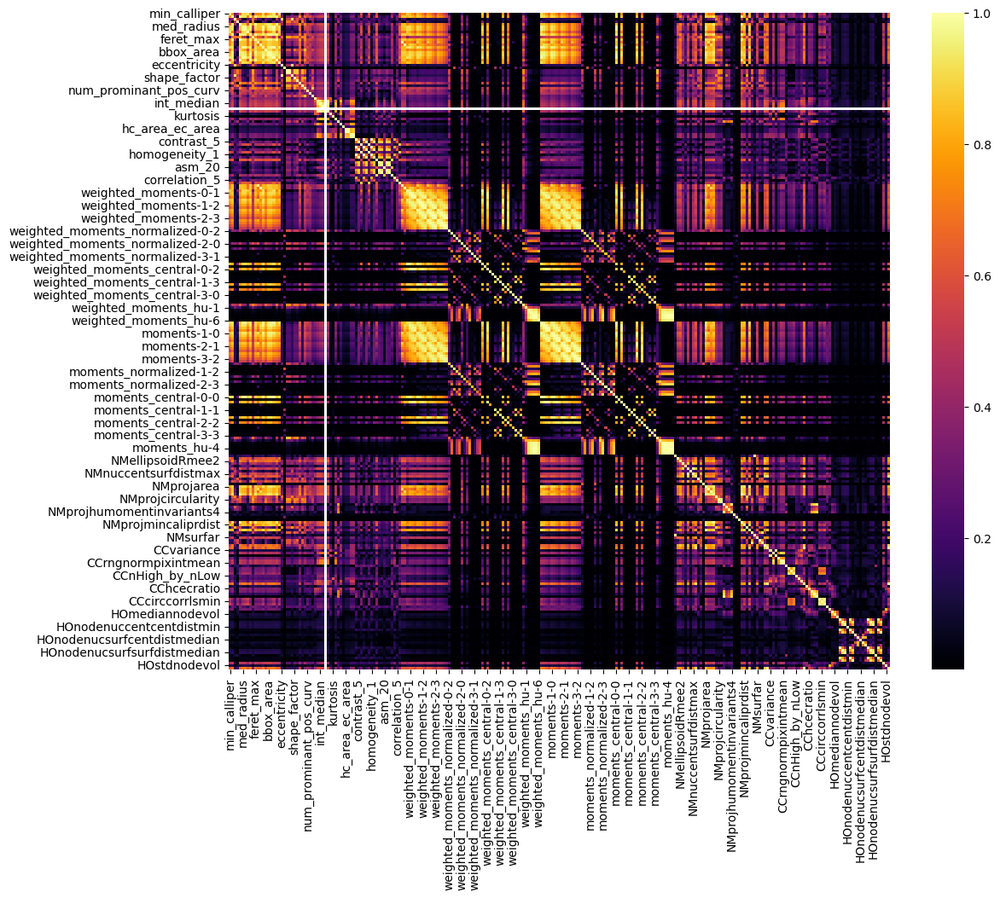

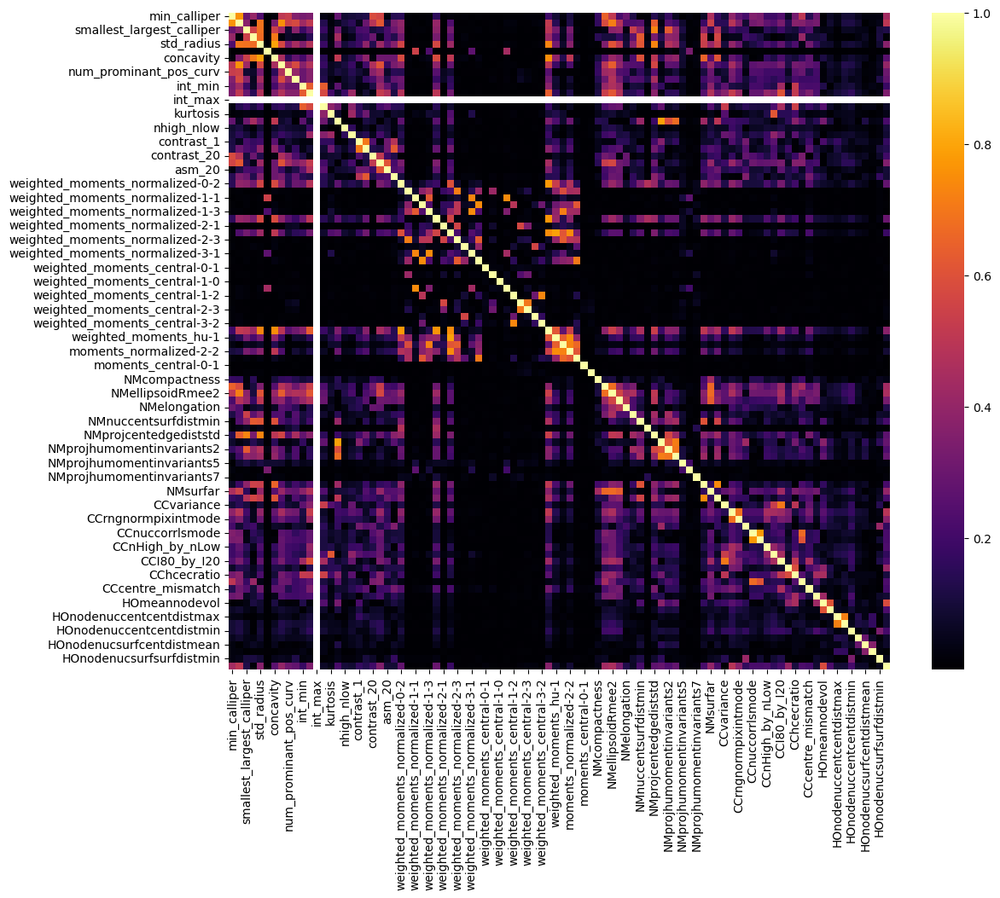

In [6]:
correl_df=nmco_features_filtered_live.drop(['Unnamed: 0','mean_draq_int','patient_id','constriction_size',
                                            'disease','disease_constric','patient_id_constric',
                                           'quality_check','live_dead_test','% Live Dead'],axis=1)

corr_matrix = correl_df.corr().abs()
fig, ax_nstd = plt.subplots(figsize=(12.5, 10))
dataplot = sns.heatmap(corr_matrix, cmap="inferno", annot=False)
plt.show()


upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.8)]

nmco_features_filtered_live_decor = nmco_features_filtered_live.drop(to_drop, axis=1)
nmco_features_filtered_live_decor = nmco_features_filtered_live_decor.drop('Unnamed: 0', axis=1)
correl_df=nmco_features_filtered_live_decor.drop(['patient_id','mean_draq_int','constriction_size',
                                            'disease','disease_constric','patient_id_constric',
                                           'quality_check','live_dead_test','% Live Dead'],axis=1)

corr_matrix = correl_df.corr().abs()
corr_matrix
fig, ax_nstd = plt.subplots(figsize=(12.5, 10))
dataplot = sns.heatmap(corr_matrix, cmap="inferno", annot=False)
plt.show()




Diabetic_compressed
['Diabetic_compressed']


Diabetic_control
['Diabetic_control']
Healthy_compressed
['Healthy_compressed']
Healthy_control
['Healthy_control']
Hypertension_compressed
['Hypertension_compressed']
Hypertension_control
['Hypertension_control']
Prediabetic_compressed
['Prediabetic_compressed']
Prediabetic_control
['Prediabetic_control']


<Figure size 640x480 with 0 Axes>

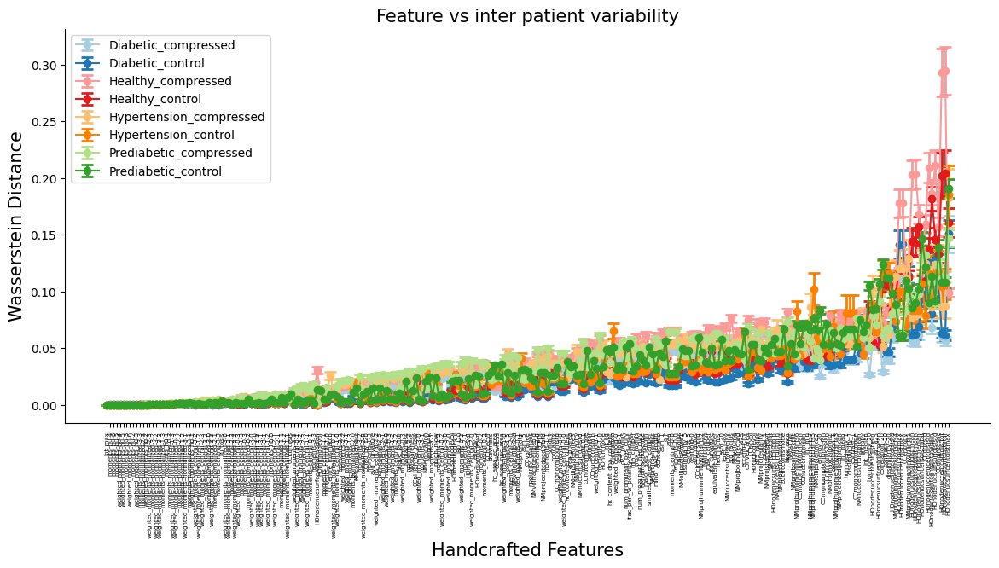

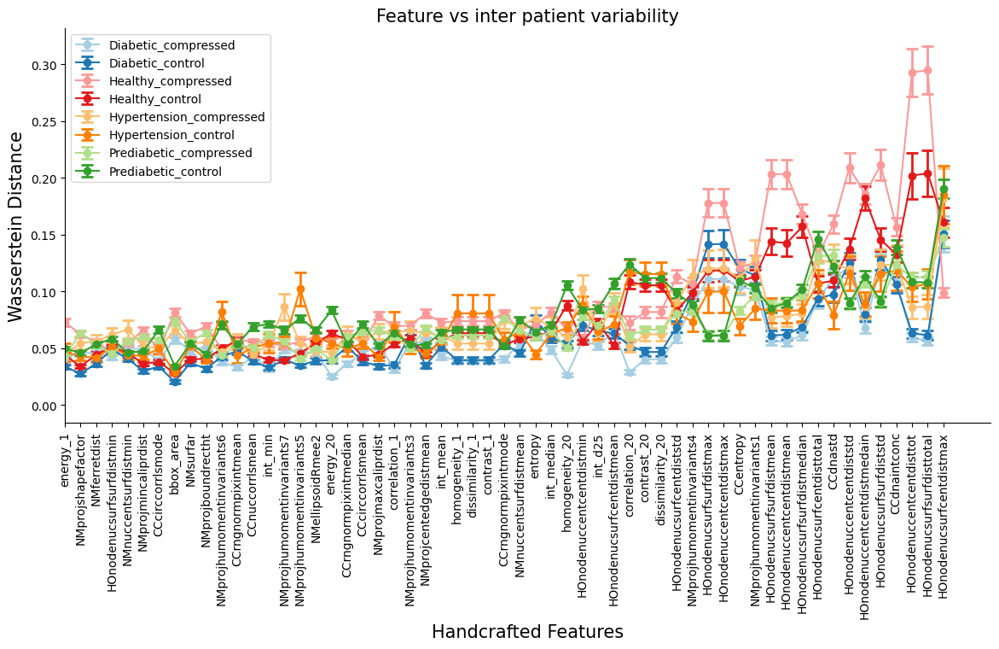

In [7]:
from sklearn.preprocessing import MinMaxScaler
import itertools
from utilities import wasserstein_distance_df



nmco_features_filtered_live_ul=nmco_features_filtered_live.drop(['Unnamed: 0',
                                    'patient_id','disease','disease_constric','disease','patient_id_constric',
                                    'quality_check','live_dead_test','mean_draq_int','constriction_size','% Live Dead',
                                    'mean_draq_int'],axis=1)


scaler = MinMaxScaler()
nmco_features_filtered_live_ul_scaled=scaler.fit_transform(nmco_features_filtered_live_ul)
nmco_features_filtered_live_scaled=pd.DataFrame(nmco_features_filtered_live_ul_scaled,columns=
                                                         nmco_features_filtered_live_ul.columns.values)
nmco_features_filtered_live_scaled['patient_id']=np.asarray(nmco_features_filtered_live['patient_id'])
nmco_features_filtered_live_scaled['disease_constric']=np.asarray(nmco_features_filtered_live['disease_constric'])
nmco_features_filtered_live_scaled['disease']=np.asarray(nmco_features_filtered_live['disease'])
nmco_features_filtered_live_scaled['constriction_size']=np.asarray(nmco_features_filtered_live['constriction_size'])

count=0
wasserstein_df_formatted_final=[]
disease_col=[]
for disease in np.unique(nmco_features_filtered_live_scaled['disease_constric']):
    print(disease)
    disease_data_frames_lev1=nmco_features_filtered_live_scaled[nmco_features_filtered_live_scaled['disease_constric']==disease]
    print(np.unique(disease_data_frames_lev1['disease_constric']))
    number_pats=np.unique(disease_data_frames_lev1['patient_id'])
    combin=list(itertools.combinations(number_pats, 2))
    for a_combin in combin: 
        comb1_df=disease_data_frames_lev1[disease_data_frames_lev1['patient_id']==a_combin[0]]
        comb2_df=disease_data_frames_lev1[disease_data_frames_lev1['patient_id']==a_combin[1]]
        comb1_df=comb1_df.drop(['patient_id','disease_constric','disease','constriction_size'],axis=1)
        comb2_df=comb2_df.drop(['patient_id','disease_constric','disease','constriction_size'],axis=1)
        wasserstein_df=wasserstein_distance_df(comb1_df,comb2_df)
        wasserstein_df_formatted=pd.DataFrame(columns=wasserstein_df['Column'])
        wasserstein_df_formatted.loc[count]=np.asarray(wasserstein_df['Wasserstein Distance'])
        wasserstein_df_formatted_final.append(wasserstein_df_formatted)
        disease_col.append(disease)
        count=count+1
        
wasserstein_df_formatted_final = pd.concat(wasserstein_df_formatted_final, ignore_index=True)
wasserstein_df_formatted_final['disease']=disease_col     
wasserstein_df_formatted_final

paired_palette = sns.color_palette("Paired", n_colors=8)
compressed_palette = [paired_palette[0],paired_palette[6],paired_palette[2],paired_palette[4]]
control_palette = [paired_palette[1],paired_palette[7],paired_palette[3],paired_palette[5]]
both_palette = [paired_palette[0],paired_palette[1],paired_palette[4],paired_palette[5],
                paired_palette[6],paired_palette[7],paired_palette[2],paired_palette[3]]

means_final = wasserstein_df_formatted_final.drop(['disease'],axis=1).mean()
sns.despine()
plt.figure(figsize=(14, 6))
count=0
for disease in np.unique(wasserstein_df_formatted_final['disease']):
    means = wasserstein_df_formatted_final.iloc[np.where(wasserstein_df_formatted_final['disease']
                                                         ==disease)].drop(['disease'],axis=1).mean()
    means = means[np.argsort(means_final)]
    errors = wasserstein_df_formatted_final.iloc[np.where(wasserstein_df_formatted_final['disease']
                                                          ==disease)].drop(['disease'],axis=1).sem()
    errors = errors[np.argsort(means_final)]

    plt.errorbar(x = means.index, y=means, yerr=errors, 
                 fmt='-o', capsize=5, capthick=2, elinewidth=2,color=both_palette[count])
    count=count+1
    

sns.despine()
plt.legend(np.unique(wasserstein_df_formatted_final['disease']))
plt.xlabel('Handcrafted Features',fontsize=15)
plt.xticks(rotation=90,fontsize=5)
plt.ylabel('Wasserstein Distance',fontsize=15)
plt.title('Feature vs inter patient variability',fontsize=15)    
plt.show()

plt.figure(figsize=(14, 6))
count=0
for disease in np.unique(wasserstein_df_formatted_final['disease']):
    means = wasserstein_df_formatted_final.iloc[np.where(wasserstein_df_formatted_final['disease']
                                                         ==disease)].drop(['disease'],axis=1).mean()
    means = means[np.argsort(means_final)]
    errors = wasserstein_df_formatted_final.iloc[np.where(wasserstein_df_formatted_final['disease']
                                                          ==disease)].drop(['disease'],axis=1).sem()
    errors = errors[np.argsort(means_final)]

    plt.errorbar(x = means.index, y=means, yerr=errors, 
                 fmt='-o', capsize=5, capthick=2, elinewidth=2,color=both_palette[count])
    count=count+1
    
sns.despine()
plt.xlim(200,259)
plt.legend(np.unique(wasserstein_df_formatted_final['disease']))
plt.xlabel('Handcrafted Features',fontsize=15)
plt.xticks(rotation=90,fontsize=10)
plt.ylabel('Wasserstein Distance',fontsize=15)
plt.title('Feature vs inter patient variability',fontsize=15)    
plt.show()


In [8]:
wasserstein_df_formatted_final

Column,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmax,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,disease
0,0.067103,0.069188,0.014563,0.052998,0.062044,0.072846,0.067648,0.052028,0.080701,0.068945,...,0.005158,0.041522,0.037275,0.032428,0.014871,0.032951,0.046738,0.008920,0.060061,Diabetic_compressed
1,0.033532,0.053830,0.046910,0.027324,0.050011,0.044025,0.039361,0.026814,0.050818,0.063419,...,0.246797,0.005625,0.144524,0.034094,0.245254,0.004464,0.006637,0.010664,0.023078,Diabetic_compressed
2,0.039788,0.024183,0.034206,0.043812,0.017817,0.039280,0.037744,0.035075,0.038798,0.037852,...,0.246797,0.079220,0.052837,0.063874,0.307466,0.062865,0.018752,0.023412,0.072473,Diabetic_compressed
3,0.016177,0.024068,0.022965,0.051736,0.026481,0.015131,0.010110,0.008899,0.020083,0.053833,...,0.246797,0.106967,0.022078,0.024790,0.314891,0.084885,0.010660,0.012162,0.013185,Diabetic_compressed
4,0.067496,0.071569,0.014433,0.049599,0.056332,0.077551,0.077466,0.067710,0.083079,0.042154,...,0.246797,0.034616,0.062960,0.030673,0.250147,0.027470,0.035273,0.022647,0.100489,Diabetic_compressed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1037,0.036028,0.030955,0.019028,0.018923,0.028844,0.035190,0.033155,0.030264,0.035156,0.022951,...,0.000525,0.022652,0.043312,0.050350,0.021408,0.020381,0.036690,0.007366,0.011724,Prediabetic_control
1038,0.028193,0.037881,0.023584,0.018878,0.039703,0.036274,0.035831,0.026906,0.044155,0.043268,...,0.000000,0.037241,0.040238,0.010255,0.014265,0.033505,0.037750,0.016310,0.058741,Prediabetic_control
1039,0.022139,0.033677,0.067941,0.027564,0.029926,0.026461,0.025684,0.023352,0.032079,0.043421,...,0.000525,0.023247,0.029293,0.016022,0.023291,0.020916,0.014174,0.011456,0.061211,Prediabetic_control
1040,0.025120,0.025773,0.033246,0.026287,0.018212,0.022025,0.022115,0.022931,0.023072,0.024559,...,0.000000,0.042428,0.074597,0.065927,0.017599,0.038172,0.013186,0.007075,0.011733,Prediabetic_control


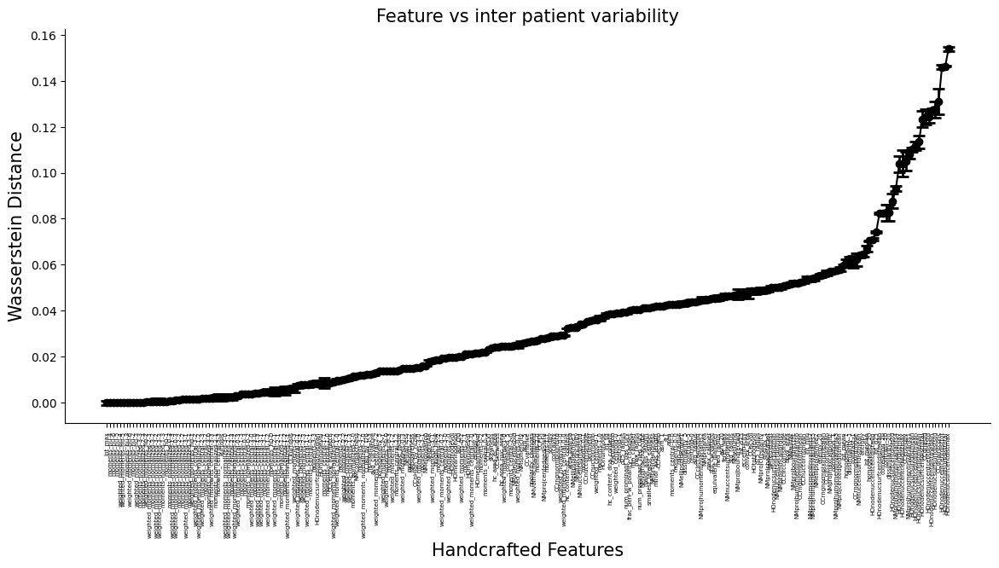

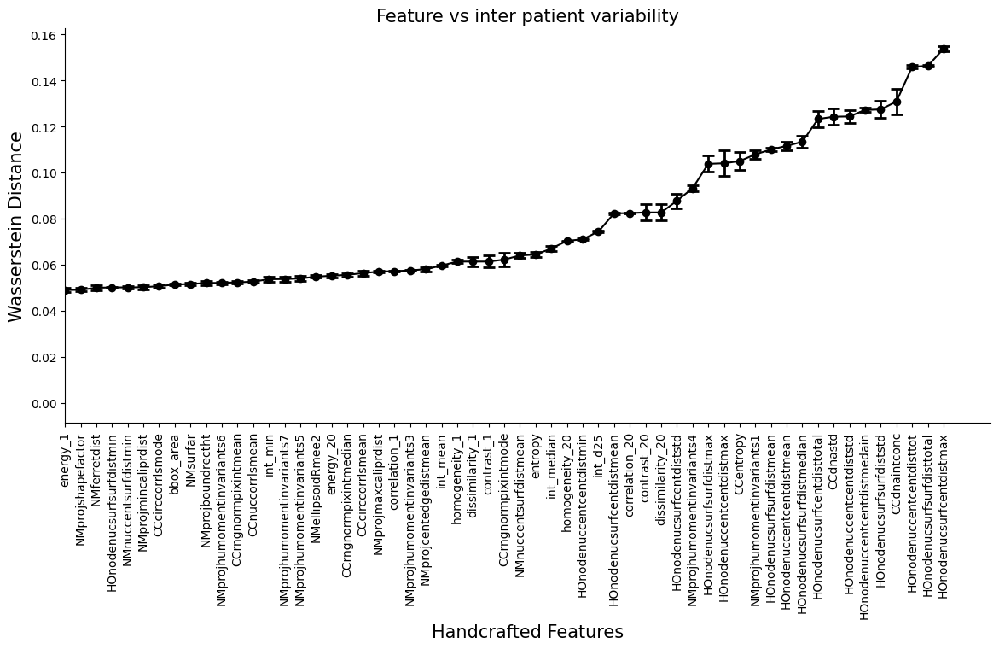

In [9]:
paired_palette = sns.color_palette("Paired", n_colors=8)
compressed_palette = [paired_palette[0],paired_palette[6],paired_palette[2],paired_palette[4]]
control_palette = [paired_palette[1],paired_palette[7],paired_palette[3],paired_palette[5]]
both_palette = [paired_palette[0],paired_palette[1],paired_palette[4],paired_palette[5],
                paired_palette[6],paired_palette[7],paired_palette[2],paired_palette[3]]

means_final = wasserstein_df_formatted_final.drop(['disease'],axis=1).mean()
means_final = means_final[np.argsort(means_final)]
errors_final = wasserstein_df_formatted_final.drop(['disease'],axis=1).sem()
errors_final = errors_final[np.argsort(means_final)]

plt.figure(figsize=(14, 6))
plt.errorbar(x = means_final.index, y = means_final, yerr=errors_final, 
                 fmt='-o', capsize=5, capthick=2, elinewidth=2,color="black")
    
plt.xlabel('Handcrafted Features',fontsize=15)
plt.xticks(rotation=90,fontsize=5)
plt.ylabel('Wasserstein Distance',fontsize=15)
plt.title('Feature vs inter patient variability',fontsize=15)    
sns.despine()
plt.show()

plt.figure(figsize=(14, 6))
plt.errorbar(x = means_final.index, y = means_final, yerr=errors_final, 
                 fmt='-o', capsize=5, capthick=2, elinewidth=2,color="black")
sns.despine()    
plt.xlim(200,259)
plt.xlabel('Handcrafted Features',fontsize=15)
plt.xticks(rotation=90,fontsize=10)
plt.ylabel('Wasserstein Distance',fontsize=15)
plt.title('Feature vs inter patient variability',fontsize=15)    
plt.show()


In [10]:
columns_to_remove=means_final[means_final>0.06].index
list_1 = columns_to_remove.tolist()
list_2 = to_drop
intersection_of_two = list(set(list_1) & set(list_2)) 


In [11]:
columns_to_remove=means_final[means_final>0.09].index
columns_to_remove_1=list(columns_to_remove)#+to_drop
nmco_features_filtered_live_ul_non_rep=nmco_features_filtered_live_ul#.drop(columns=intersection_of_two)
nmco_features_filtered_live_ul_non_rep
#intersection_of_two = intersection_of_two+['mean_draq_int']
intersection_of_two = ['mean_draq_int']
intersection_of_two
nmco_features_filtered_live_non_rep=nmco_features_filtered_live.drop(columns=intersection_of_two)
nmco_features_filtered_live_non_rep


,Unnamed: 0,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,...,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,quality_check,live_dead_test,% Live Dead
49241,49241,19,25,0.760000,7.537010,12.276579,10.597783,10.284180,9.508854,11.179392,...,2.6508,17.7500,67,compressed,Diabetic,Diabetic_compressed,67_compressed,False,live,1
28987,28987,26,31,0.838710,0.403128,16.774623,12.708127,11.545278,10.136984,13.972618,...,4.1661,26.9375,64,compressed,Diabetic,Diabetic_compressed,64_compressed,False,live,1
50310,50310,24,28,0.857143,10.746345,13.764896,12.350940,12.321868,11.814453,12.775133,...,2.9163,25.1250,69,compressed,Diabetic,Diabetic_compressed,69_compressed,False,live,1
36292,36292,24,28,0.857143,10.835895,13.499463,12.353904,12.247788,11.695951,12.710870,...,2.9197,25.6250,35,compressed,Diabetic,Diabetic_compressed,35_compressed,False,live,1
17132,17132,20,24,0.833333,8.283725,11.817571,10.091342,9.971836,9.540704,10.558939,...,2.5463,12.5625,46,compressed,Diabetic,Diabetic_compressed,46_compressed,False,live,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37898,37898,16,23,0.695652,6.355464,11.317482,8.806850,8.736037,7.545655,9.711553,...,2.2258,20.0625,37,control,Prediabetic,Prediabetic_control,37_control,False,live,1
55491,55491,15,19,0.789474,6.369901,8.857498,7.833384,7.788821,7.408292,8.377889,...,3.1815,9.0000,82,control,Prediabetic,Prediabetic_control,82_control,False,live,1
40759,40759,16,19,0.842105,6.159579,9.466861,8.302517,8.202241,7.988138,8.607600,...,4.6040,11.3750,45,control,Prediabetic,Prediabetic_control,45_control,False,live,1
41755,41755,17,20,0.850000,7.365328,9.361704,8.453453,8.383671,8.030220,8.777887,...,3.3466,11.5000,45,control,Prediabetic,Prediabetic_control,45_control,False,live,1


In [407]:
nmco_features_filtered_live_ul_non_rep

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfcentdisttotal,HOnodenucsurfsurfdistmax,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol
49241,19,25,0.760000,7.537010,12.276579,10.597783,10.284180,9.508854,11.179392,1.187897,...,34.3007,14.1704,6.0966,5.4684,0.263490,3.2651,1085.2018,9,2.6508,17.7500
28987,26,31,0.838710,0.403128,16.774623,12.708127,11.545278,10.136984,13.972618,3.987698,...,35.8330,18.0063,6.0736,5.3746,0.442510,3.8573,953.5478,15,4.1661,26.9375
50310,24,28,0.857143,10.746345,13.764896,12.350940,12.321868,11.814453,12.775133,0.710913,...,34.6794,14.1704,6.0848,5.3718,0.201080,3.1891,1083.0858,10,2.9163,25.1250
36292,24,28,0.857143,10.835895,13.499463,12.353904,12.247788,11.695951,12.710870,0.696841,...,19.9580,12.1116,5.4460,5.4185,0.517880,2.7641,855.0151,7,2.9197,25.6250
17132,20,24,0.833333,8.283725,11.817571,10.091342,9.971836,9.540704,10.558939,0.809844,...,28.0191,18.0063,5.7754,4.3752,0.345580,3.8810,906.7396,8,2.5463,12.5625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37898,16,23,0.695652,6.355464,11.317482,8.806850,8.736037,7.545655,9.711553,1.297886,...,53.5548,12.1116,4.7763,4.1919,0.188320,2.5168,749.8744,6,2.2258,20.0625
55491,15,19,0.789474,6.369901,8.857498,7.833384,7.788821,7.408292,8.377889,0.678280,...,49.4970,14.1704,5.8154,5.2484,0.067471,3.2030,1035.1467,7,3.1815,9.0000
40759,16,19,0.842105,6.159579,9.466861,8.302517,8.202241,7.988138,8.607600,0.660177,...,23.2728,12.1116,4.8961,4.2324,0.357010,2.6259,768.6902,5,4.6040,11.3750
41755,17,20,0.850000,7.365328,9.361704,8.453453,8.383671,8.030220,8.777887,0.511570,...,31.5501,12.1116,4.8371,4.1919,0.377780,2.5719,759.4319,5,3.3466,11.5000


In [408]:
nmco_features_filtered_live_non_rep.columns.tolist()

['Unnamed: 0',
 'min_calliper',
 'max_calliper',
 'smallest_largest_calliper',
 'min_radius',
 'max_radius',
 'med_radius',
 'avg_radius',
 'd25_radius',
 'd75_radius',
 'std_radius',
 'feret_max',
 'centroid-0',
 'centroid-1',
 'area',
 'perimeter',
 'bbox_area',
 'convex_area',
 'equivalent_diameter',
 'major_axis_length',
 'minor_axis_length',
 'eccentricity',
 'orientation',
 'concavity',
 'solidity',
 'a_r',
 'shape_factor',
 'area_bbarea',
 'avg_curvature',
 'std_curvature',
 'npolarity_changes',
 'num_prominant_pos_curv',
 'num_prominant_neg_curv',
 'frac_peri_w_polarity_changes',
 'int_min',
 'int_d25',
 'int_median',
 'int_d75',
 'int_max',
 'int_mean',
 'int_sd',
 'kurtosis',
 'skewness',
 'entropy',
 'i80_i20',
 'nhigh_nlow',
 'hc_area_ec_area',
 'hc_area_nuc_area',
 'hc_content_ec_content',
 'hc_content_dna_content',
 'contrast_1',
 'contrast_5',
 'contrast_20',
 'dissimilarity_1',
 'dissimilarity_5',
 'dissimilarity_20',
 'homogeneity_1',
 'homogeneity_5',
 'homogeneity_20

In [409]:
from sklearn.preprocessing import MinMaxScaler

nmco_features_filtered_live_sorted=nmco_features_filtered_live_non_rep
nmco_features_filtered_live_sorted_unlabelled=nmco_features_filtered_live_sorted.drop(['Unnamed: 0','patient_id','constriction_size','disease'
                                                                                       ,'disease_constric','patient_id_constric','quality_check','live_dead_test','% Live Dead'],axis=1)
nmco_features_filtered_live_sorted_unlabelled
scaler = MinMaxScaler()
nmco_features_filtered_live_scaled=scaler.fit_transform(nmco_features_filtered_live_sorted_unlabelled)
nmco_features_filtered_live_scaled_unlabelled=pd.DataFrame(nmco_features_filtered_live_scaled,columns=nmco_features_filtered_live_sorted_unlabelled.columns.values)
nmco_features_filtered_live_scaled_unlabelled
nmco_features_filtered_live_scaled_labelled=nmco_features_filtered_live_scaled_unlabelled.copy()
nmco_features_filtered_live_scaled_labelled['patient_id']=nmco_features_filtered_live['patient_id'].reset_index(drop=True).astype(str)
nmco_features_filtered_live_scaled_labelled['constriction_size']=nmco_features_filtered_live['constriction_size'].reset_index(drop=True).astype(str)
nmco_features_filtered_live_scaled_labelled['disease']=nmco_features_filtered_live['disease'].reset_index(drop=True).astype(str)
nmco_features_filtered_live_scaled_labelled['disease_constric']=nmco_features_filtered_live_scaled_labelled['disease']+'_'+nmco_features_filtered_live_scaled_labelled['constriction_size']
nmco_features_filtered_live_scaled_labelled['patient_id_constric']=nmco_features_filtered_live_scaled_labelled['patient_id']+'_'+nmco_features_filtered_live_scaled_labelled['constriction_size']


In [410]:
nmco_features_filtered_live_scaled_labelled

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric
0,0.386364,0.344828,0.704071,0.350616,0.274579,0.417354,0.403727,0.389468,0.386713,0.106607,...,0.542150,0.835396,0.126984,0.094014,0.144777,67,compressed,Diabetic,Diabetic_compressed,67_compressed
1,0.545455,0.448276,0.812732,0.018017,0.395715,0.512238,0.461012,0.418677,0.500371,0.428873,...,0.664538,0.732879,0.222222,0.147756,0.234575,64,compressed,Diabetic,Diabetic_compressed,64_compressed
2,0.500000,0.396552,0.838180,0.500243,0.314661,0.496179,0.496289,0.496681,0.451645,0.051705,...,0.526443,0.833748,0.142857,0.103430,0.216860,69,compressed,Diabetic,Diabetic_compressed,69_compressed
3,0.500000,0.396552,0.838180,0.504418,0.307512,0.496312,0.492924,0.491170,0.449030,0.050085,...,0.438610,0.656153,0.095238,0.103551,0.221747,35,compressed,Diabetic,Diabetic_compressed,35_compressed
4,0.409091,0.327586,0.805310,0.385430,0.262218,0.394584,0.389538,0.390950,0.361467,0.063092,...,0.669436,0.696430,0.111111,0.090307,0.094075,46,compressed,Diabetic,Diabetic_compressed,46_compressed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.387501,0.574282,0.079365,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.529316,0.796419,0.095238,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.410048,0.588933,0.063492,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.398888,0.581724,0.063492,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control


In [411]:
# import umap

# reducer = umap.UMAP(random_state=250,n_neighbors=1000,min_dist=0.8)
# nmco_features_filtered_live_scaled_unlabelled
# embedding = reducer.fit_transform(nmco_features_filtered_live_scaled_unlabelled)
# embedding.shape
# embedding=pd.DataFrame(embedding)
# embedding['patient_id']=nmco_features_filtered_live_scaled_labelled['patient_id']
# embedding['constriction_size']=nmco_features_filtered_live_scaled_labelled['constriction_size']
# embedding['disease']=nmco_features_filtered_live_scaled_labelled['disease']
# embedding['disease_constric']=nmco_features_filtered_live_scaled_labelled['disease_constric']
# embedding['patient_id_constric']=nmco_features_filtered_live_scaled_labelled['patient_id_constric']
# embedding



In [412]:
nmco_features_filtered_live_scaled_labelled['disease'].unique()

array(['Diabetic', 'Healthy', 'Hypertension', 'Prediabetic'], dtype=object)

In [413]:
latent_list_df_lab_control=nmco_features_filtered_live_scaled_labelled[nmco_features_filtered_live_scaled_labelled['constriction_size']=='control']
latent_list_df_control=nmco_features_filtered_live_scaled_labelled[nmco_features_filtered_live_scaled_labelled['constriction_size']=='control']
latent_list_df_control = latent_list_df_control[latent_list_df_control['disease']!='Hypertension']
latent_list_df_lab_control = latent_list_df_lab_control[latent_list_df_lab_control['disease']!='Hypertension']
latent_list_df_control['disease'].unique()

array(['Diabetic', 'Healthy', 'Prediabetic'], dtype=object)

In [414]:
latent_list_df_control 

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.651022,0.743527,0.142857,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.527042,0.800072,0.158730,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.688759,0.685258,0.142857,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.704466,0.675757,0.126984,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.422014,0.667123,0.031746,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.387501,0.574282,0.079365,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.529316,0.796419,0.095238,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.410048,0.588933,0.063492,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.398888,0.581724,0.063492,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control


24214


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Diabetic


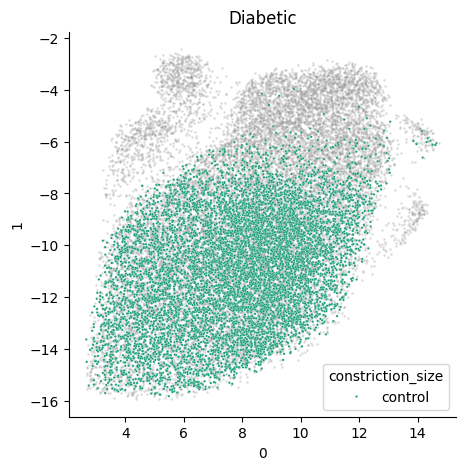

Healthy


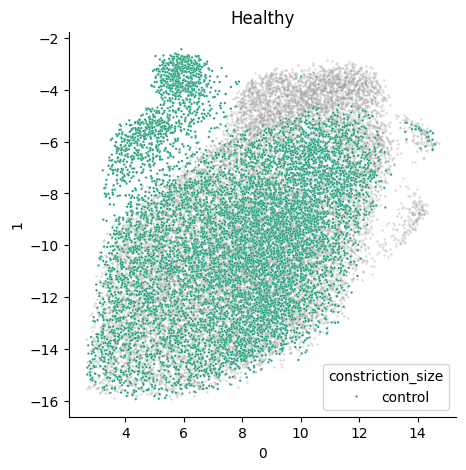

Prediabetic


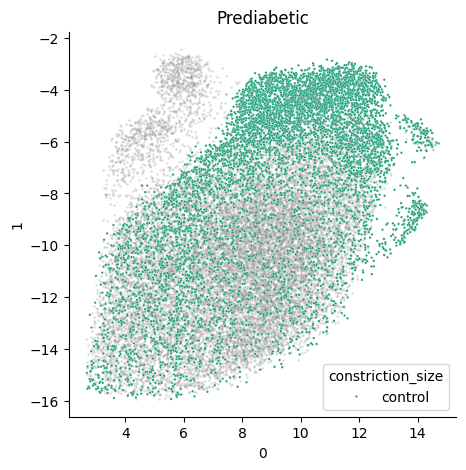

In [415]:
from sklearn.preprocessing import StandardScaler
import umap

reducer = umap.UMAP(random_state=250,n_neighbors=1000,min_dist=0.8)
# latent_list_df_lab_control=nmco_features_filtered_live_scaled_labelled[nmco_features_filtered_live_scaled_labelled['constriction_size']=='control']
# latent_list_df_control=nmco_features_filtered_live_scaled_labelled[nmco_features_filtered_live_scaled_labelled['constriction_size']=='control']
# latent_list_df_control = latent_list_df_control[latent_list_df_control['disease']!='Hypertension']
recon_list_control=[raw_images[i] for i in latent_list_df_control[latent_list_df_control['constriction_size']=='control'].index]
print(len(recon_list_control))

scaled_latent_list_df_lab_control = StandardScaler().fit_transform(latent_list_df_control.drop(columns=['patient_id','constriction_size','disease','disease_constric','patient_id_constric']))

embedding_control = reducer.fit_transform(scaled_latent_list_df_lab_control)
embedding_control.shape
embedding_control=pd.DataFrame(embedding_control)

embedding_control['patient_id']=latent_list_df_lab_control.reset_index()['patient_id']
embedding_control['constriction_size']=latent_list_df_lab_control.reset_index()['constriction_size']
embedding_control['disease']=latent_list_df_lab_control.reset_index()['disease']
embedding_control['disease_constric']=latent_list_df_lab_control.reset_index()['disease_constric']
embedding_control['patient_id_constric']=latent_list_df_lab_control.reset_index()['patient_id_constric']
embedding_control.index = latent_list_df_control.index
for disease in np.unique(embedding_control['disease']):
    print(disease)
    plt.figure(figsize=(5, 5))
    masking_condition=embedding_control['disease']==disease
    sns.scatterplot(data=embedding_control[~masking_condition],x=0,y=1,s=3,color="gray", alpha=0.3)
    sns.scatterplot(data=embedding_control[masking_condition],x=0,y=1,s=3,hue="constriction_size",palette="Dark2")
    sns.despine() 
    plt.title(disease)
    plt.show()



/tmp/ipykernel_3328293/1712939575.py:5: UserWarning: The palette list has more values (4) than needed (3), which may not be intended.
  sns.scatterplot(data=embedding_control,x=0,y=1,s=1,hue="disease",palette=control_palette)


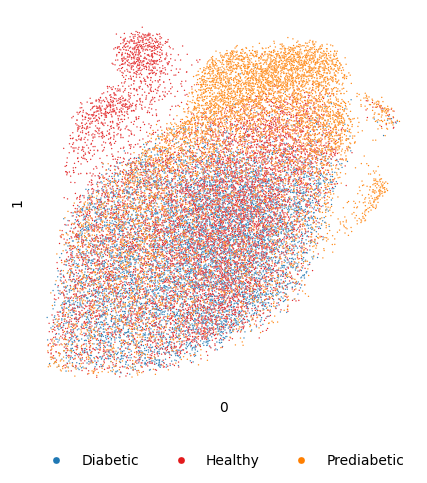

In [416]:
paired_palette = sns.color_palette("Paired", n_colors=8)
control_palette = [paired_palette[1],paired_palette[5],paired_palette[7],paired_palette[3]]

plt.figure(figsize=(5, 5))
sns.scatterplot(data=embedding_control,x=0,y=1,s=1,hue="disease",palette=control_palette)
plt.legend(
    loc='upper center',
    bbox_to_anchor=(0.5, -0.12),  # center horizontally, drop below axes
    ncol=4,                       # spread the handles in one row
    frameon=False,                # optional styling
    title='',                # optional label
    markerscale=5
)
sns.despine(left=True, bottom=True)
plt.xticks([], [])
plt.yticks([], [])
plt.show()

In [417]:
embedding_control

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric
6061,5.368384,-8.000443,64,control,Diabetic,Diabetic_control,64_control
6062,8.643051,-9.994743,80,control,Diabetic,Diabetic_control,80_control
6063,7.413150,-12.597803,46,control,Diabetic,Diabetic_control,46_control
6064,11.102054,-10.442940,46,control,Diabetic,Diabetic_control,46_control
6065,8.594180,-10.010990,35,control,Diabetic,Diabetic_control,35_control
...,...,...,...,...,...,...,...
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control
48023,12.282184,-5.279636,82,control,Prediabetic,Prediabetic_control,82_control
48024,10.279197,-3.860276,45,control,Prediabetic,Prediabetic_control,45_control
48025,11.060689,-3.773972,45,control,Prediabetic,Prediabetic_control,45_control


103


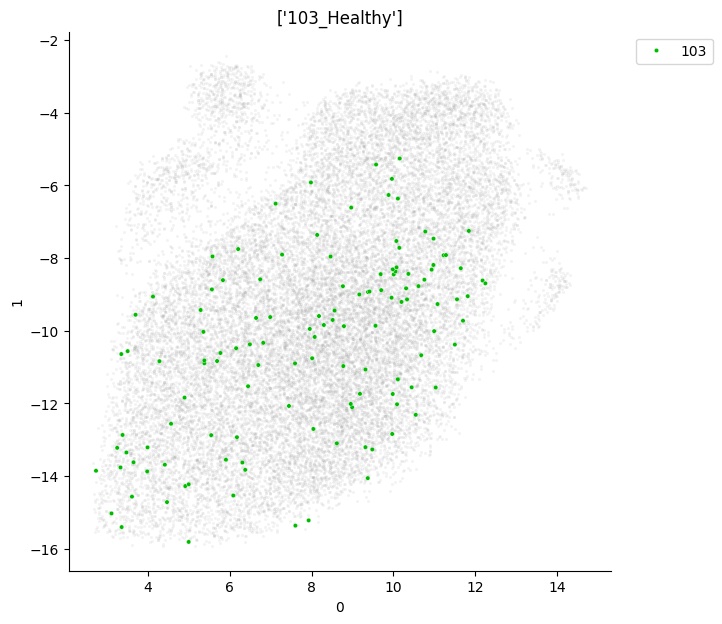

105


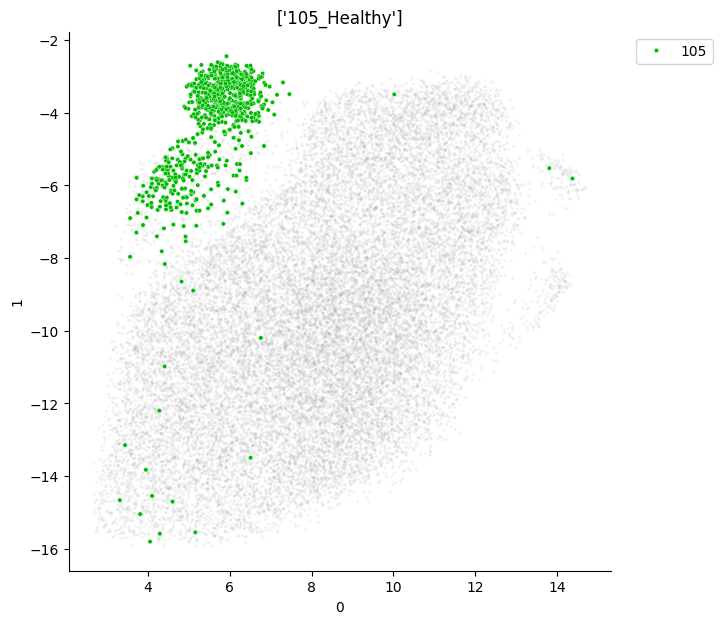

106


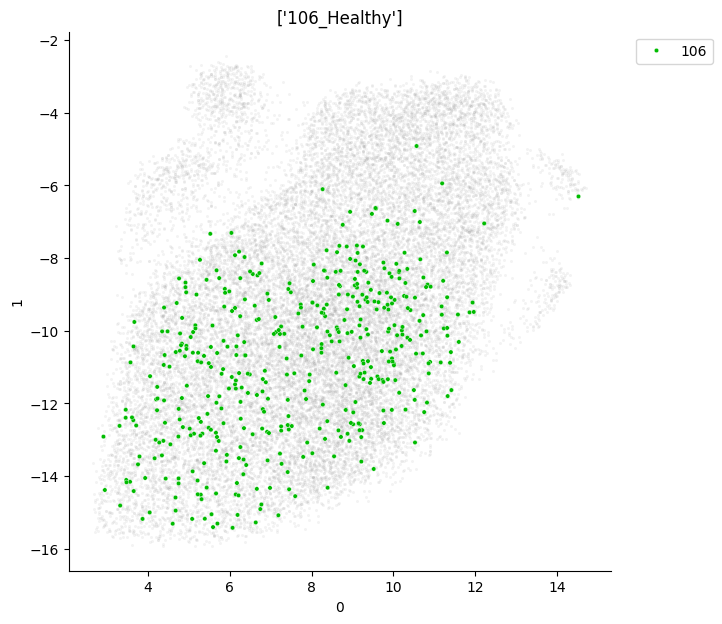

107


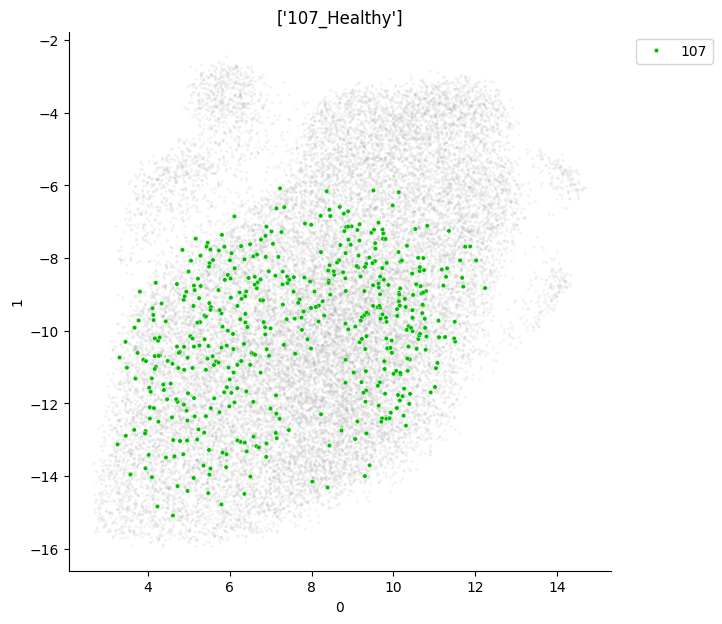

108


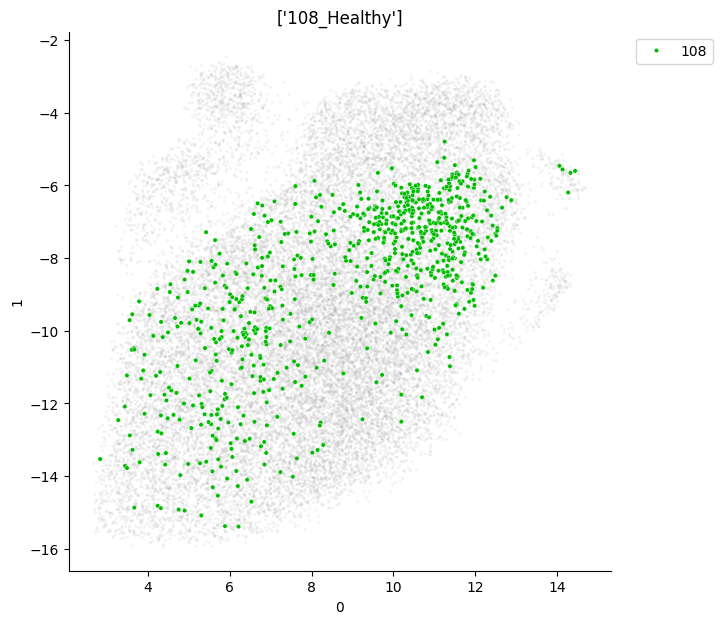

109


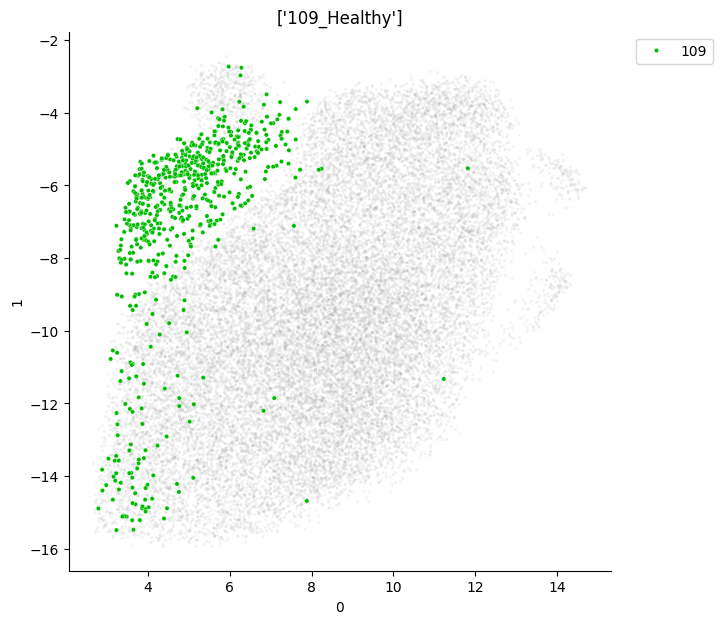

110


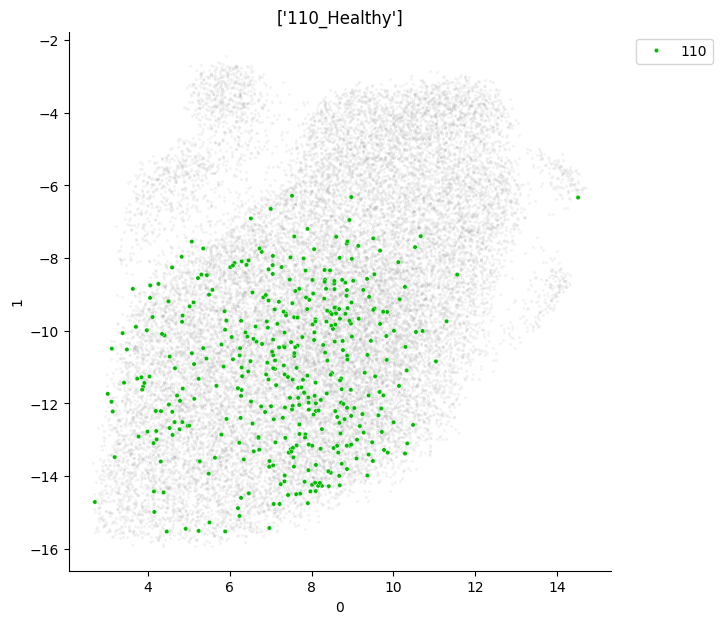

111


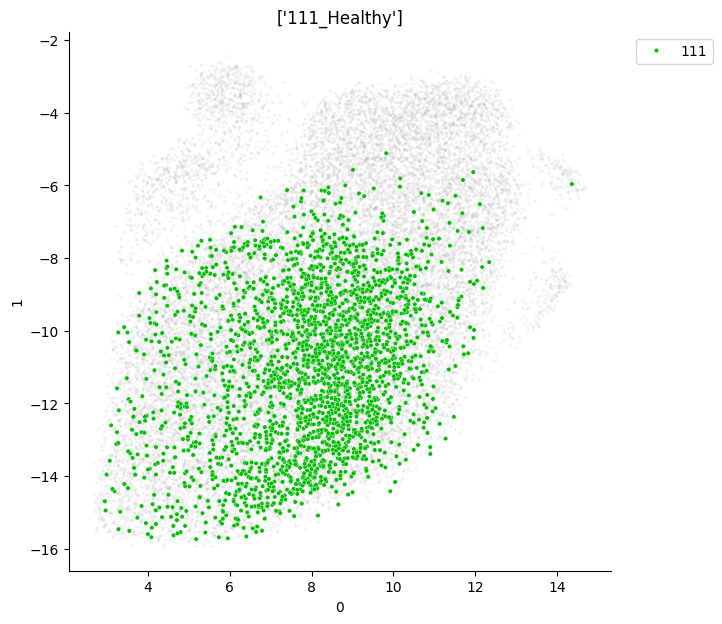

112


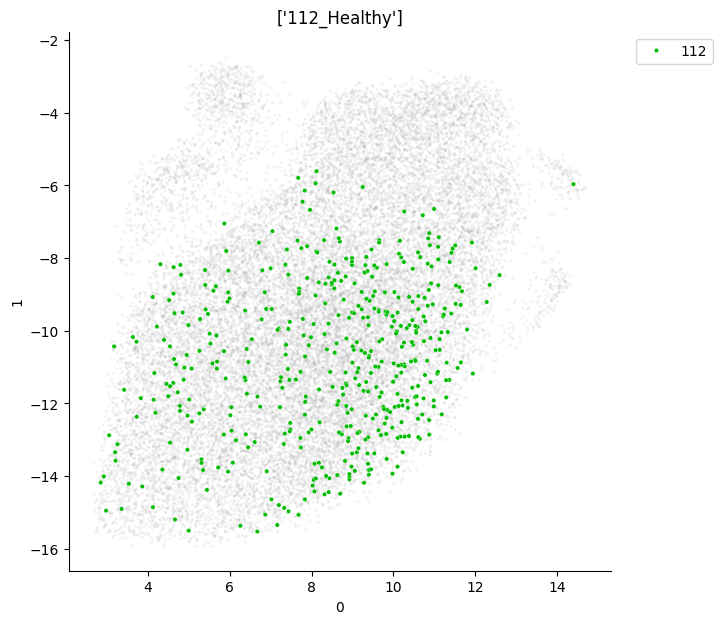

113


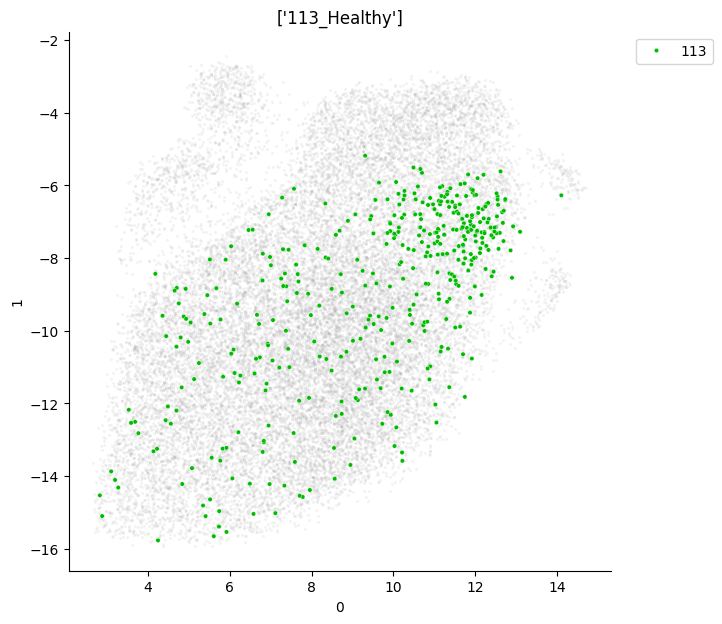

114


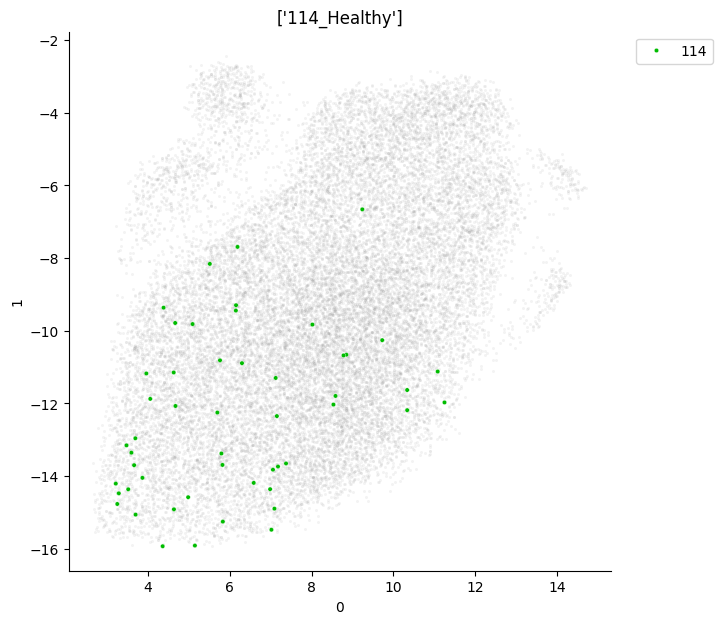

15


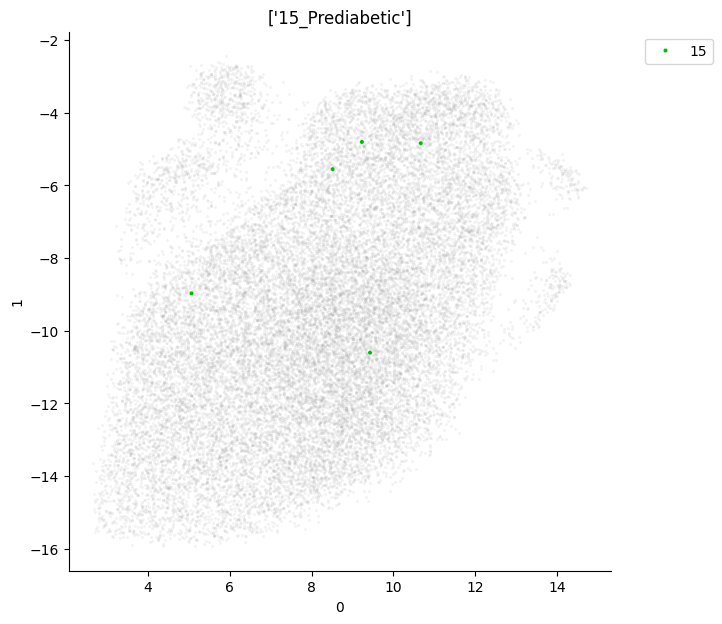

2


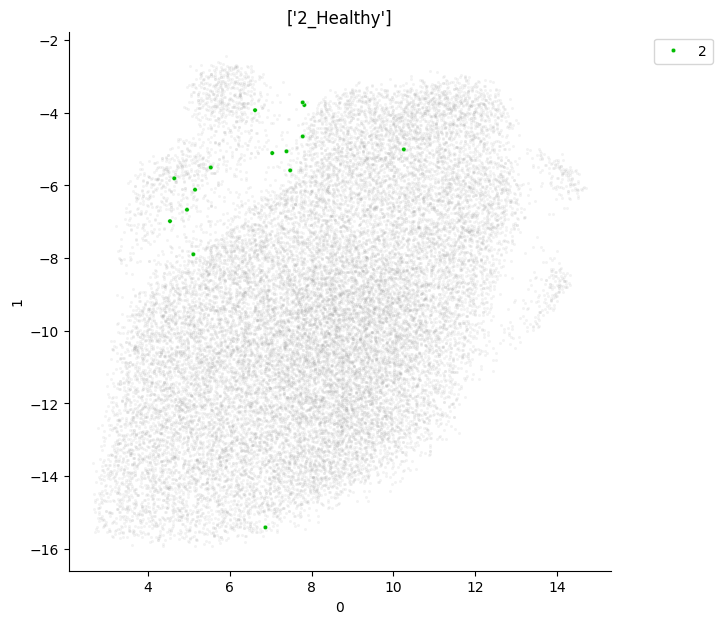

22


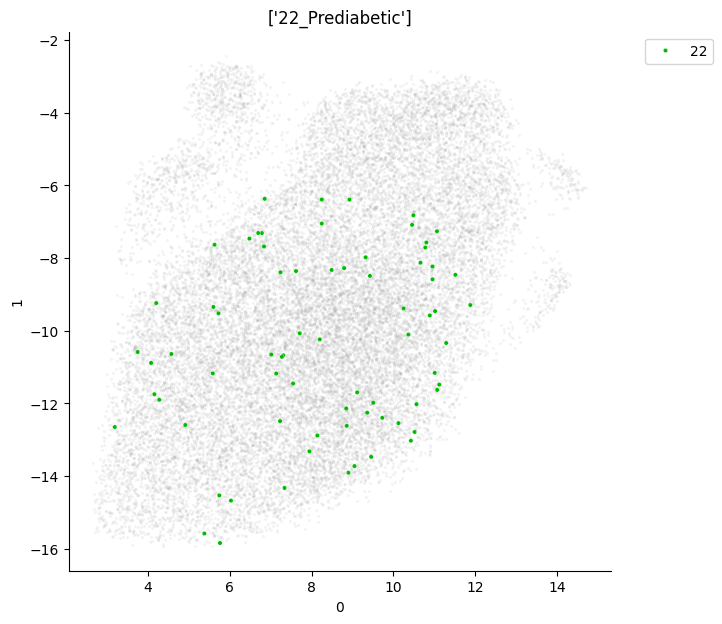

23


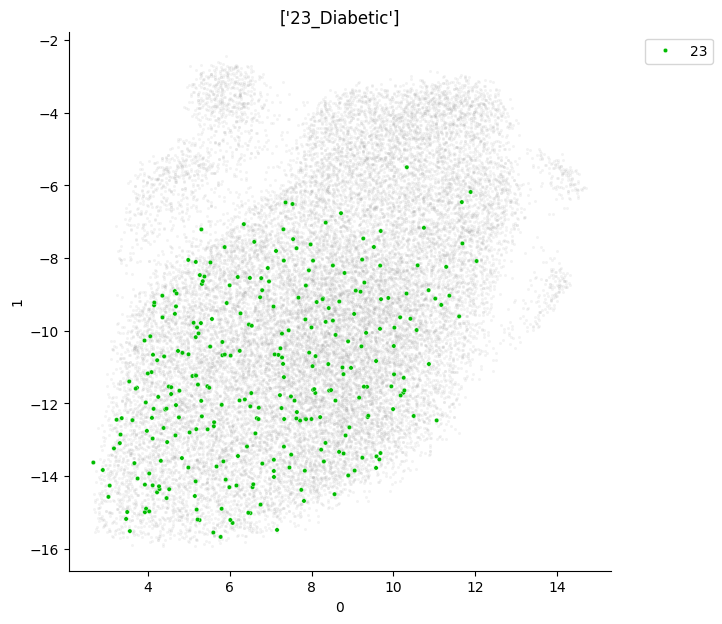

26


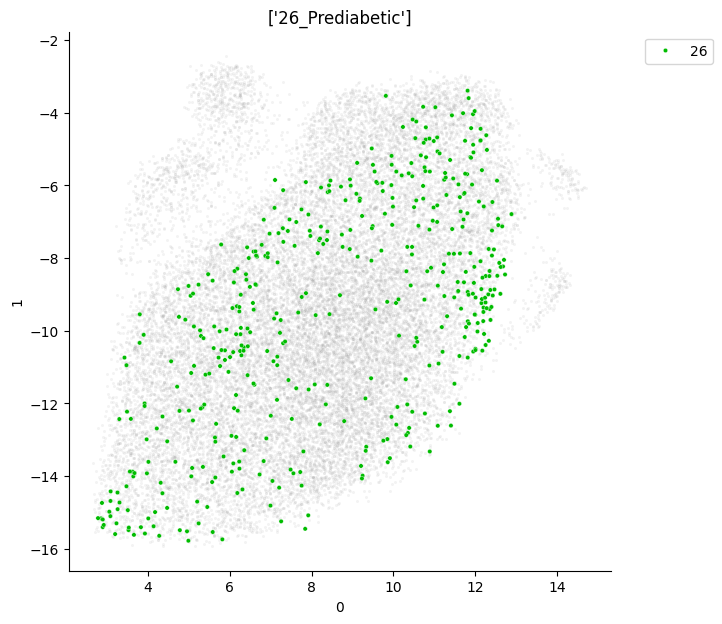

30


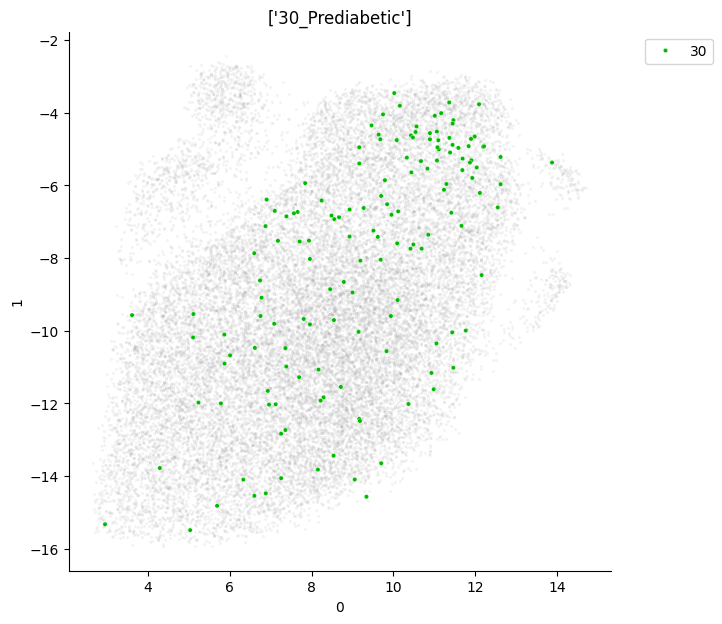

35


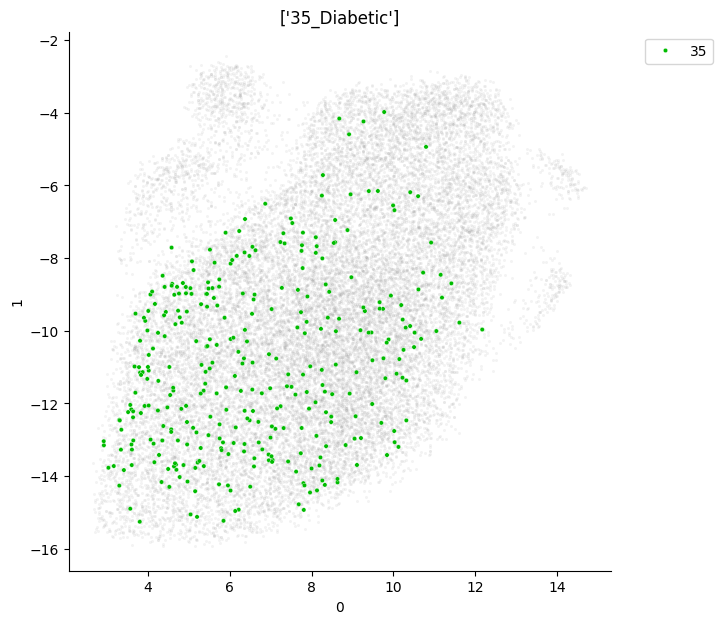

37


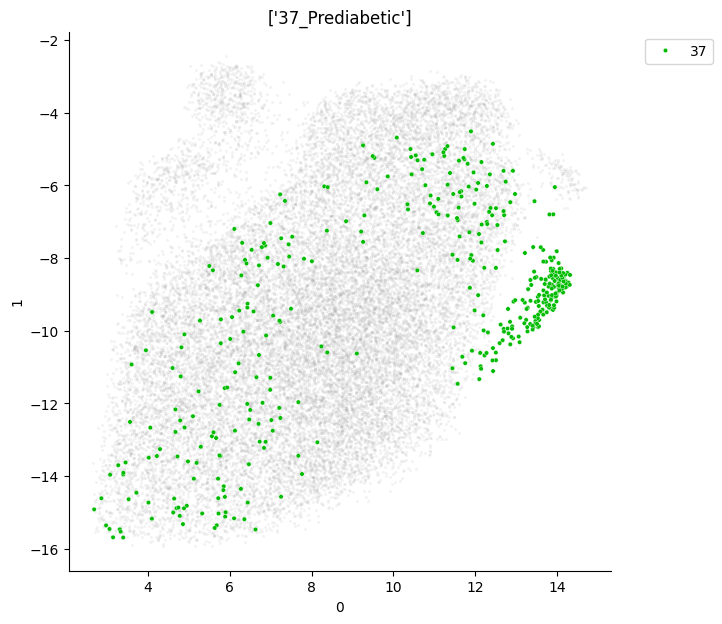

39


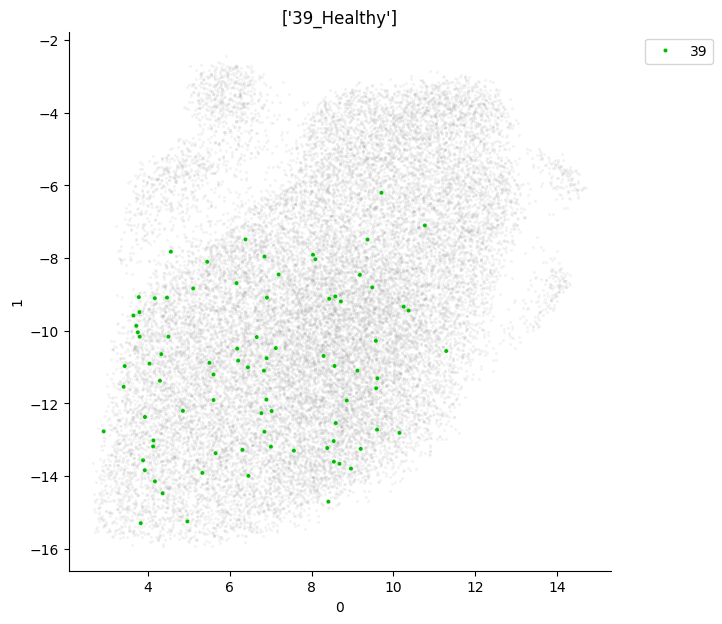

40


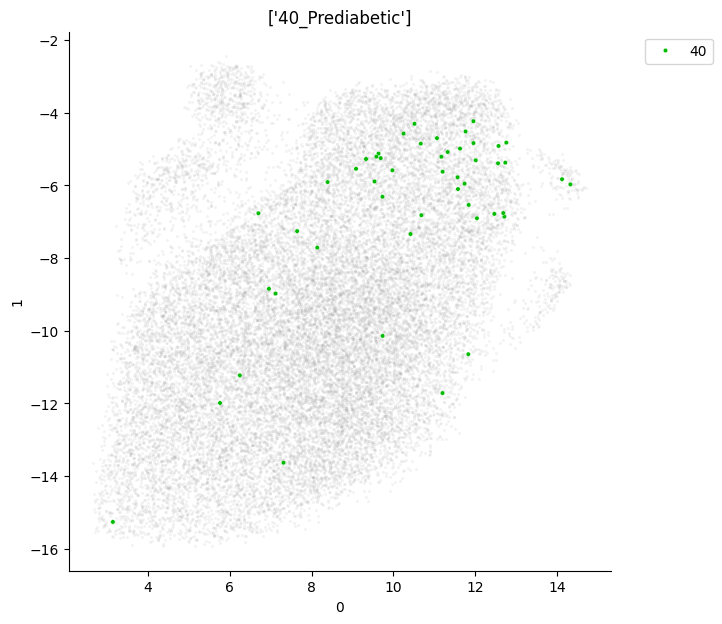

41


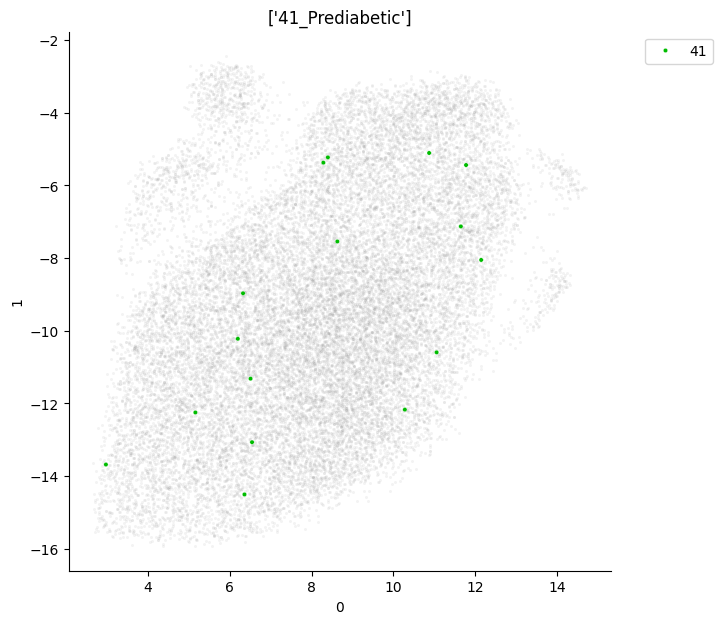

43


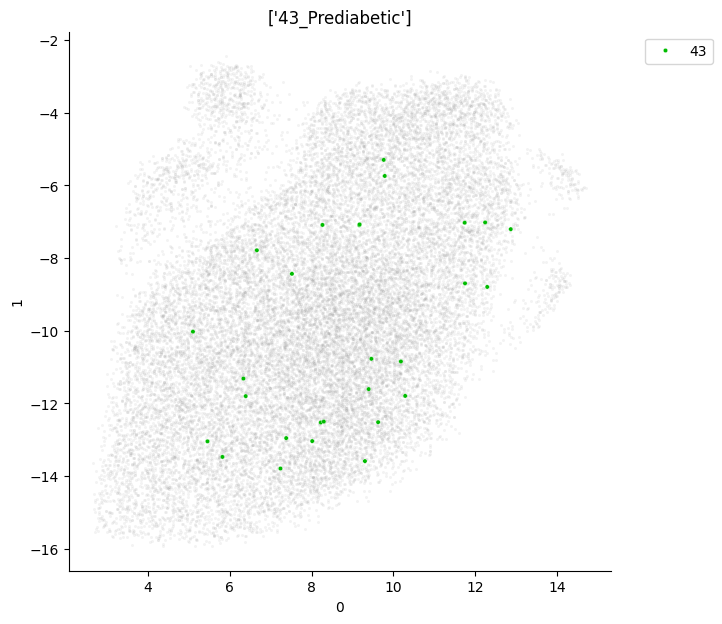

44


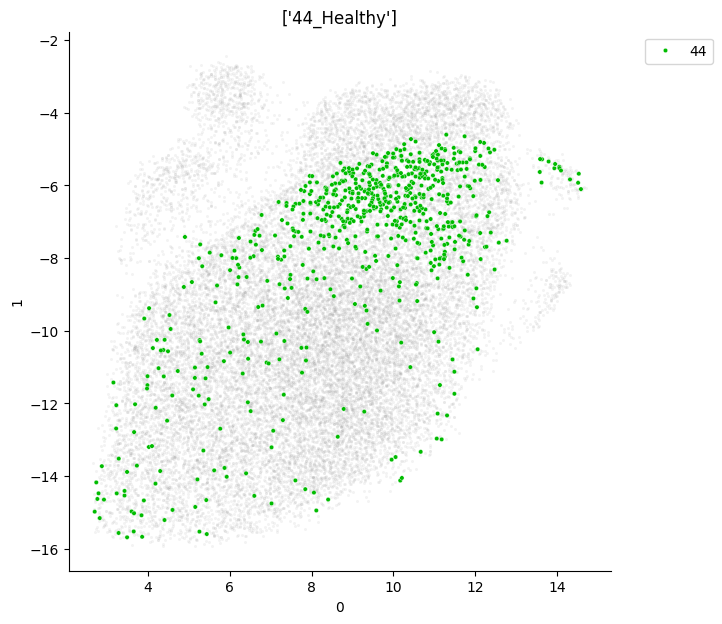

45


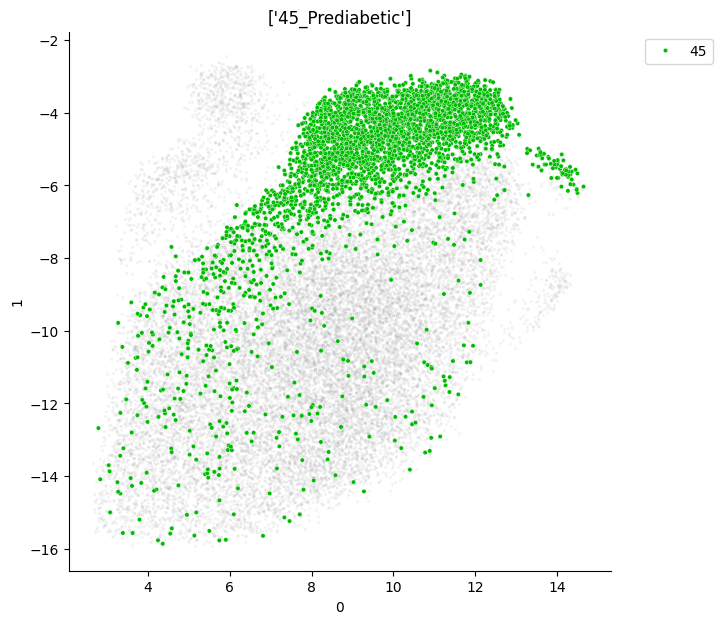

46


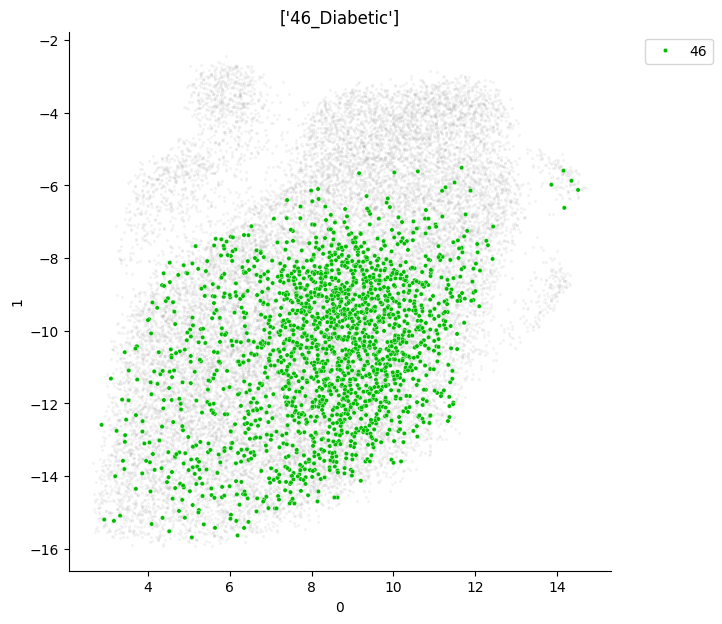

47


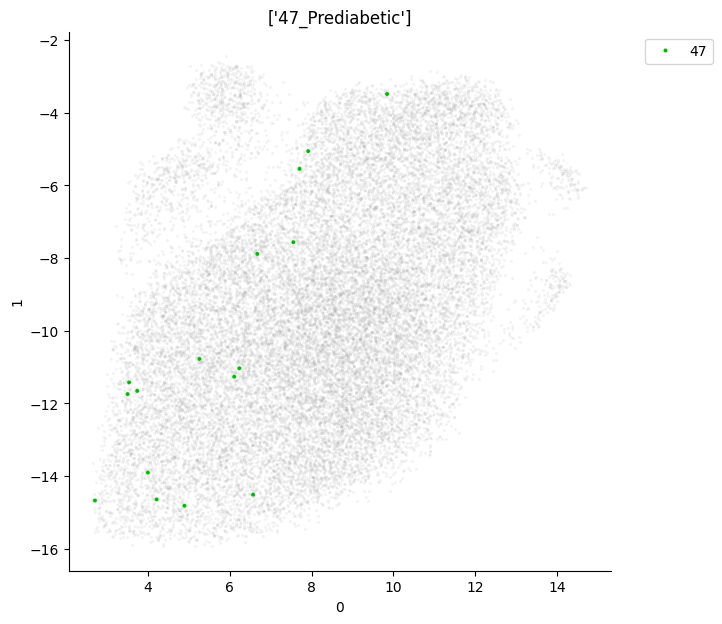

48


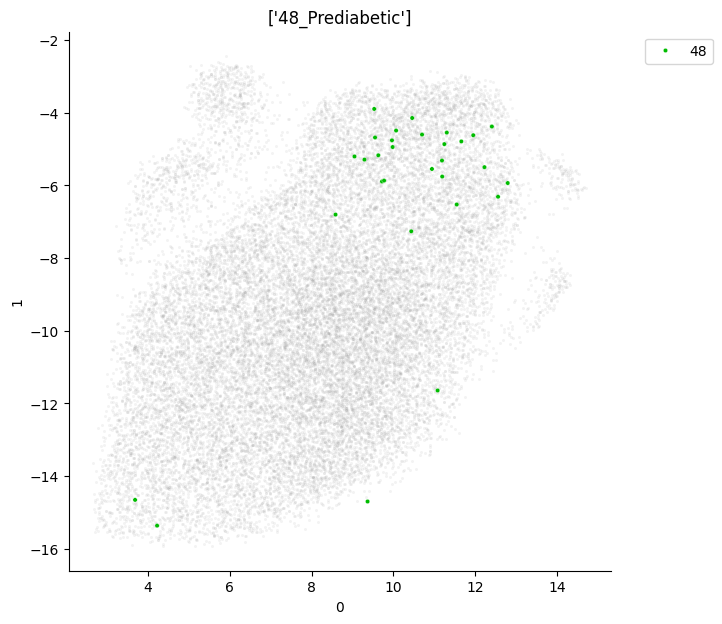

51


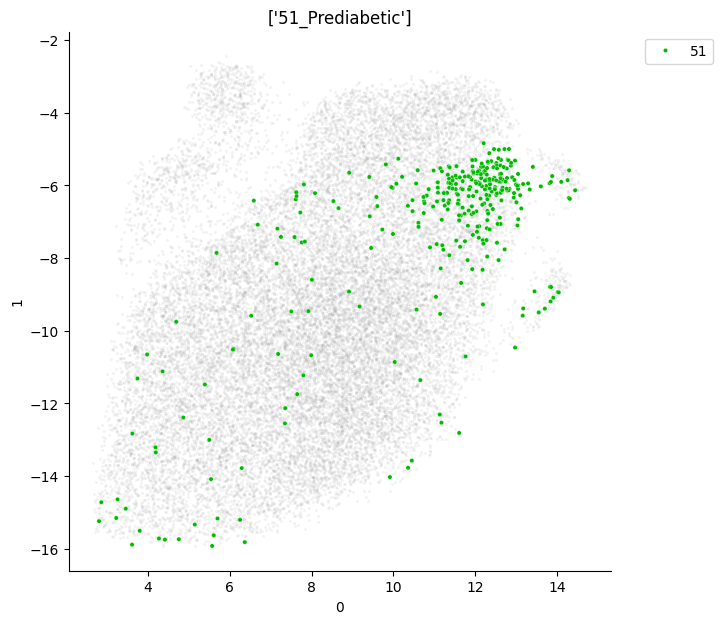

52


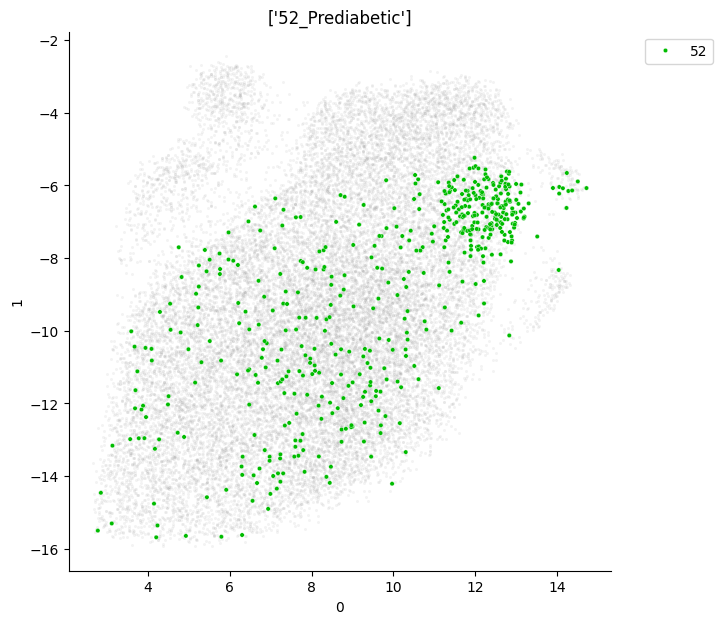

55


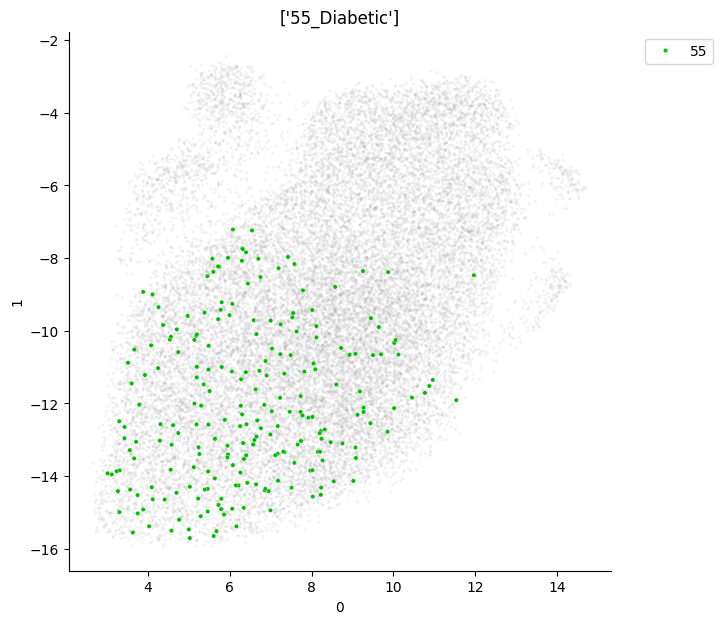

6


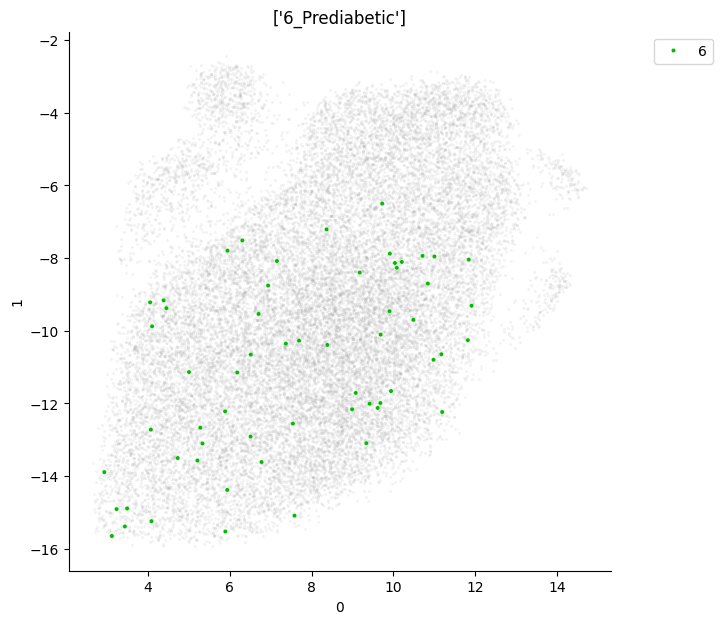

60


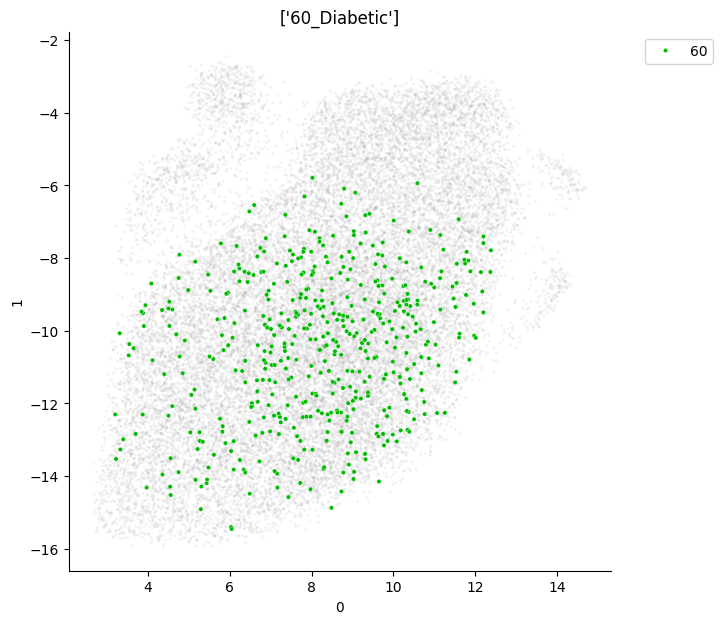

61


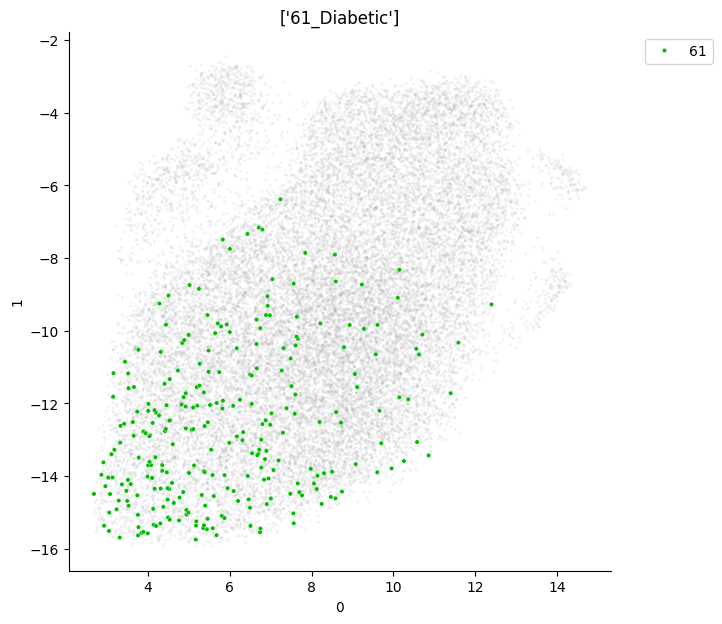

62


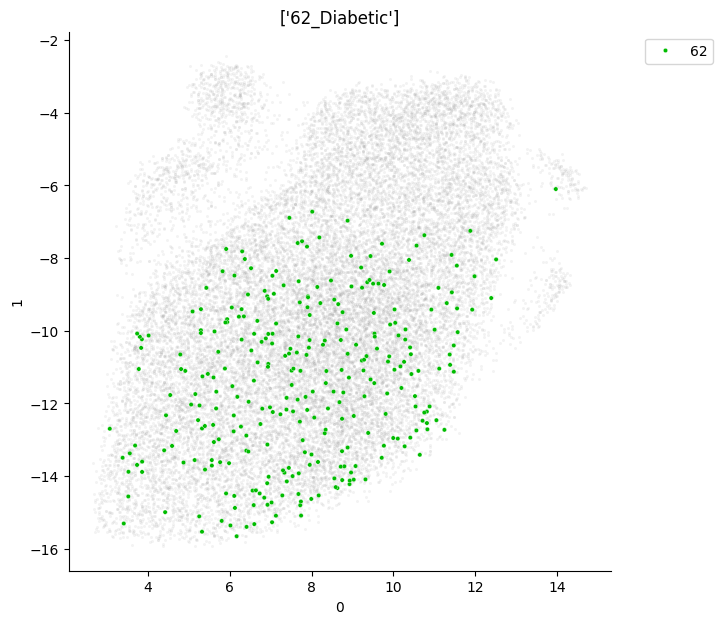

63


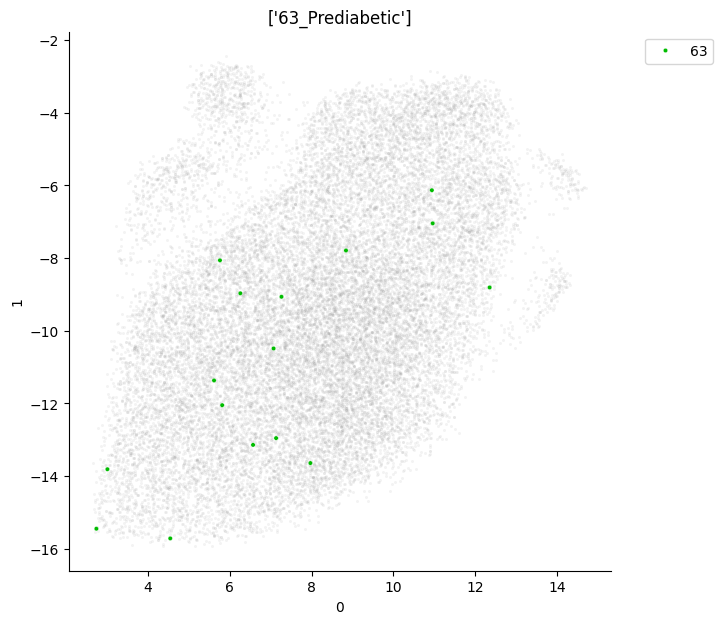

64


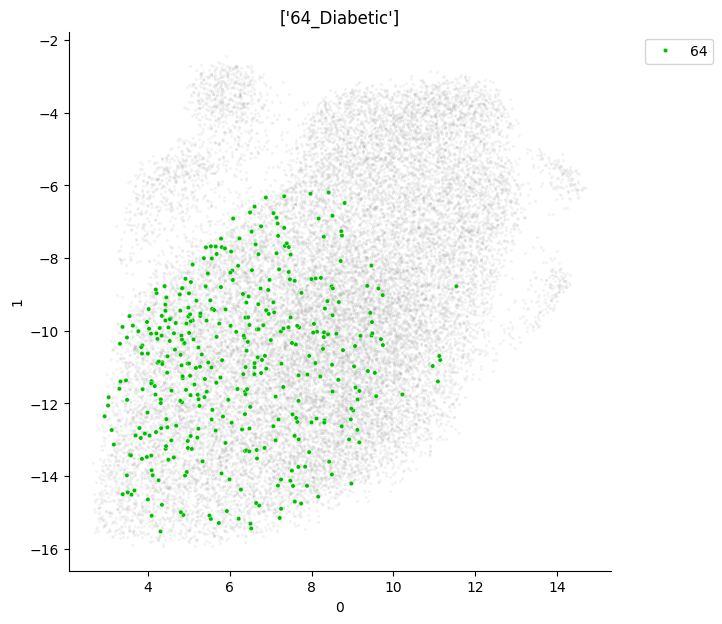

65


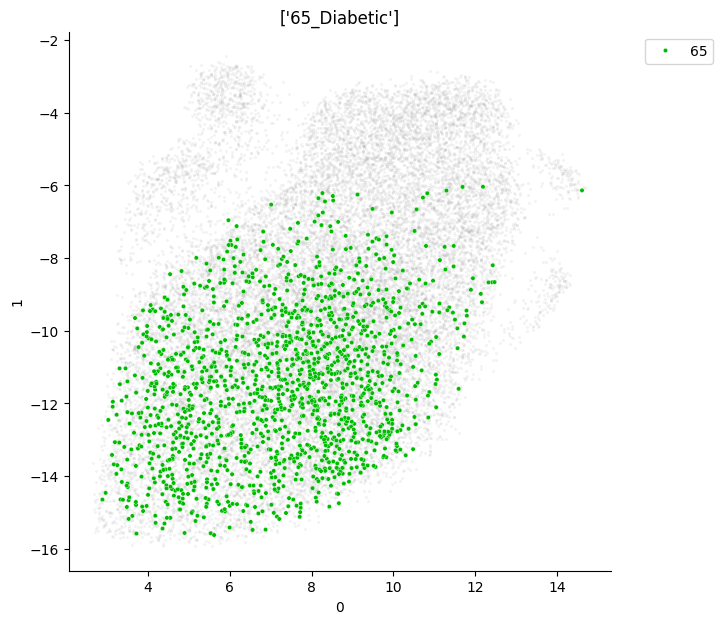

66


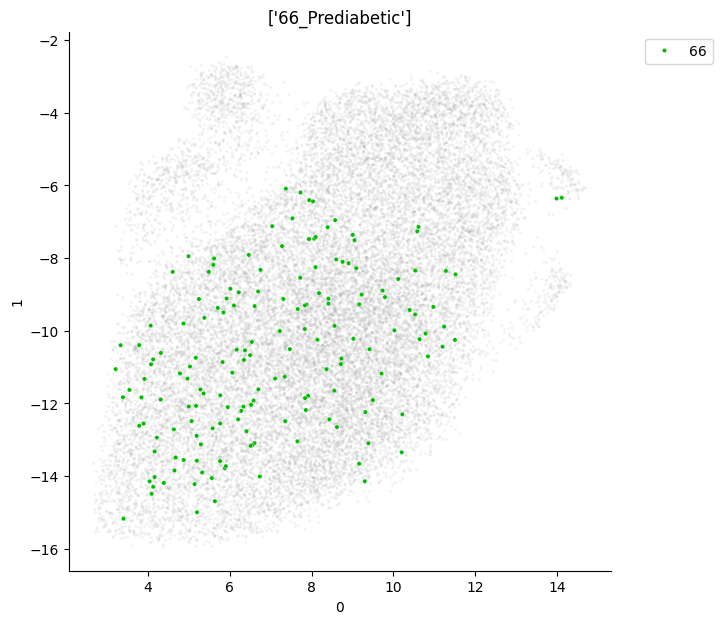

67


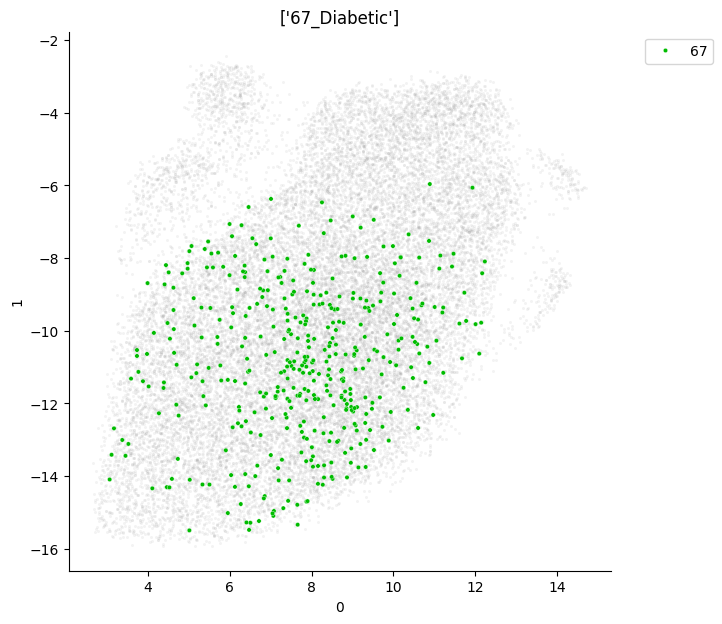

69


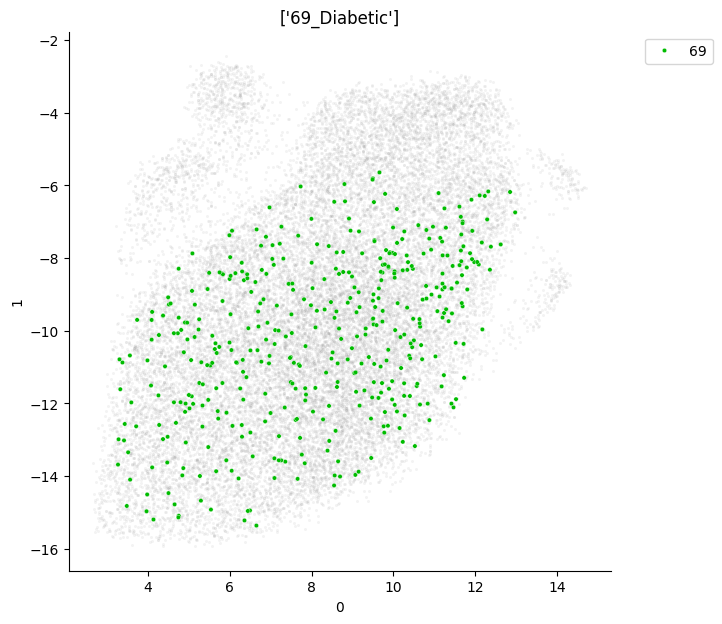

73


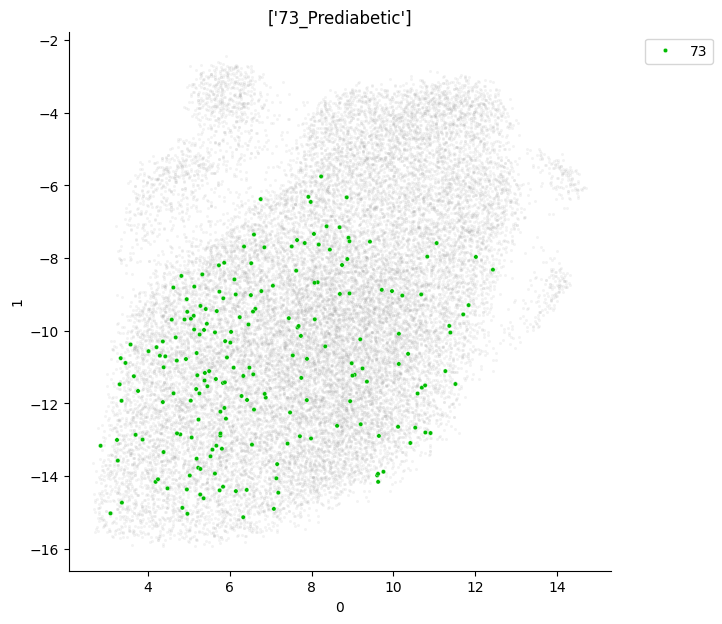

74


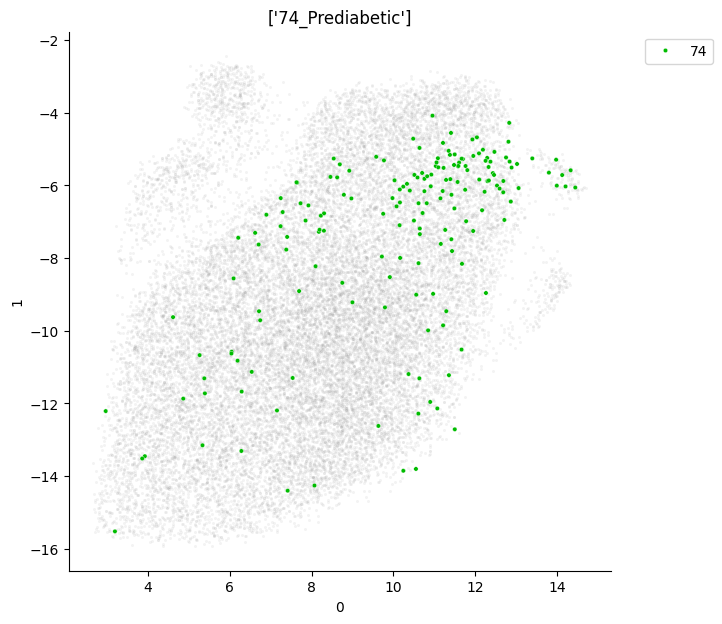

76


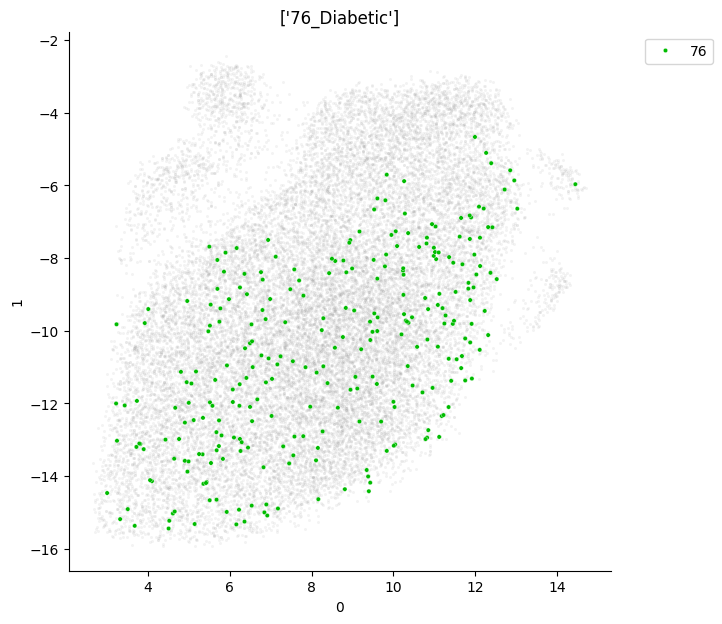

78


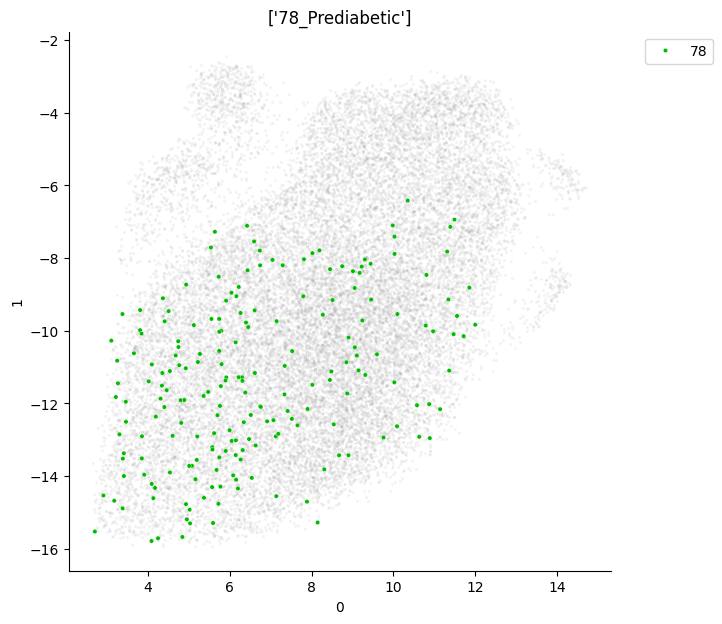

80


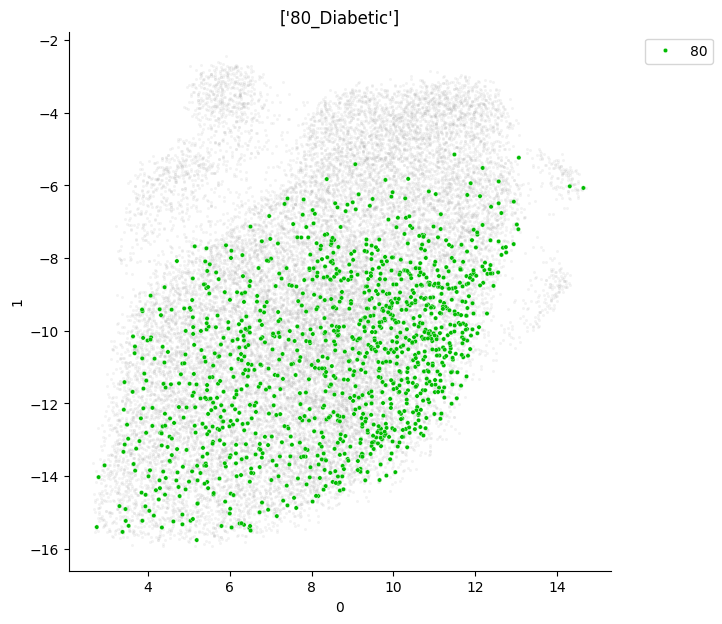

82


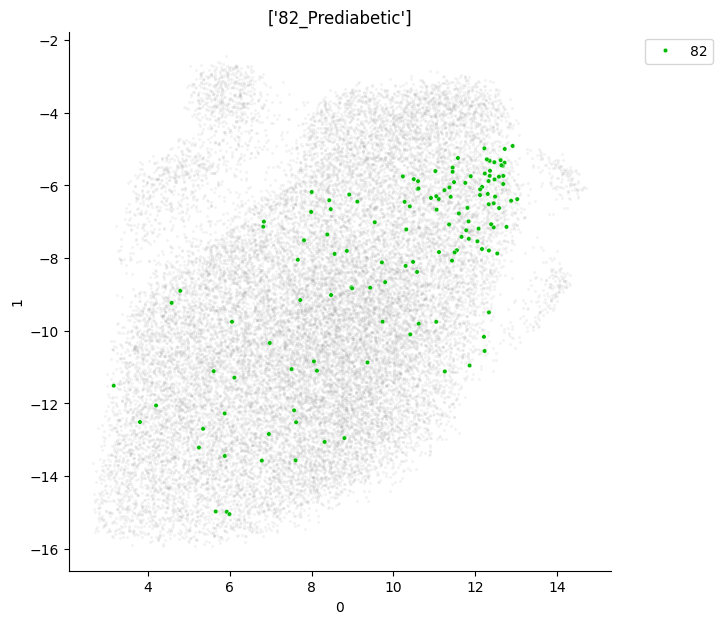

85


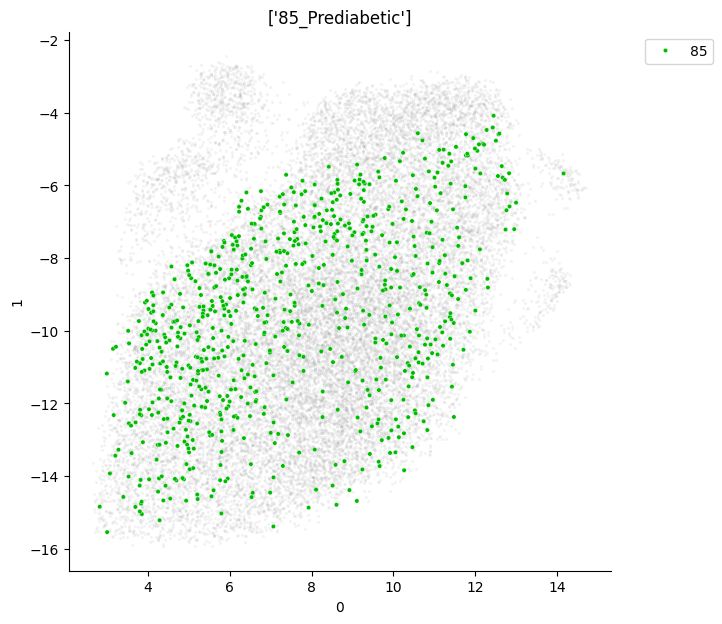

86


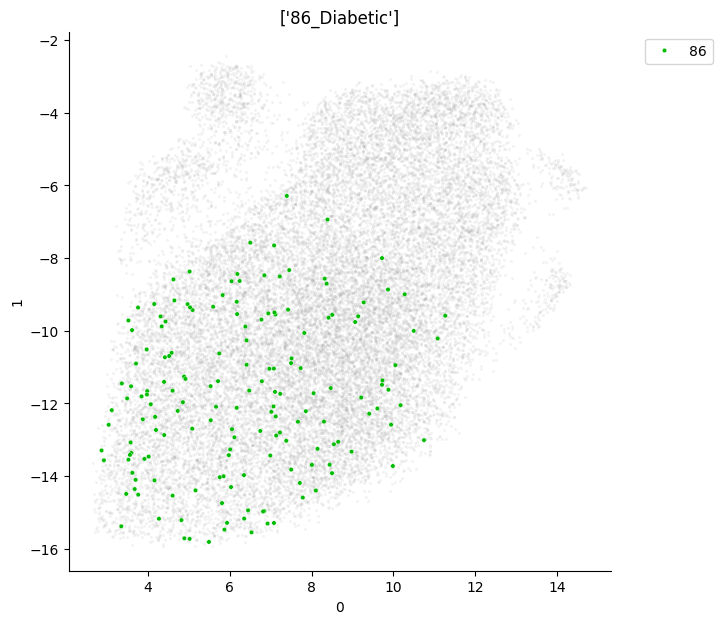

91


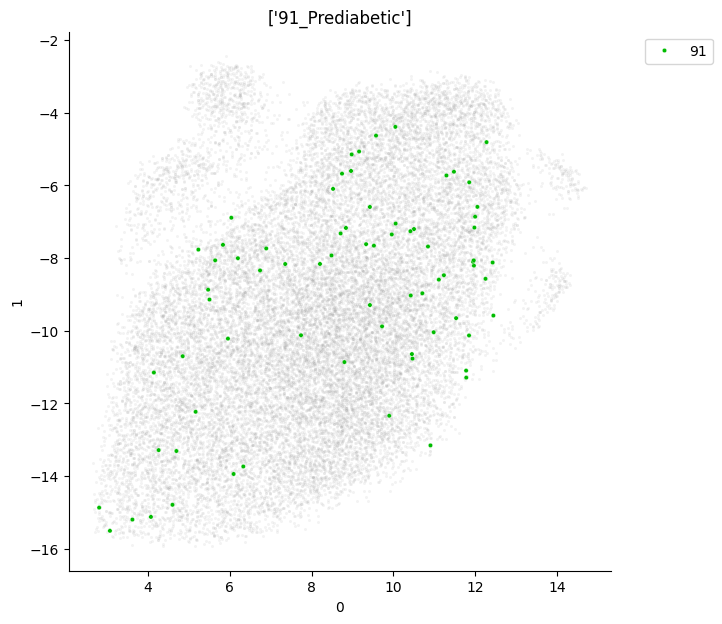

95


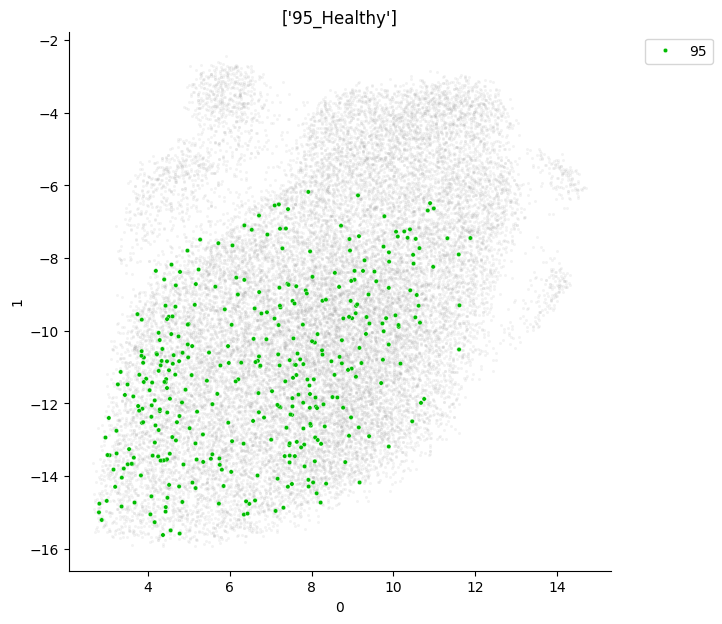

96


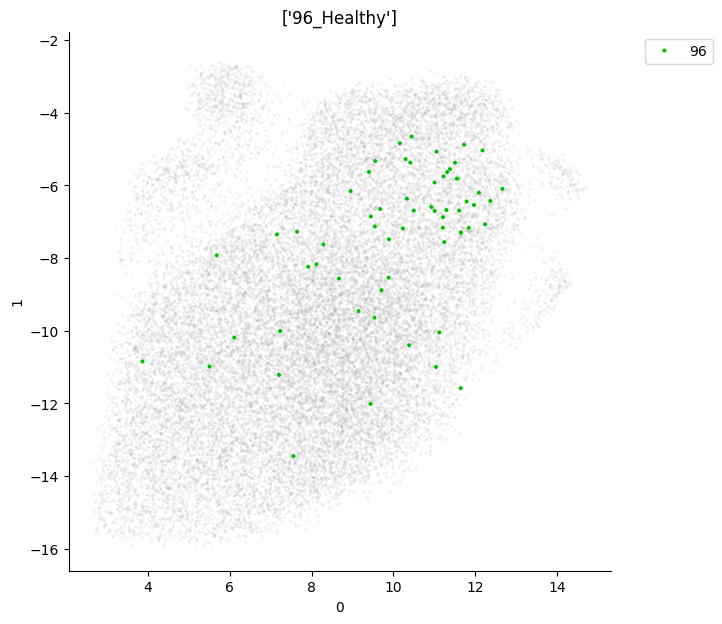

97


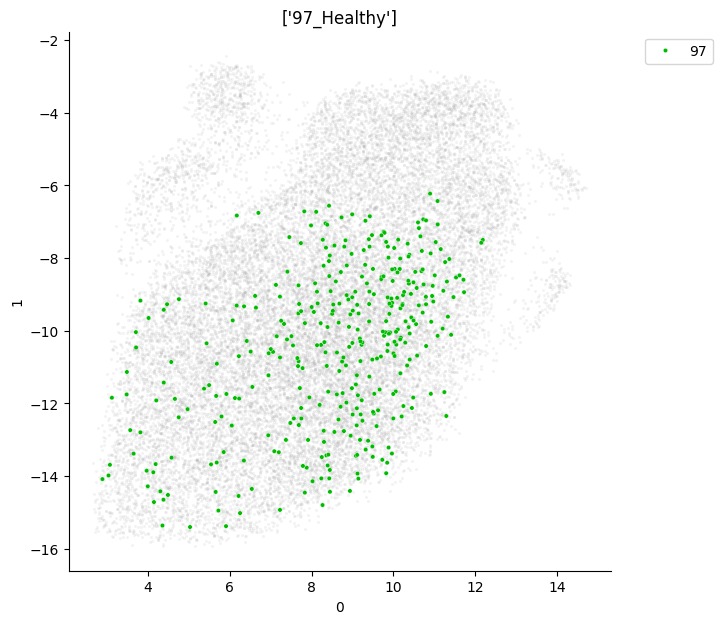

98


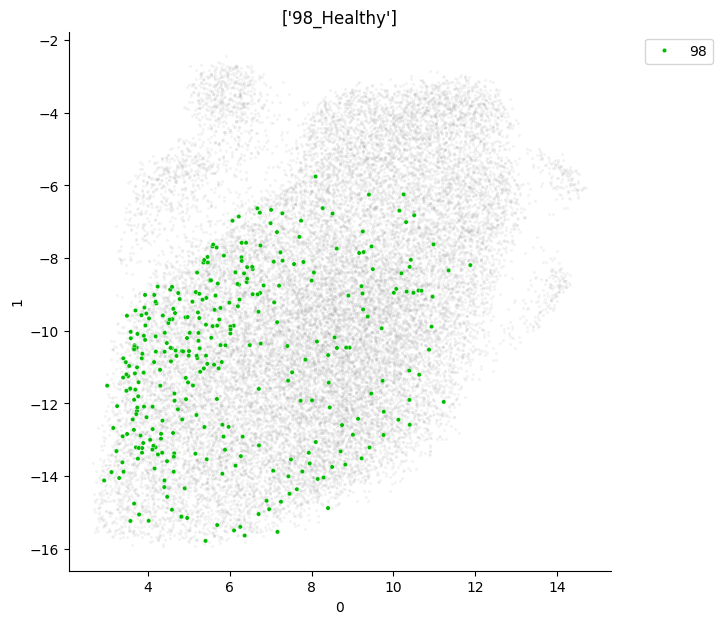

99


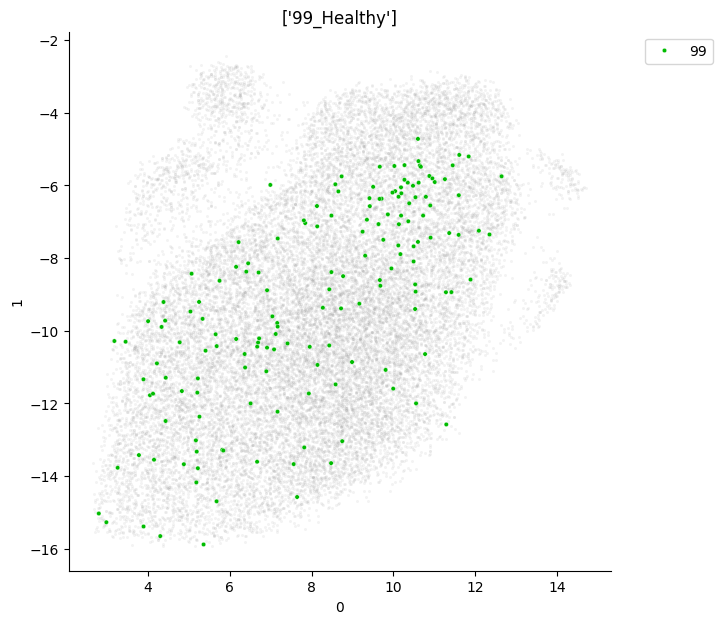

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric
6061,5.368384,-8.000443,64,control,Diabetic,Diabetic_control,64_control
6062,8.643051,-9.994743,80,control,Diabetic,Diabetic_control,80_control
6063,7.413150,-12.597803,46,control,Diabetic,Diabetic_control,46_control
6064,11.102054,-10.442940,46,control,Diabetic,Diabetic_control,46_control
6065,8.594180,-10.010990,35,control,Diabetic,Diabetic_control,35_control
...,...,...,...,...,...,...,...
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control
48023,12.282184,-5.279636,82,control,Prediabetic,Prediabetic_control,82_control
48024,10.279197,-3.860276,45,control,Prediabetic,Prediabetic_control,45_control
48025,11.060689,-3.773972,45,control,Prediabetic,Prediabetic_control,45_control


In [418]:
for disease in np.unique(embedding_control['patient_id']):
    print(disease)
    plt.figure(figsize=(7, 7))
    masking_condition=embedding_control['patient_id']==disease
    temp_df=embedding_control[embedding_control['patient_id']==disease]
    sns.scatterplot(data=embedding_control[~masking_condition],x=0,y=1,s=5,color="gray", alpha=0.09)
    sns.scatterplot(data=embedding_control[masking_condition].sample(frac=1).reset_index(drop=True),x=0,y=1,s=10,hue="patient_id",palette='nipy_spectral')
    sns.despine()
    plt.legend(loc='upper right',bbox_to_anchor=(1.2, 1)) 
    np.unique(temp_df['disease'])
    plt.title(disease+'_'+np.unique(temp_df['disease']))
#     plt.xlim(-2,2)
#     plt.ylim(-2,2)
    plt.show()

embedding_control


Diabetic


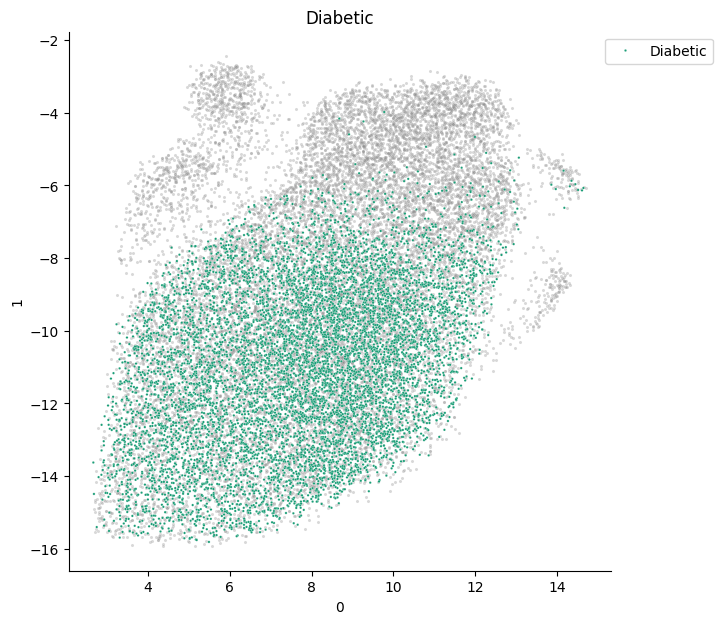

Healthy


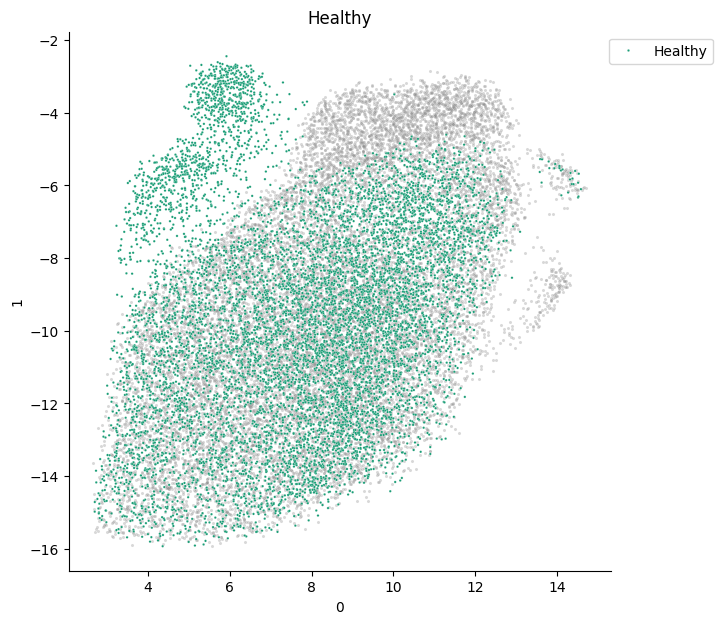

Prediabetic


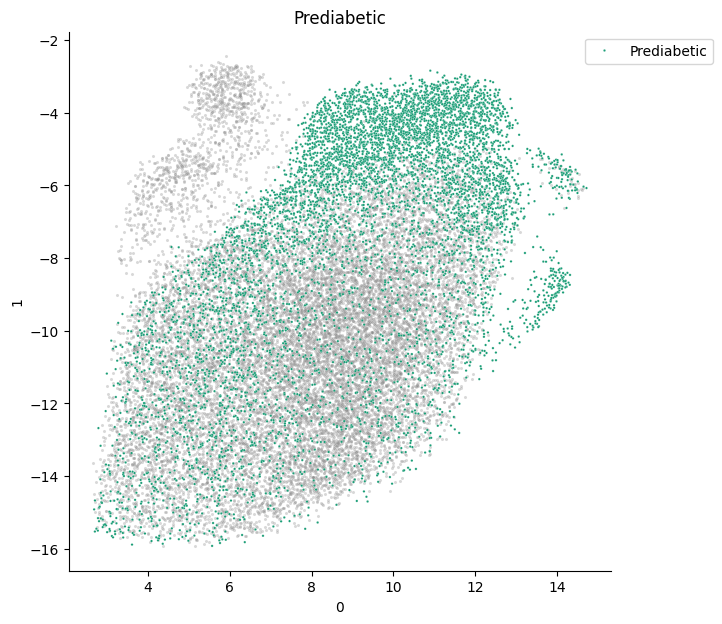

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric
6061,5.368384,-8.000443,64,control,Diabetic,Diabetic_control,64_control
6062,8.643051,-9.994743,80,control,Diabetic,Diabetic_control,80_control
6063,7.413150,-12.597803,46,control,Diabetic,Diabetic_control,46_control
6064,11.102054,-10.442940,46,control,Diabetic,Diabetic_control,46_control
6065,8.594180,-10.010990,35,control,Diabetic,Diabetic_control,35_control
...,...,...,...,...,...,...,...
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control
48023,12.282184,-5.279636,82,control,Prediabetic,Prediabetic_control,82_control
48024,10.279197,-3.860276,45,control,Prediabetic,Prediabetic_control,45_control
48025,11.060689,-3.773972,45,control,Prediabetic,Prediabetic_control,45_control


In [419]:

for disease in np.unique(embedding_control['disease']):
    print(disease)
    plt.figure(figsize=(7, 7))
    masking_condition=embedding_control['disease']==disease
    temp_df=embedding_control[embedding_control['disease']==disease]
    sns.scatterplot(data=embedding_control[~masking_condition],x=0,y=1,s=5,color="gray", alpha=0.3)
    sns.scatterplot(data=embedding_control[masking_condition].sample(frac=1).reset_index(drop=True),x=0,y=1,s=3,hue="disease",palette='Dark2')
    sns.despine()
    plt.legend(loc='upper right',bbox_to_anchor=(1.2, 1)) 
    np.unique(temp_df['disease'])
    plt.title(disease)
#     plt.xlim(-2,2)
#     plt.ylim(-2,2)
    plt.show()

embedding_control


In [420]:
def sample_algo(lists):
    
    balanced_list=[]   
    cell_count_mat=[]
    balanced_no=[]
    balanced_list_count=[]
    for a_list in lists:
        cell_count=sum(a_list)
        cell_count_mat.append(cell_count)
        balance=a_list-a_list.mean()
        balance[balance<0]=0
        balanced_list.append(a_list-balance)
        balanced_list_count.append(sum(a_list-balance))
        balanced_no.append(len(a_list))
        
    residue=(np.array(balanced_list_count)-min(np.array(balanced_list_count)))
    
    while max(residue)>5:
        final_balanced_list=[]
        final_balanced_list_count=[]
        new_residue=[]
        for a_residue,a_list in zip(residue,balanced_list):
            if a_residue>1:
                t=a_list.max()
                balance=a_list-t+1
                balance[balance<0]=0
                a_residue=a_residue-balance.sum()
                a_list=a_list-balance
                final_balanced_list.append(a_list)
                final_balanced_list_count.append((a_list).sum())
                new_residue.append(a_residue)
            else:
                new_residue.append(a_residue)
                final_balanced_list.append(a_list)
                final_balanced_list_count.append((a_list).sum())
        residue=np.array(new_residue)
        balanced_list=final_balanced_list
        
    return(balanced_list)

import numpy as np
import pandas as pd
import igraph as ig
import leidenalg
from sklearn.metrics import adjusted_rand_score
from scipy.cluster.hierarchy import linkage, fcluster
from scipy.spatial.distance import squareform
from sklearn.neighbors import NearestNeighbors

def consensus_leiden_dense(
    df,
    n_neighbors: int = 10,
    n_runs: int = 30,
    resolution: float = 1.0,
    seed0: int = 0,
    distance: str = "euclidean",
    threshold: float = 0.8,
):
    """
    Run consensus Leiden clustering on a dataframe of shape (cells, features).

    Parameters
    ----------
    df : pd.DataFrame
        Input data, rows=cells, cols=features.
    n_neighbors : int
        Number of neighbors for kNN graph.
    n_runs : int
        Number of Leiden runs with different seeds.
    resolution : float
        Resolution parameter for Leiden.
    seed0 : int
        Base random seed for reproducibility.
    distance : str
        Distance metric for sklearn NearestNeighbors.
    threshold : float
        Co-association threshold for consensus clustering.

    Returns
    -------
    labels_consensus : np.ndarray
        Final consensus cluster labels (string form).
    stability : dict
        Mean and std ARI of runs vs consensus, plus metadata.
    all_labels : np.ndarray
        Labels from all runs (n_runs × n_cells).
    """

    X = df#.values.astype(np.float32)
    n_cells = X.shape[0]

    # --- Build kNN graph once ---
    nbrs = NearestNeighbors(n_neighbors=n_neighbors, metric=distance).fit(X)
    knn = nbrs.kneighbors_graph(X, mode="connectivity")

    sources, targets = knn.nonzero()
    g = ig.Graph(directed=False)
    g.add_vertices(n_cells)
    g.add_edges(list(zip(sources, targets)))

    # --- Multiple Leiden runs ---
    labels_runs = np.zeros((n_runs, n_cells), dtype=int)
    for r in range(n_runs):
        part = leidenalg.find_partition(
            g,
            leidenalg.RBConfigurationVertexPartition,
            resolution_parameter=resolution,
            seed=seed0 + r,
        )
        labels_runs[r] = np.array(part.membership)

    # --- Build co-association matrix ---
    P = np.zeros((n_cells, n_cells), dtype=np.float32)
    for r in range(n_runs):
        labs = labels_runs[r]
        for c in np.unique(labs):
            idx = np.where(labs == c)[0]
            P[np.ix_(idx, idx)] += 1.0
    P /= n_runs

    # --- Hierarchical consensus ---
    D = 1.0 - P
    Dv = squareform(D, checks=False)
    Z = linkage(Dv, method="average")
    flat = fcluster(Z, t=1-threshold, criterion="distance")
    labels_consensus = flat.astype(str)

    # --- Stability diagnostics ---
    aris = [adjusted_rand_score(labels_runs[r], flat) for r in range(n_runs)]
    stability = {
        "mean_ARI_to_consensus": float(np.mean(aris)),
        "std_ARI_to_consensus": float(np.std(aris)),
        "n_runs": n_runs,
        "resolution": resolution,
        "threshold": threshold,
        "n_neighbors": n_neighbors,
    }

    return labels_consensus, stability, labels_runs


In [592]:
import igraph as ig
import leidenalg as la
from sklearn.neighbors import kneighbors_graph


### Skipping balancing and importing the same cell from VAE sampled dataset 

vae_leiden_csv = pd.read_csv('vae_leiden_csv', index_col = 0)
vae_leiden_csv


# latent_list_df_lab_control=nmco_features_filtered_live_scaled_labelled[nmco_features_filtered_live_scaled_labelled['constriction_size']=='control']
# latent_list_df_lab_control = latent_list_df_lab_control[latent_list_df_lab_control['disease'] != 'Hypertension']
# each_patho_cell_count=[]
# each_patho_individual_count=[]
# each_pat_id_count=[]
# for a_disease in np.unique(latent_list_df_lab_control['disease']):
#     disease_subset=latent_list_df_lab_control[latent_list_df_lab_control['disease']==a_disease]
#     each_patho_cell_count.append(len(disease_subset))
#     individual_count=len(np.unique(disease_subset['patient_id']))
#     each_patho_individual_count.append(individual_count)
#     each_pat_id_cells=disease_subset.groupby('patient_id').count()
#     each_pat_id_count.append(each_pat_id_cells['min_calliper'])
    
# each_pat_id_count_mod=[each_pat_id_count[0],each_pat_id_count[1],each_pat_id_count[2]]
# balanced_list=sample_algo(each_pat_id_count_mod)
# balanced_list=pd.concat(balanced_list)

# balanced_list

# sampling_matrix=pd.DataFrame({'patient_id':balanced_list.index,'sampling':balanced_list.values.astype(int)})

# latent_list_df_lab_control['balanced_sample']=0
# sampled_df_list=[]

# for pat_id in np.unique(latent_list_df_lab_control['patient_id']): 
#     to_be_sampled=latent_list_df_lab_control[latent_list_df_lab_control['patient_id']==pat_id]
#     sample_size=sampling_matrix.sampling[sampling_matrix['patient_id']==pat_id]

#     if sample_size.values:
#         sample_size=int(sample_size.values)
#         sampled_df=to_be_sampled.sample(sample_size,ignore_index=False,random_state=14)
#         sampled_index=list(sampled_df.index.values)
#         latent_list_df_lab_control.loc[sampled_index,'balanced_sample']=1
        

latent_list_df_lab_control['balanced_sample'] = vae_leiden_csv['balanced_sample']

latent_list_df_lab_control_concensus_with_vae = latent_list_df_lab_control.copy()
latent_list_df_lab_control_concensus_with_vae['leiden_vae'] = vae_leiden_csv['label_leiden']

latent_list_df_lab_control_ulab=latent_list_df_lab_control.drop(['patient_id','constriction_size','disease','disease_constric','patient_id_constric'],axis=1)
latent_list_df_lab_control_ulab

for_clusters=latent_list_df_lab_control_ulab[latent_list_df_lab_control['balanced_sample']==1]

#latent_list_df_control=latent_list_df_control.drop(to_remove_array,axis=0)

recon_list_control=[raw_images[i] for i in latent_list_df_lab_control[latent_list_df_lab_control['constriction_size']=='control'].index]




In [593]:
vae_leiden_csv
latent_list_df_lab_control_concensus_with_vae
for_clusters

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,balanced_sample,label_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,1,5.0
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,1,9.0
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,1,7.0
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,1,4.0
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,1,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,1,13.0
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,1,13.0
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,1,12.0
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1,1.0


In [594]:
latent_list_df_lab_control_concensus_with_vae

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden,leiden_vae
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0,C5
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0,C1
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN


In [595]:
latent_list_df_lab_control_concensus_with_vae

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden,leiden_vae
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0,C5
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0,C1
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN


In [596]:
latent_list_df_lab_control#['disease'].unique()

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnumnode,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.142857,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.158730,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.142857,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.126984,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.031746,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.079365,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.095238,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.063492,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.063492,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN


In [597]:
latent_list_df_lab_control_ulab

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,balanced_sample,label_leiden
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.676804,0.629527,0.479339,0.651022,0.743527,0.142857,0.165407,0.304826,0,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.627690,0.611504,0.540219,0.527042,0.800072,0.158730,0.101735,0.196701,0,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.603380,0.455751,0.253771,0.688759,0.685258,0.142857,0.151178,0.199145,0,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.591410,0.495511,0.295543,0.704466,0.675757,0.126984,0.094365,0.172877,0,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.580533,0.635797,0.200112,0.422014,0.667123,0.031746,0.413369,0.170434,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1,1.0
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.623623,0.611504,0.035256,0.529316,0.796419,0.095238,0.112836,0.059255,1,11.0
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.481998,0.466405,0.202909,0.410048,0.588933,0.063492,0.163286,0.082468,0,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.472909,0.460621,0.214936,0.398888,0.581724,0.063492,0.118691,0.083690,0,NaN


In [598]:
for_clusters

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,balanced_sample,label_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,1,5.0
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,1,9.0
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,1,7.0
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,1,4.0
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,1,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,1,13.0
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,1,13.0
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,1,12.0
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1,1.0


In [599]:
latent_list_df_lab_control_ulab_bal=latent_list_df_lab_control_ulab[latent_list_df_lab_control_ulab['balanced_sample']==1]
latent_list_df_lab_control_ulab_bal=latent_list_df_lab_control_ulab_bal.drop(['balanced_sample'],axis=1)
for_clusters=latent_list_df_lab_control_ulab_bal
stability_list=[]

k = 5
knn_graph = kneighbors_graph(for_clusters, n_neighbors=k, include_self=False)
sources, targets = knn_graph.nonzero()
weights = knn_graph.data

g = ig.Graph(directed=False)
g.add_vertices(for_clusters.shape[0])
g.add_edges(zip(sources, targets))
g.es['weight'] = weights

# Perform Leiden clustering
partition = la.find_partition(g, la.ModularityVertexPartition, seed=42)

# Get cluster membership
clusters = pd.Series(partition.membership,for_clusters.index)
clusters

6070      5
6072      9
6076      6
6078      4
6079      2
         ..
48016    13
48017    13
48019    12
48022     1
48023    11
Length: 9936, dtype: int64

In [600]:
embedding_control

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric
6061,5.368384,-8.000443,64,control,Diabetic,Diabetic_control,64_control
6062,8.643051,-9.994743,80,control,Diabetic,Diabetic_control,80_control
6063,7.413150,-12.597803,46,control,Diabetic,Diabetic_control,46_control
6064,11.102054,-10.442940,46,control,Diabetic,Diabetic_control,46_control
6065,8.594180,-10.010990,35,control,Diabetic,Diabetic_control,35_control
...,...,...,...,...,...,...,...
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control
48023,12.282184,-5.279636,82,control,Prediabetic,Prediabetic_control,82_control
48024,10.279197,-3.860276,45,control,Prediabetic,Prediabetic_control,45_control
48025,11.060689,-3.773972,45,control,Prediabetic,Prediabetic_control,45_control


In [601]:
for_clusters

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmax,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,label_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.386675,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,5.0
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.638629,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,9.0
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.474673,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,7.0
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.386675,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,4.0
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.638629,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.386675,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,13.0
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.386675,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,13.0
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.386675,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,12.0
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.386675,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1.0


In [602]:
for_clusters_clustered = for_clusters.copy()
# latent_list_df_lab_control['label_leiden']
for_clusters_clustered['labels_leiden'] = clusters
for_clusters_clustered

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,label_leiden,labels_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,5.0,5
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,9.0,9
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,7.0,6
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,4.0,4
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,2.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,13.0,13
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,13.0,13
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,12.0,12
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1.0,1


In [603]:
latent_list_df_lab_control_ulab_bal

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmax,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,label_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.386675,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,5.0
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.638629,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,9.0
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.474673,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,7.0
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.386675,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,4.0
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.638629,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.386675,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,13.0
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.386675,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,13.0
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.386675,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,12.0
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.386675,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1.0


In [604]:
for_clusters_clustered
latent_list_df_lab_control_ulab_bal['labels_leiden'] = for_clusters_clustered['labels_leiden']
latent_list_df_lab_control_ulab_bal['labels_leiden'] = latent_list_df_lab_control_ulab_bal['labels_leiden'].fillna('uc')

In [605]:
latent_list_df_lab_control['label_leiden'] = latent_list_df_lab_control_ulab_bal['labels_leiden']
latent_list_df_lab_control

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnumnode,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.142857,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.158730,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.142857,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.126984,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.031746,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.079365,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.095238,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.063492,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.063492,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN


In [606]:
latent_list_df_lab_control_concensus_with_vae['leiden_nmco'] = latent_list_df_lab_control['label_leiden']
latent_list_df_lab_control_concensus_with_vae

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden,leiden_vae,leiden_nmco
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN,NaN,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN,NaN,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN,NaN,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0,C5,1.0
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0,C1,11.0
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN,NaN,NaN


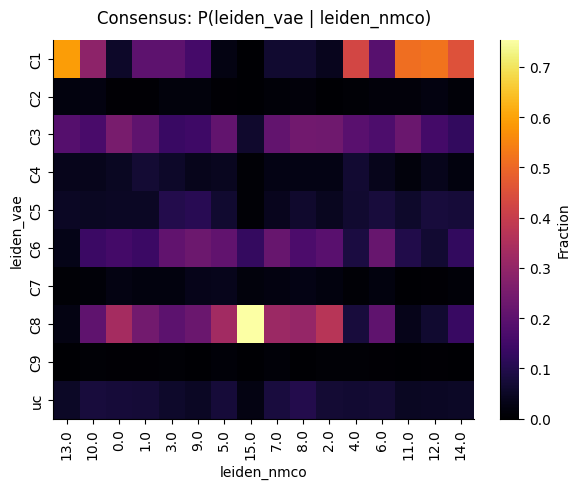

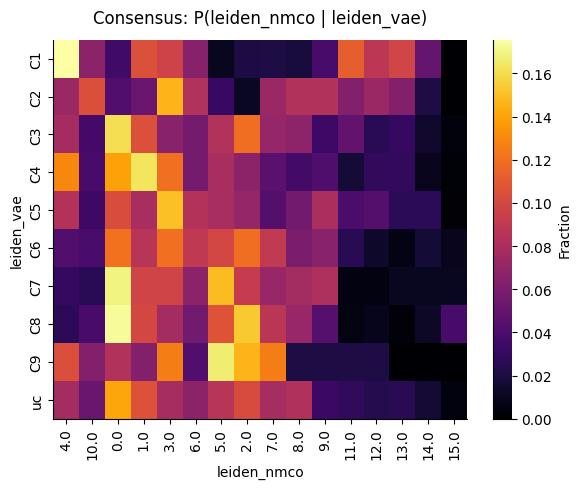

In [607]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.optimize import linear_sum_assignment

latent_list_df_lab_control_concensus_with_vae_just_bal = latent_list_df_lab_control_concensus_with_vae[latent_list_df_lab_control_concensus_with_vae['balanced_sample'] == 1]
def consensus_matrix(df, a_col, b_col, direction="A_to_B"):
    """
    Build a contingency and a fraction (consensus) matrix between two clustering label columns.
    direction:
      - "A_to_B": rows=A clusters, cols=B clusters, values = P(B | A) (row-normalized)
      - "B_to_A": rows=A clusters, cols=B clusters, values = P(A | B) (column-normalized in the same layout)
    Returns: counts_df, frac_df
    """
    counts = pd.crosstab(df[a_col], df[b_col], dropna=False)

    if direction == "A_to_B":
        frac = counts.div(counts.sum(axis=1).replace(0, np.nan), axis=0).fillna(0.0)
        frac.attrs["title"] = f"Consensus: P({b_col} | {a_col})"
    elif direction == "B_to_A":
        # same layout (rows=A, cols=B) but normalize columns so each column sums to 1
        frac = counts.div(counts.sum(axis=0).replace(0, np.nan), axis=1).fillna(0.0)
        frac.attrs["title"] = f"Consensus: P({a_col} | {b_col})"
    else:
        raise ValueError('direction must be "A_to_B" or "B_to_A"')

    return counts, frac
def _hungarian_reorder(frac_df: pd.DataFrame):
    """
    Reorder rows/cols to maximize diagonal using Hungarian algorithm.
    Returns: reordered_df, row_order, col_order, mapping (row_label -> col_label)
    """
    M = frac_df.to_numpy(copy=True)
    r, c = M.shape
    size = max(r, c)

    # pad to square with zeros
    Msq = np.zeros((size, size), dtype=float)
    Msq[:r, :c] = M

    # maximize diagonal => minimize negative
    row_ind, col_ind = linear_sum_assignment(-Msq)

    # build mapping for real indices only
    mapping = {}
    for ri, ci in zip(row_ind, col_ind):
        if ri < r and ci < c:
            mapping[frac_df.index[ri]] = frac_df.columns[ci]

    # row order: keep as-is or sort by mapped column index
    row_order = list(frac_df.index)  # keep your A clusters order
    # column order: use the matched columns (in row order), then append any unused columns
    matched_cols = [mapping[row] for row in row_order if row in mapping]
    unused_cols = [col for col in frac_df.columns if col not in matched_cols]
    col_order = matched_cols + unused_cols

    return frac_df.loc[row_order, col_order], row_order, col_order, mapping

def plot_consensus_heatmap(df, a_col, b_col,
                           direction="A_to_B",
                           reorder="hungarian",  # "hungarian" or None
                           annotate=True, cmap="inferno",
                           figsize=(6,5)):
    """
    Plot the consensus heatmap. Returns (counts_df, frac_df, mapping).
    """
    counts, frac = consensus_matrix(df, a_col, b_col, direction=direction)

    if reorder == "hungarian":
        frac, row_order, col_order, mapping = _hungarian_reorder(frac)
    else:
        row_order, col_order, mapping = list(frac.index), list(frac.columns), {}

    plt.figure(figsize=figsize)
    ax = sns.heatmap(frac.loc[row_order, col_order],
                     vmin=0, vmax=np.max(frac), cmap=cmap,
                     annot=annotate, fmt=".2f",
                     cbar_kws={"label": "Fraction"})
    ax.set_xlabel(b_col)
    ax.set_ylabel(a_col)
    ax.set_title(frac.attrs.get("title", "Consensus matrix"), pad=12)
    sns.despine()
    plt.tight_layout()
    plt.show()

    return counts.loc[row_order, col_order], frac.loc[row_order, col_order], mapping

counts_ab, frac_ab, map_ab = plot_consensus_heatmap(
    latent_list_df_lab_control_concensus_with_vae_just_bal, a_col="leiden_vae", b_col="leiden_nmco",
    direction="B_to_A", reorder="hungarian", annotate=False
)
counts_ab, frac_ab, map_ab = plot_consensus_heatmap(
    latent_list_df_lab_control_concensus_with_vae_just_bal, a_col="leiden_vae", b_col="leiden_nmco",
    direction="A_to_B", reorder="hungarian", annotate=False
)


In [610]:
latent_list_df_lab_control_concensus_with_vae_just_bal

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden,leiden_vae,leiden_nmco
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.174710,35,control,Diabetic,Diabetic_control,35_control,1,5.0,C8,5.0
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.087355,46,control,Diabetic,Diabetic_control,46_control,1,9.0,C5,9.0
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.156995,67,control,Diabetic,Diabetic_control,67_control,1,7.0,C6,6.0
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.180208,35,control,Diabetic,Diabetic_control,35_control,1,4.0,uc,4.0
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.267563,62,control,Diabetic,Diabetic_control,62_control,1,2.0,C3,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.303604,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0,C7,13.0
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.083690,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0,C1,13.0
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.103849,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0,C1,12.0
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0,C5,1.0


/tmp/ipykernel_3328293/1977501069.py:12: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout(); plt.show()


<Figure size 1980x1000 with 0 Axes>

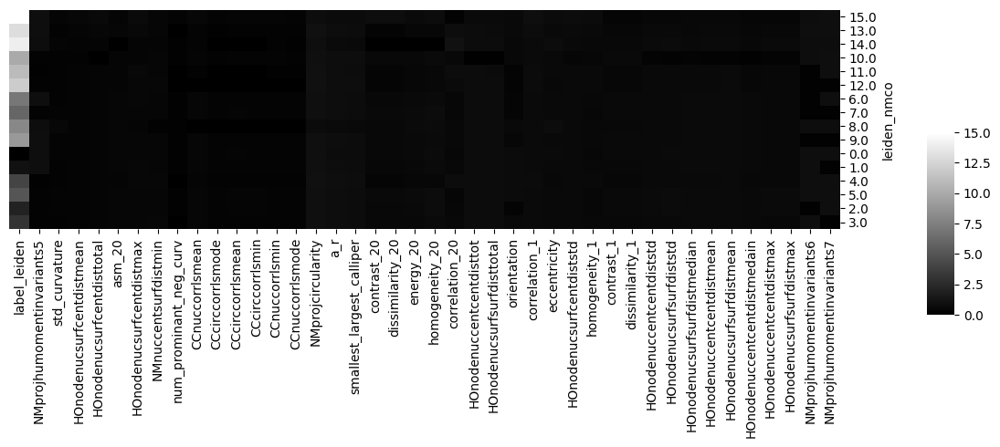

/tmp/ipykernel_3328293/1977501069.py:24: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout(); plt.show()


<Figure size 1380x700 with 0 Axes>

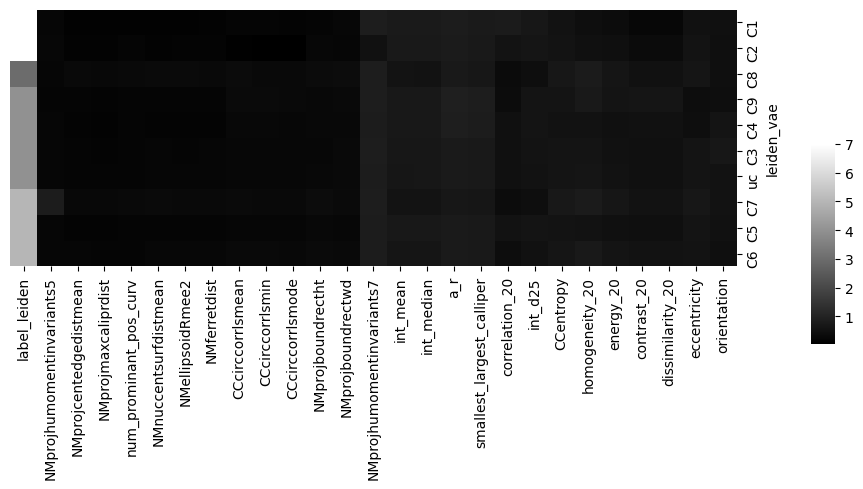

In [611]:
features = latent_list_df_lab_control_concensus_with_vae_just_bal.select_dtypes(include="number").columns.difference(['leiden_nmco']).tolist()
mean_by_label = latent_list_df_lab_control_concensus_with_vae_just_bal.groupby('leiden_nmco')[features].median()   # rows = labels, cols = features
spread = mean_by_label.max(axis=0) - mean_by_label.min(axis=0)
tol = 0.22         # set e.g. 0.05 if you want a minimum difference
keep = spread > tol
kept_features = spread.index[keep]

plt.figure(figsize=(0.4*len(kept_features)+3, 0.5*len(mean_by_label)+2))
sns.clustermap(mean_by_label[kept_features], cmap="gray", cbar=True,    dendrogram_ratio=(0.0001, 0.001),  # collapse any leftover axes
    cbar_pos=(1.02, 0.3, 0.03, 0.4), figsize=(10, 5))
#ax.set_xlabel("Features"); ax.set_ylabel("Label"); ax.set_title("Mean Handcrafted Feature Value by Handcrafted Cluster Label")
plt.tight_layout(); plt.show()

features = latent_list_df_lab_control_concensus_with_vae_just_bal.drop(columns= 'leiden_nmco').select_dtypes(include="number").columns.difference(['leiden_vae']).tolist()
mean_by_label = latent_list_df_lab_control_concensus_with_vae_just_bal.groupby('leiden_vae')[features].median()   # rows = labels, cols = features
spread = mean_by_label.max(axis=0) - mean_by_label.min(axis=0)
tol = 0.16          # set e.g. 0.05 if you want a minimum difference
keep = spread > tol
kept_features = spread.index[keep]
plt.figure(figsize=(0.4*len(kept_features)+3, 0.5*len(mean_by_label)+2))
sns.clustermap(mean_by_label[kept_features], cmap="gray", cbar=True,    dendrogram_ratio=(0.0001, 0.001),  # collapse any leftover axes
    cbar_pos=(1.02, 0.3, 0.03, 0.4), figsize=(8, 5))
#ax.set_xlabel("Features"); ax.set_ylabel("Label"); ax.set_title("Mean Handcrafted Feature Value by VAE Cluster Label")
plt.tight_layout(); plt.show()

In [555]:
kept_features

Index(['CCI80_by_I20', 'CCPDI', 'CCcentre_mismatch', 'CCcirccorrlsmean',
       'CCcirccorrlsmin', 'CCcirccorrlsmode', 'CCdnaintconc', 'CCdnastd',
       'CCentropy', 'CChcecratio',
       ...
       'weighted_moments_normalized-1-2', 'weighted_moments_normalized-1-3',
       'weighted_moments_normalized-2-0', 'weighted_moments_normalized-2-1',
       'weighted_moments_normalized-2-2', 'weighted_moments_normalized-2-3',
       'weighted_moments_normalized-3-0', 'weighted_moments_normalized-3-1',
       'weighted_moments_normalized-3-2', 'weighted_moments_normalized-3-3'],
      dtype='object', length=254)

In [ ]:
from datetime import datetime
import pickle
name_to_save = 'handcrafted_list_df_lab_control'+datetime.now().strftime('%Y%m%d%H%M%S')+'.pkl'
pickle.dump(latent_list_df_lab_control, open(name_to_save, 'wb'))
latent_list_df_lab_control



NameError: name 'df' is not defined

In [438]:
latent_list_df_lab_control_ulab_bal

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnodenucsurfsurfdistmax,HOnodenucsurfsurfdistmean,HOnodenucsurfsurfdistmedian,HOnodenucsurfsurfdistmin,HOnodenucsurfsurfdiststd,HOnodenucsurfsurfdisttotal,HOnumnode,HOstdnodevol,HOtotnodevol,labels_leiden
6070,0.250000,0.344828,0.372743,0.130980,0.401619,0.342045,0.365677,0.302163,0.413276,0.392184,...,0.386675,0.578561,0.635797,0.341970,0.422676,0.665555,0.190476,0.098216,0.174710,5
6072,0.363636,0.310345,0.735283,0.306913,0.249110,0.354589,0.353459,0.330801,0.332321,0.103464,...,0.638629,0.593151,0.495511,0.111063,0.702193,0.677142,0.111111,0.123142,0.087355,9
6076,0.318182,0.362069,0.504425,0.276711,0.277518,0.380049,0.374237,0.324970,0.399930,0.201737,...,0.474673,0.679130,0.648593,0.614943,0.522351,0.846356,0.174603,0.081842,0.156995,7
6078,0.272727,0.241379,0.672101,0.284835,0.200292,0.283253,0.286549,0.270480,0.271756,0.070601,...,0.386675,0.575526,0.635797,0.342004,0.428297,0.663157,0.158730,0.086775,0.180208,4
6079,0.386364,0.310345,0.795306,0.417961,0.241222,0.391921,0.395233,0.405486,0.355857,0.028278,...,0.638629,0.673199,0.679469,0.399056,0.662099,0.740664,0.142857,0.135722,0.267563,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48016,0.363636,0.379310,0.575221,0.351781,0.329871,0.416352,0.416929,0.369253,0.411733,0.168137,...,0.386675,0.462217,0.453495,0.140599,0.379668,0.573231,0.079365,0.186907,0.303604,13
48017,0.363636,0.275862,0.838180,0.312672,0.218715,0.338150,0.339551,0.348011,0.310843,0.052309,...,0.386675,0.596602,0.675227,0.129297,0.437452,0.679879,0.142857,0.037154,0.083690,13
48019,0.318182,0.275862,0.706700,0.275341,0.228051,0.333445,0.323613,0.305211,0.318155,0.109403,...,0.386675,0.459891,0.439171,0.244188,0.411247,0.571384,0.031746,0.247355,0.103849,12
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.386675,0.463542,0.460621,0.105232,0.387501,0.574282,0.079365,0.078941,0.167379,1


In [439]:
embedding_df_again = embedding_control.loc[latent_list_df_lab_control_ulab_bal.index]

In [440]:

embedding_df_again['patient_id'] = latent_list_df_lab_control['patient_id']
embedding_df_again['constriction_size'] = latent_list_df_lab_control['constriction_size']
embedding_df_again['disease'] = latent_list_df_lab_control['disease']
embedding_df_again['disease_constric'] = latent_list_df_lab_control['disease_constric']
embedding_df_again['patient_id_constric'] = latent_list_df_lab_control['patient_id_constric']
embedding_df_again['balanced_sample'] = latent_list_df_lab_control['balanced_sample']
embedding_df_again['label_leiden'] = latent_list_df_lab_control['label_leiden']
embedding_df_again

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6070,4.439791,-9.480517,35,control,Diabetic,Diabetic_control,35_control,1,5.0
6072,7.803930,-9.504251,46,control,Diabetic,Diabetic_control,46_control,1,9.0
6076,7.174655,-11.548168,67,control,Diabetic,Diabetic_control,67_control,1,7.0
6078,7.309592,-7.313773,35,control,Diabetic,Diabetic_control,35_control,1,4.0
6079,8.400229,-12.136962,62,control,Diabetic,Diabetic_control,62_control,1,2.0
...,...,...,...,...,...,...,...,...,...
48016,12.594169,-10.339138,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0
48017,11.721320,-6.231086,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0
48019,9.684473,-4.827662,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0


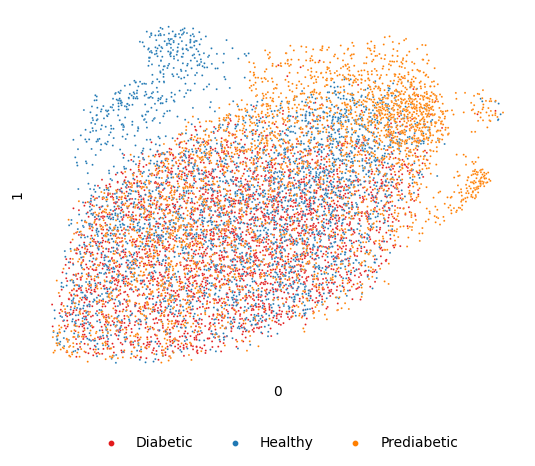

In [441]:
control_palette = [paired_palette[5],paired_palette[1],paired_palette[7]]

sns.scatterplot(data=embedding_df_again,x=0,y=1,s=2,hue="disease",palette=control_palette)

plt.legend(
    loc='upper center',
    bbox_to_anchor=(0.5, -0.12),  # center horizontally, drop below axes
    ncol=4,                       # spread the handles in one row
    frameon=False,                # optional styling
    title='',                # optional label
    markerscale=3
)
sns.despine(left=True, bottom=True)
plt.xticks([], [])
plt.yticks([], [])
plt.show()

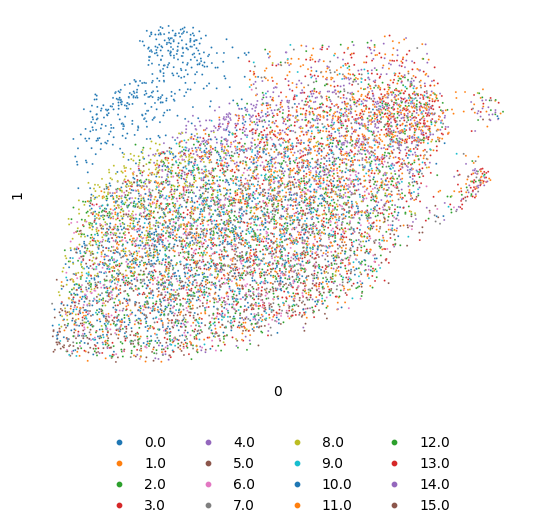

In [442]:
sns.scatterplot(data=embedding_df_again,x=0,y=1,s=2,hue="label_leiden",palette='tab10')

plt.legend(
    loc='upper center',
    bbox_to_anchor=(0.5, -0.12),  # center horizontally, drop below axes
    ncol=4,                       # spread the handles in one row
    frameon=False,                # optional styling
    title='',                # optional label
    markerscale=3
)
sns.despine(left=True, bottom=True)
plt.xticks([], [])
plt.yticks([], [])
plt.show()

In [443]:
embedding_df_again.groupby('disease').count()

,0,1,patient_id,constriction_size,disease_constric,patient_id_constric,balanced_sample,label_leiden
disease,,,,,,,,
Diabetic,3317,3317,3317,3317,3317,3317,3317,3317
Healthy,3303,3303,3303,3303,3303,3303,3303,3303
Prediabetic,3316,3316,3316,3316,3316,3316,3316,3316


In [444]:
embedding_df_again

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6070,4.439791,-9.480517,35,control,Diabetic,Diabetic_control,35_control,1,5.0
6072,7.803930,-9.504251,46,control,Diabetic,Diabetic_control,46_control,1,9.0
6076,7.174655,-11.548168,67,control,Diabetic,Diabetic_control,67_control,1,7.0
6078,7.309592,-7.313773,35,control,Diabetic,Diabetic_control,35_control,1,4.0
6079,8.400229,-12.136962,62,control,Diabetic,Diabetic_control,62_control,1,2.0
...,...,...,...,...,...,...,...,...,...
48016,12.594169,-10.339138,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0
48017,11.721320,-6.231086,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0
48019,9.684473,-4.827662,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0


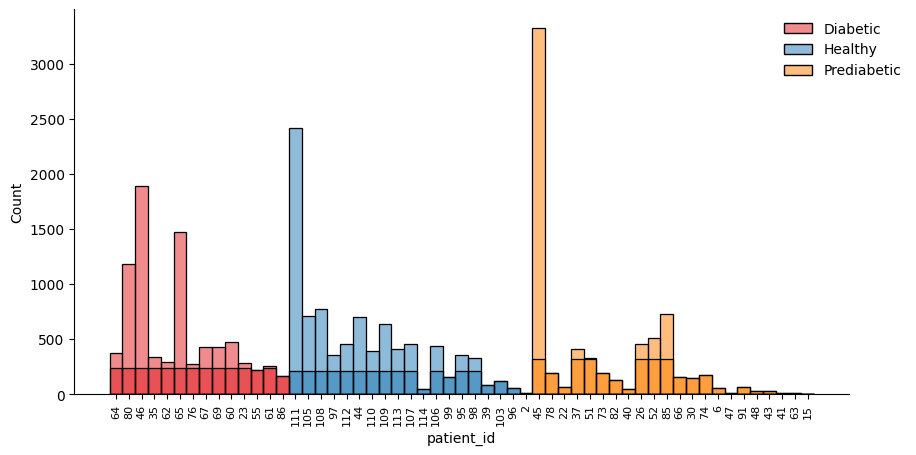

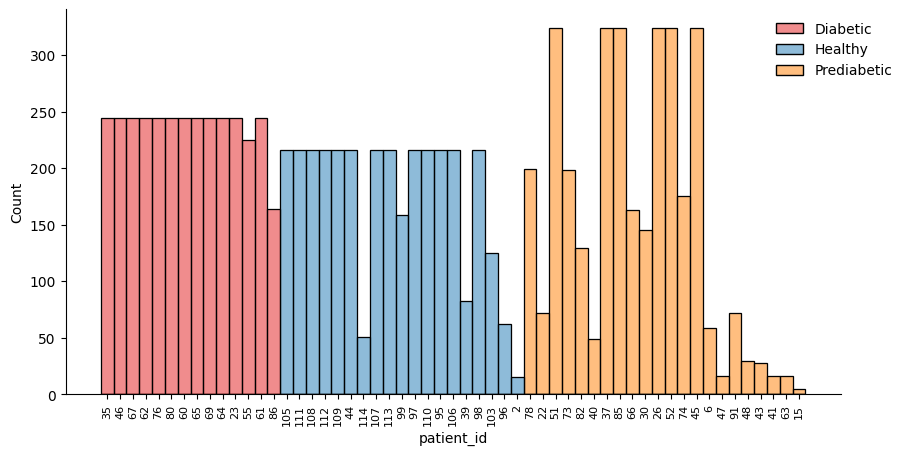

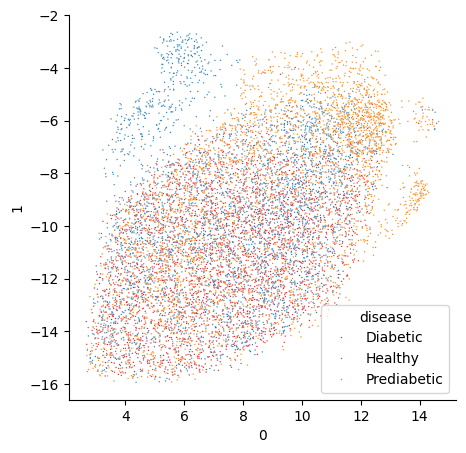

<Figure size 500x500 with 0 Axes>

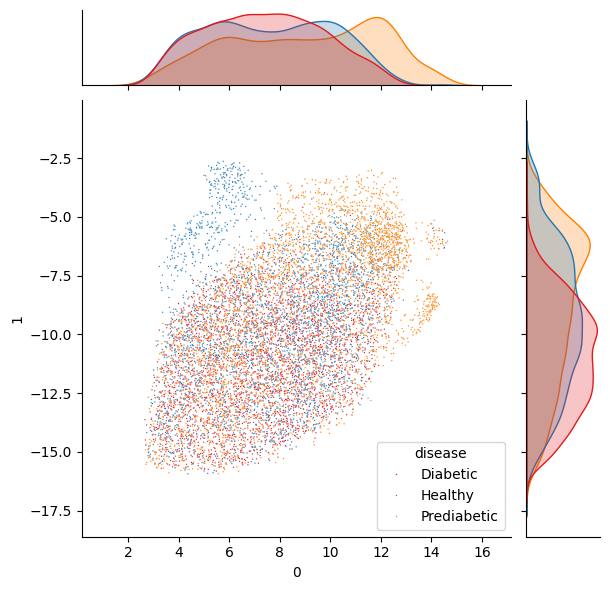

In [445]:
for_plots=latent_list_df_lab_control.dropna()
fig,ax=plt.subplots(figsize=(10,5))
sns.histplot(latent_list_df_lab_control,x='patient_id',hue='disease',palette=custom_paired_palette)
sns.histplot(for_plots,x='patient_id',hue='disease',palette=custom_paired_palette)
sns.move_legend(ax,"upper left",bbox_to_anchor=(0.9,1),title=None,frameon=False,)
plt.xticks(rotation=90,fontsize=8)
sns.despine() 
plt.show()


fig,ax=plt.subplots(figsize=(10,5))
sns.histplot(for_plots,x='patient_id',hue='disease',palette=custom_paired_palette)
sns.move_legend(ax,"upper left",bbox_to_anchor=(0.9,1),title=None,frameon=False,)
plt.xticks(rotation=90,fontsize=8)
sns.despine() 
plt.show()

plt.figure(figsize=(5, 5))
sns.scatterplot(data=embedding_df_again,x=0,y=1,s=1,hue="disease",palette=custom_paired_palette)
sns.despine() 
plt.show()

plt.figure(figsize=(5, 5))
sns.jointplot(data=embedding_df_again,x=0,y=1,s=1,hue="disease",palette=custom_paired_palette)
sns.despine() 
plt.show()

103


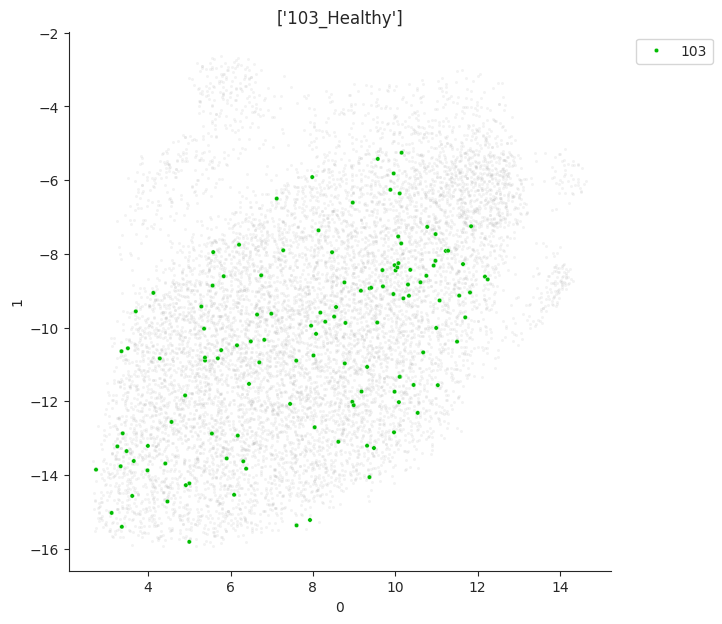

105


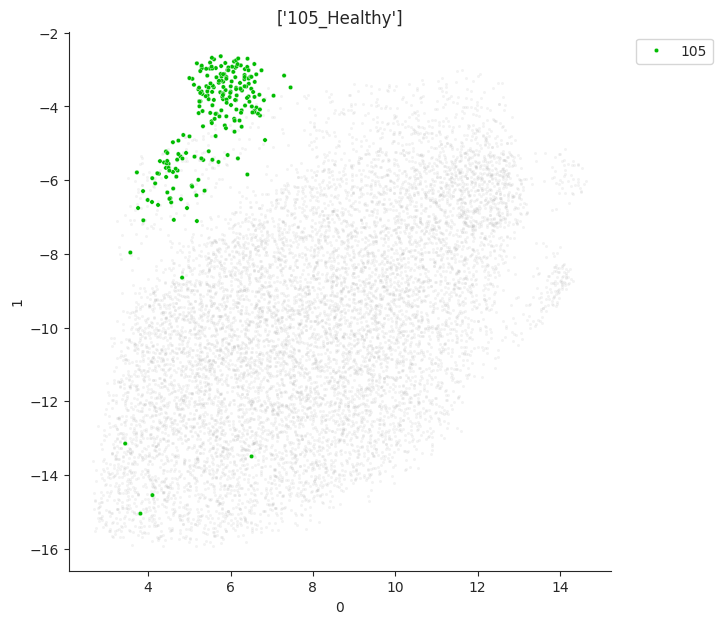

106


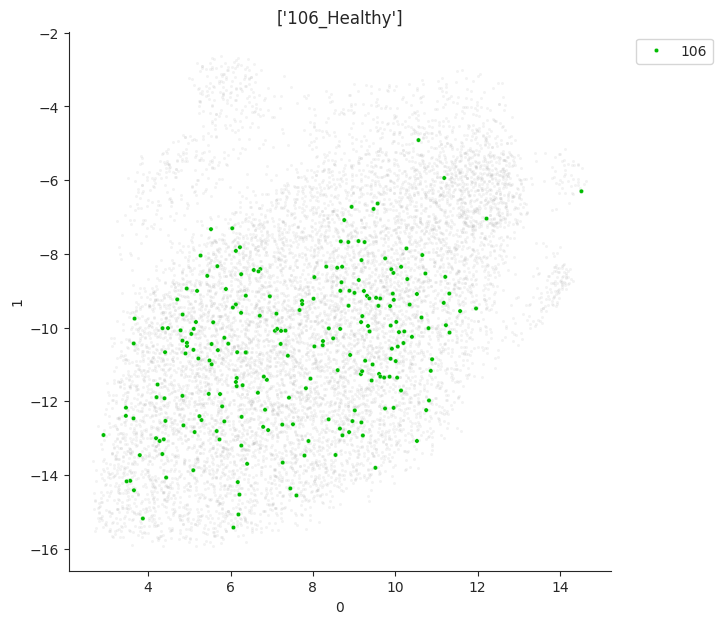

107


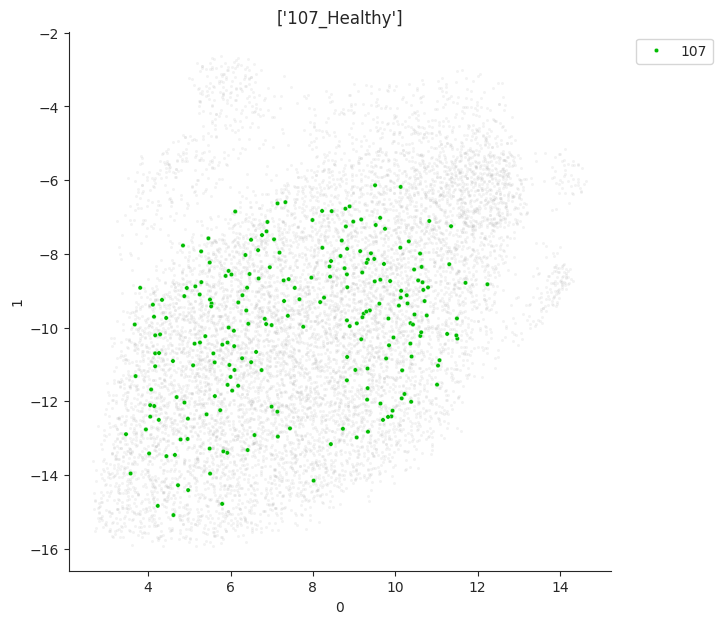

108


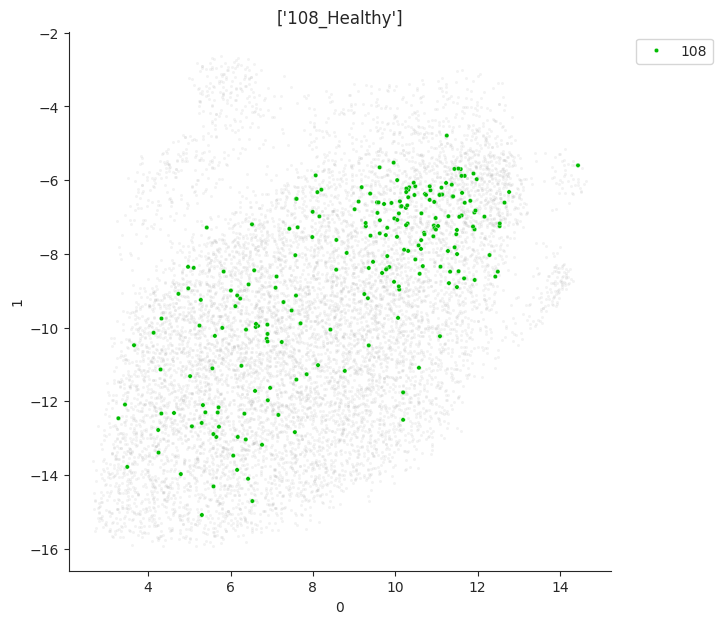

109


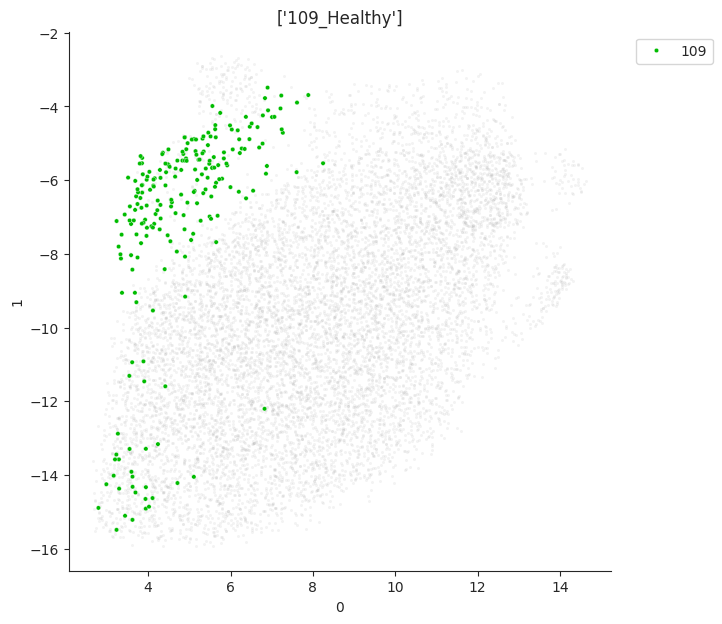

110


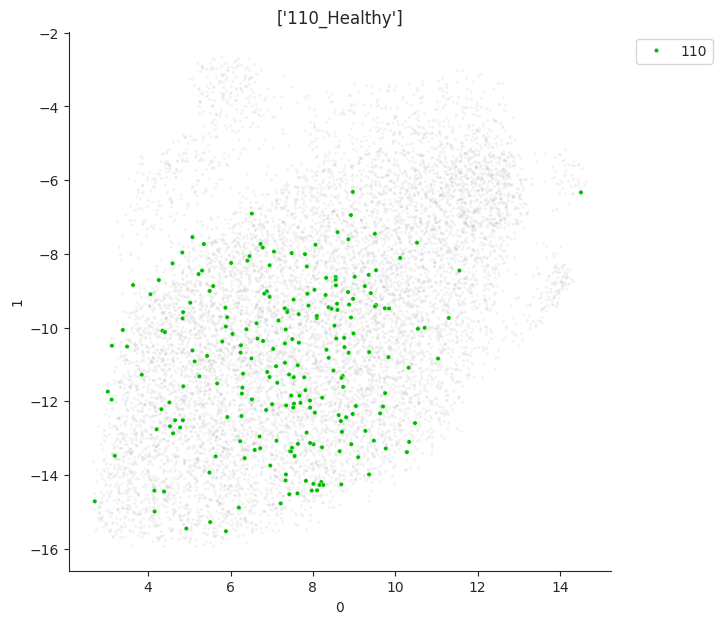

111


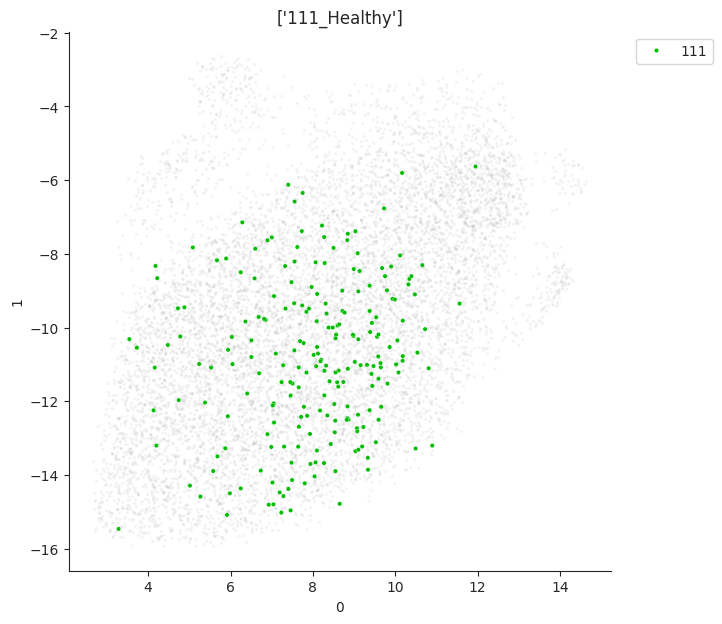

112


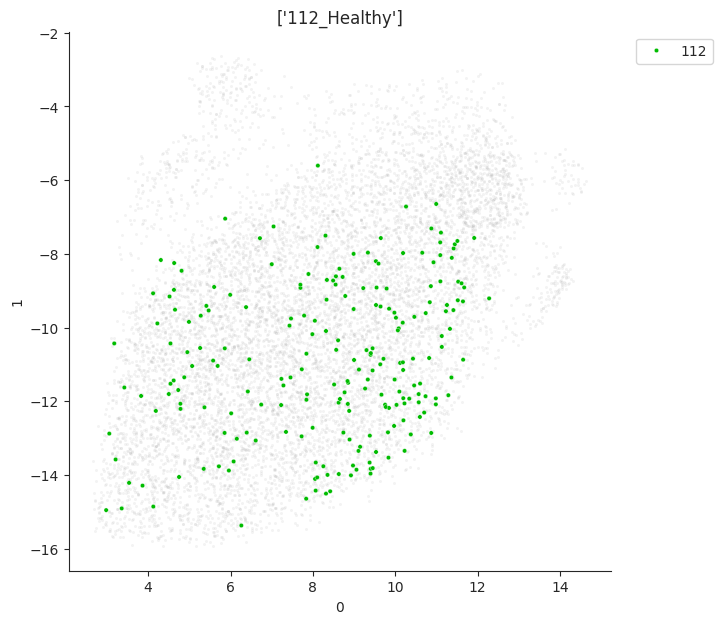

113


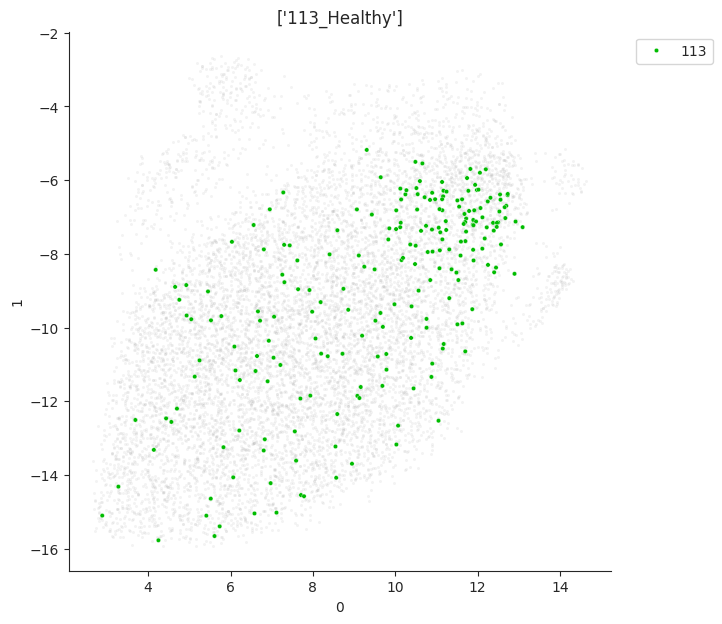

114


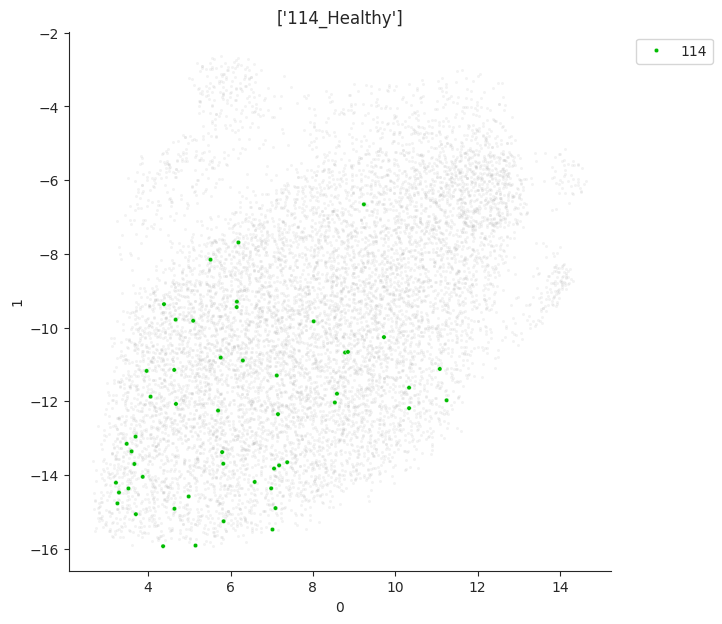

15


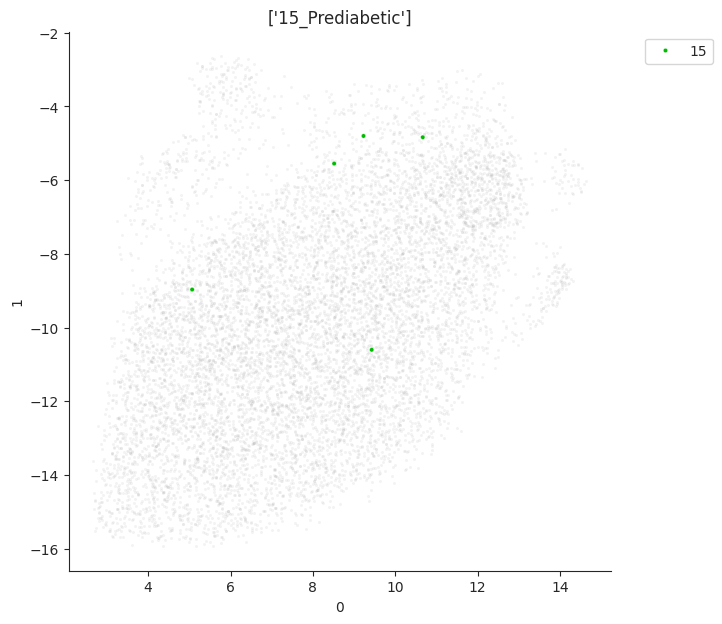

2


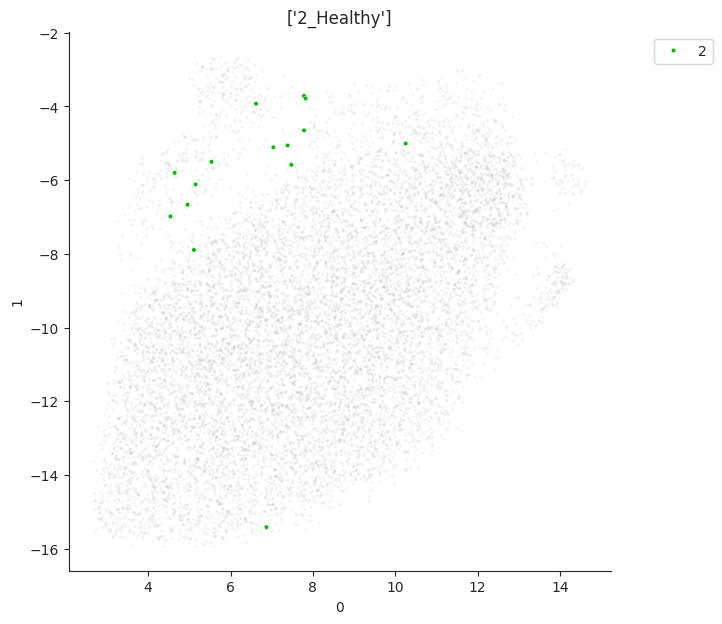

22


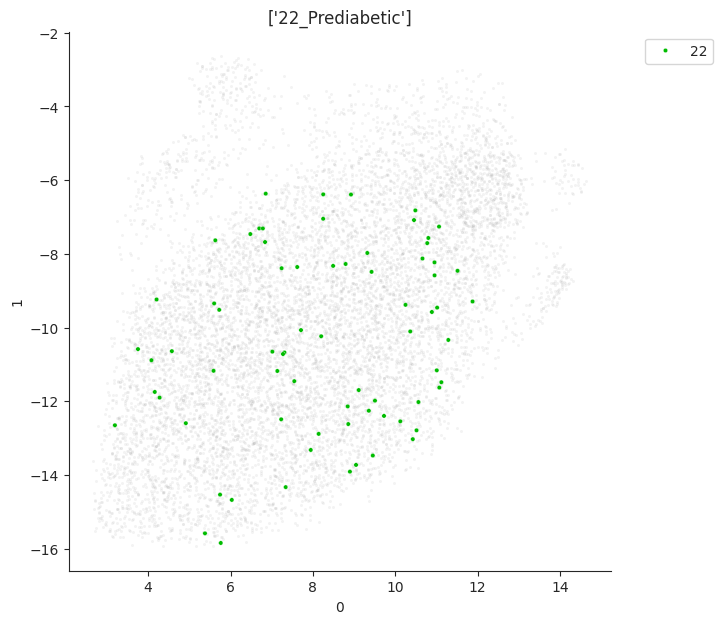

23


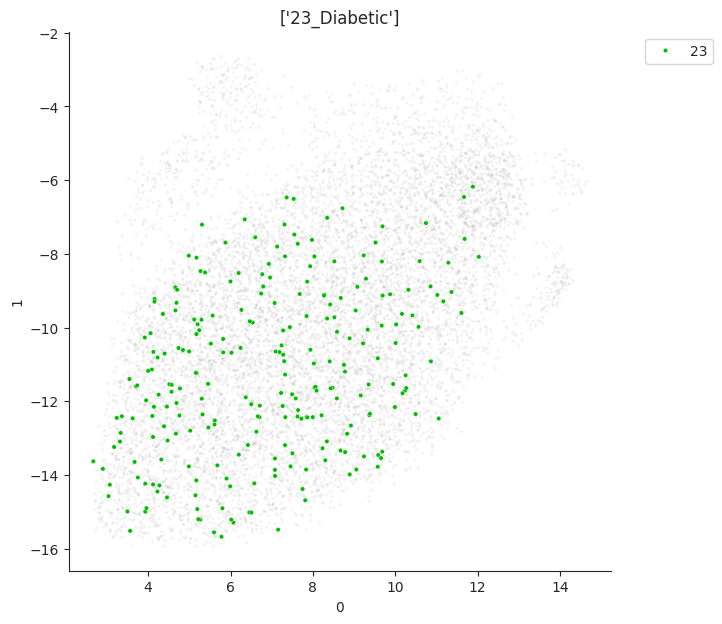

26


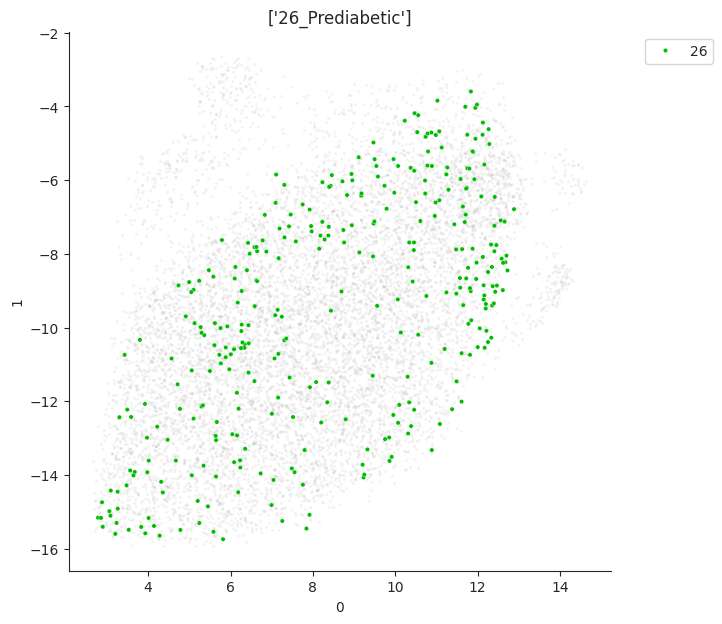

30


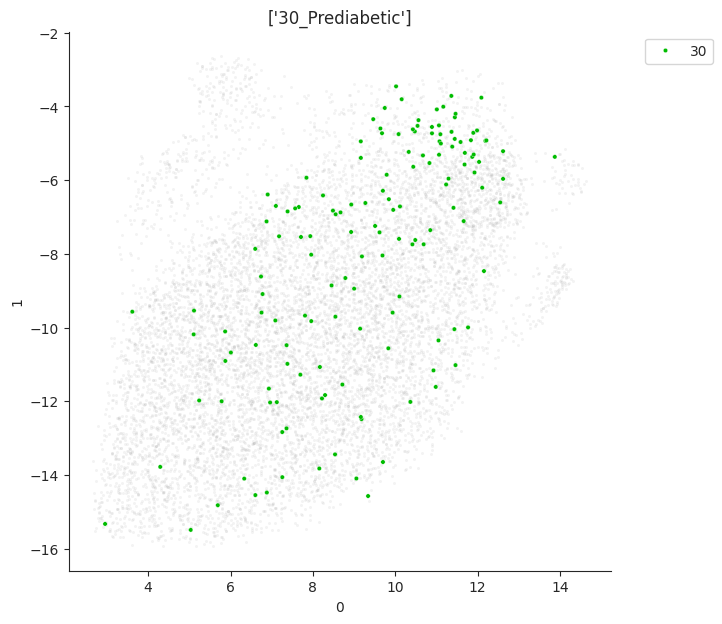

35


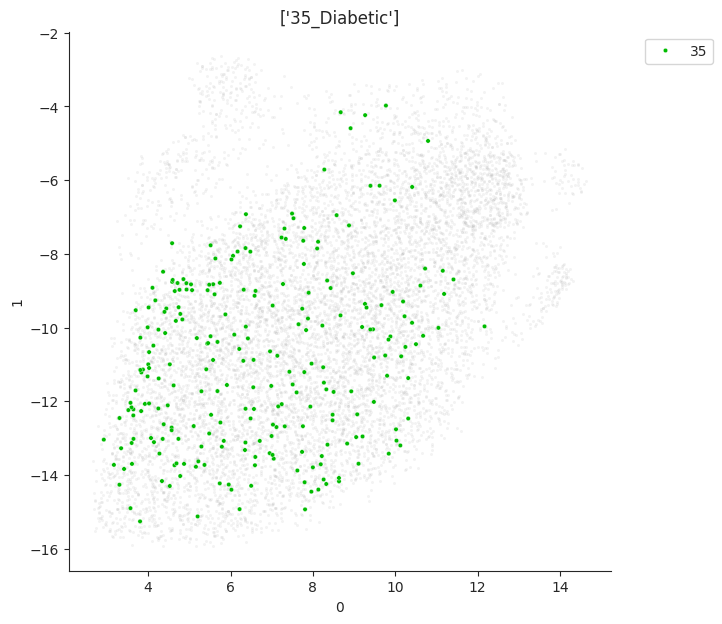

37


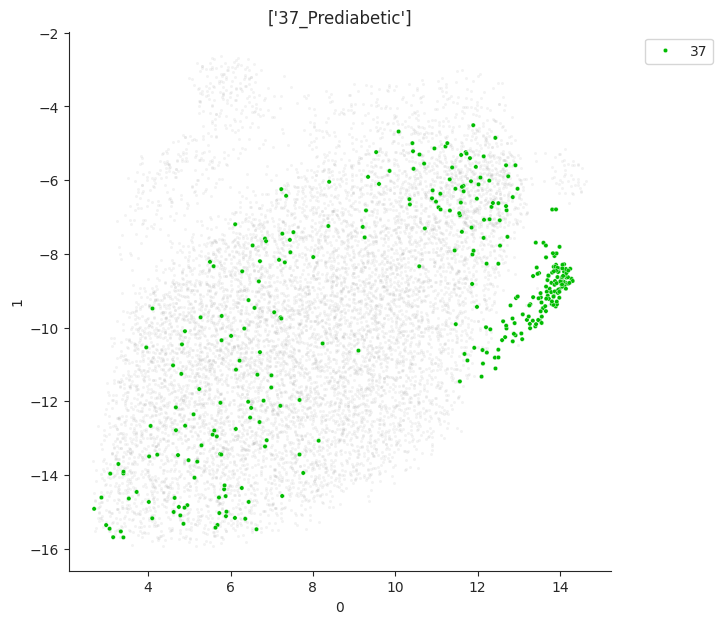

39


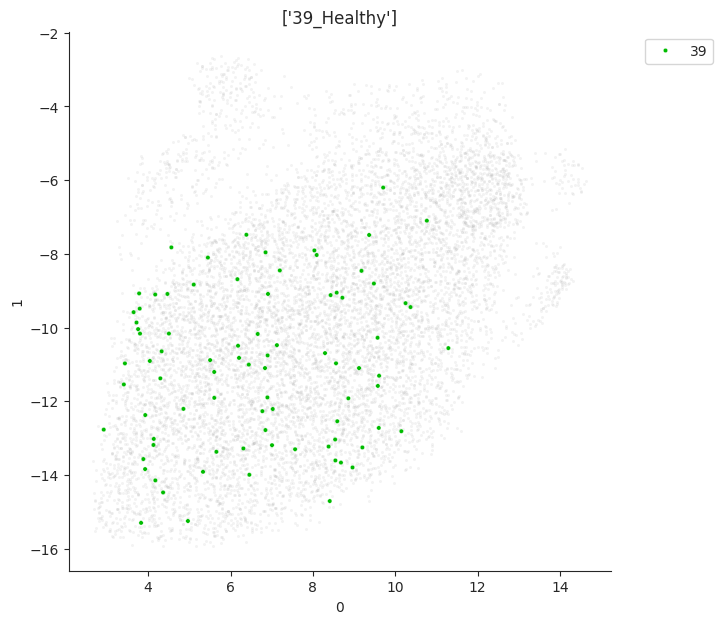

40


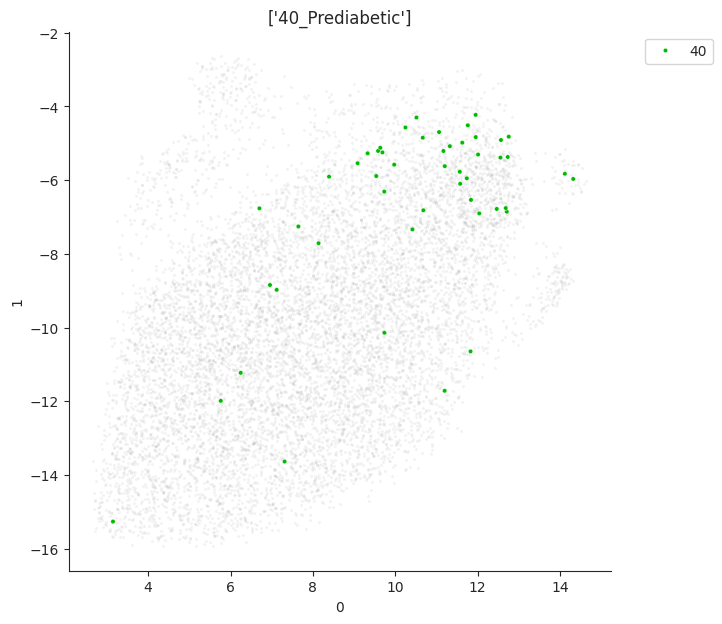

41


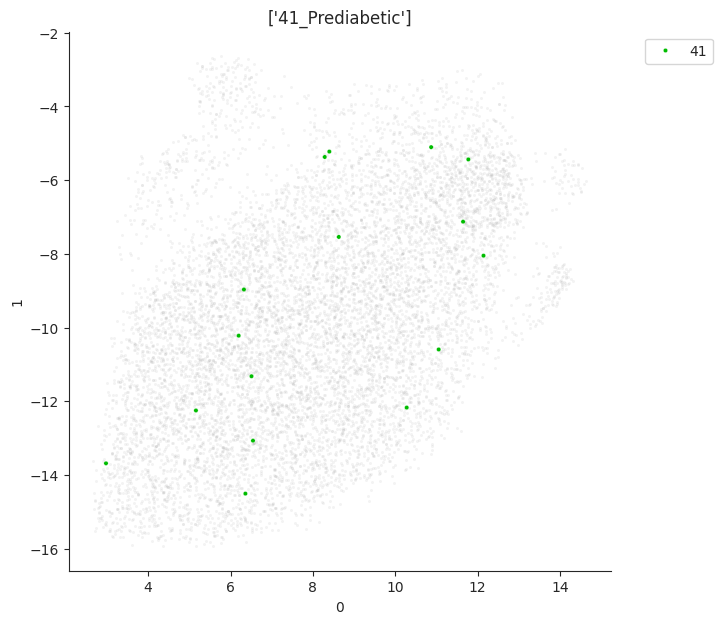

43


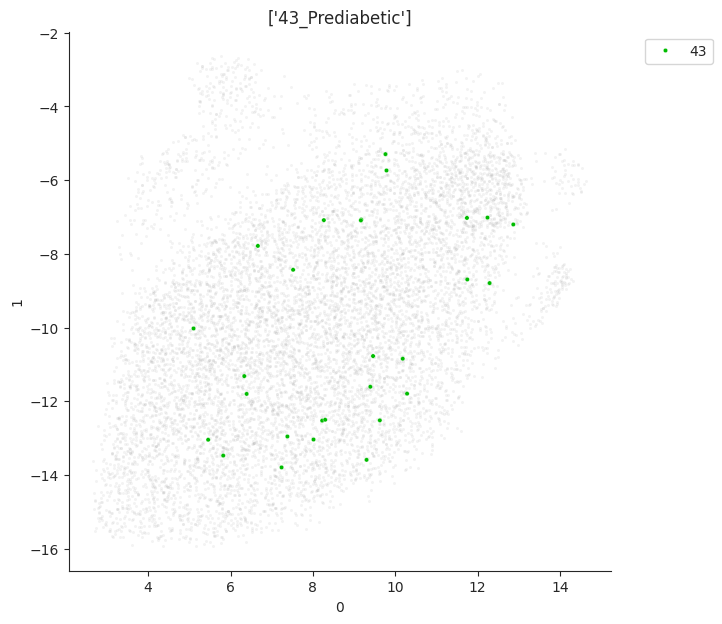

44


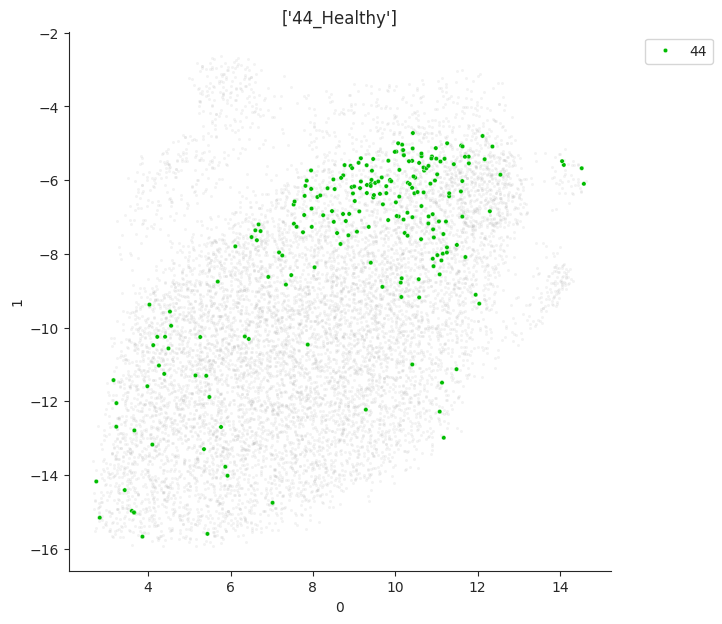

45


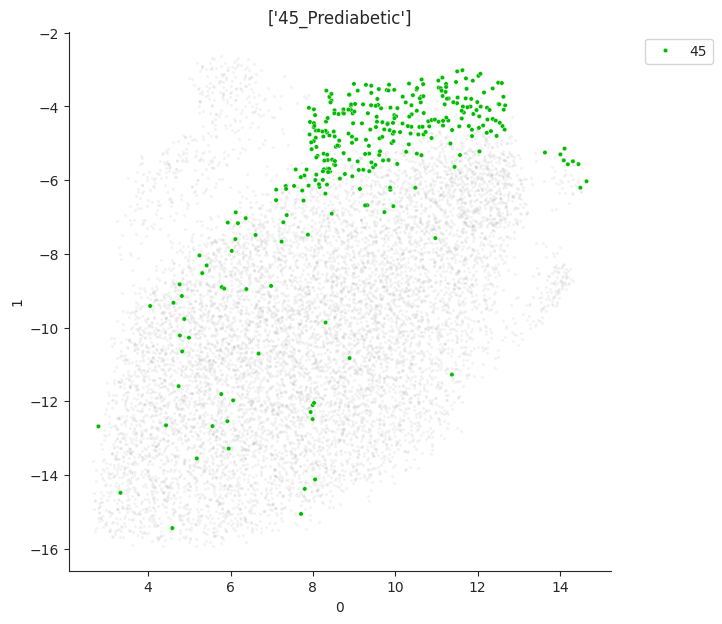

46


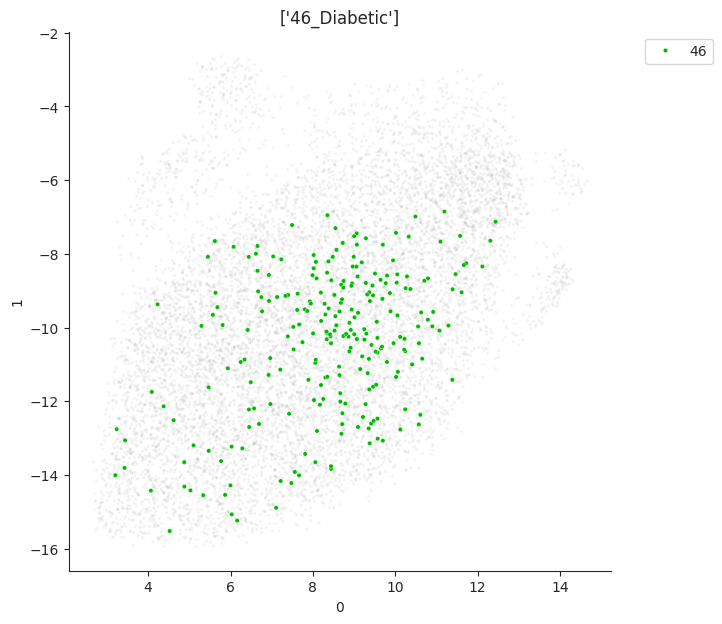

47


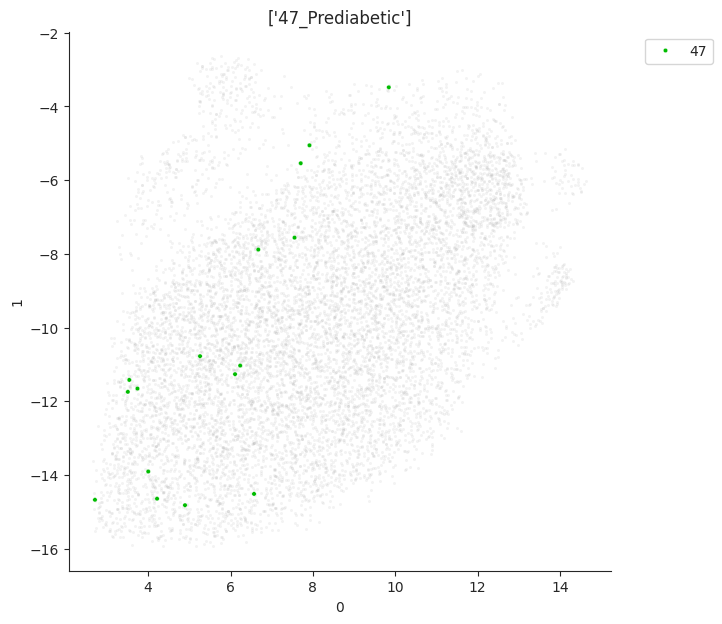

48


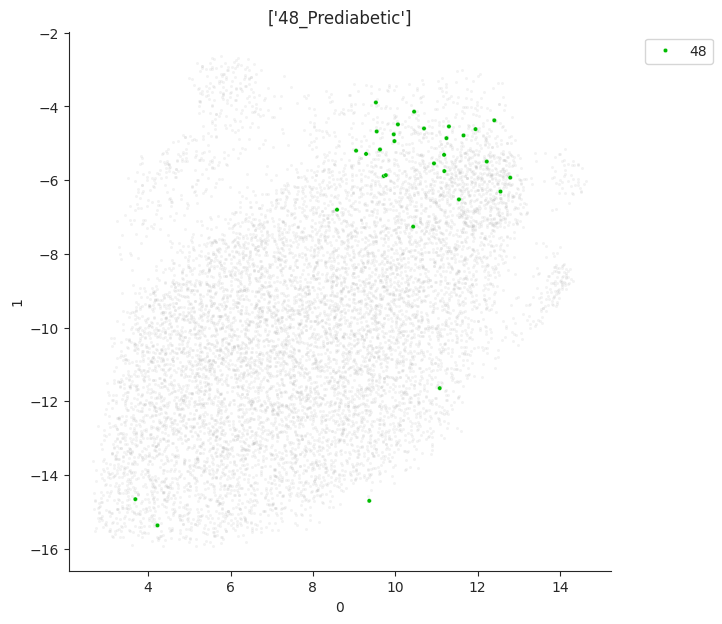

51


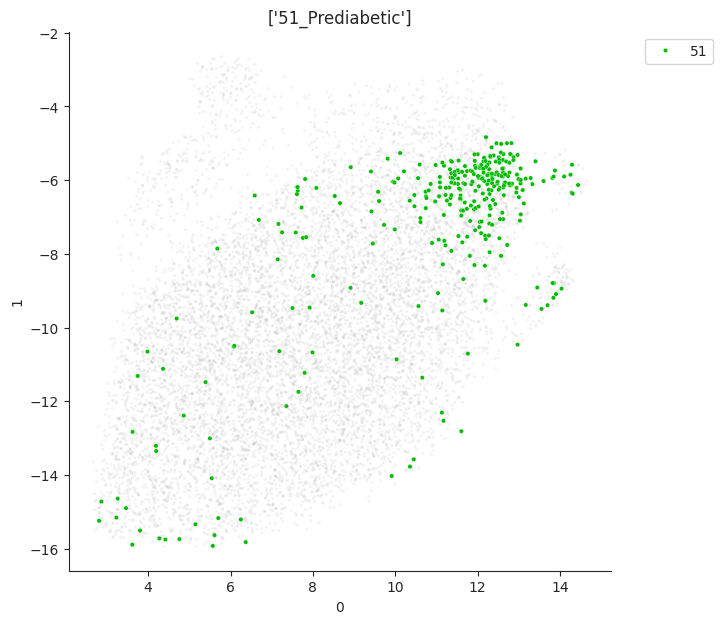

52


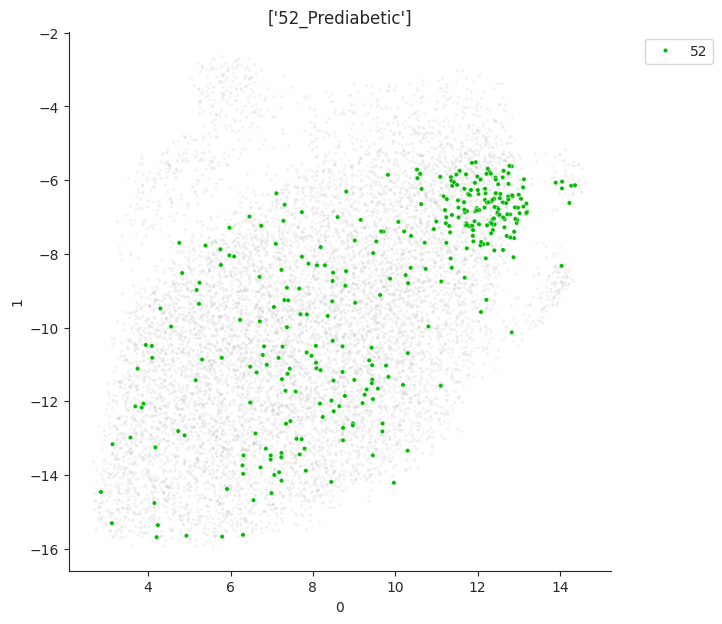

55


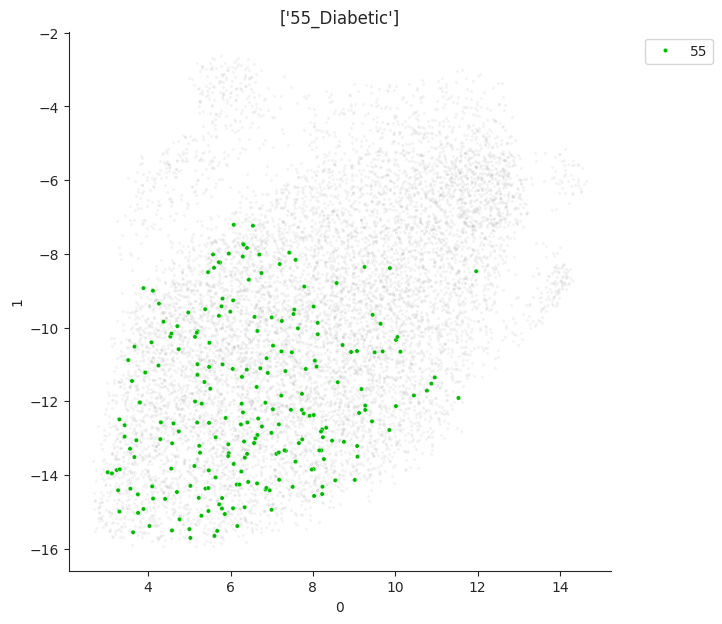

6


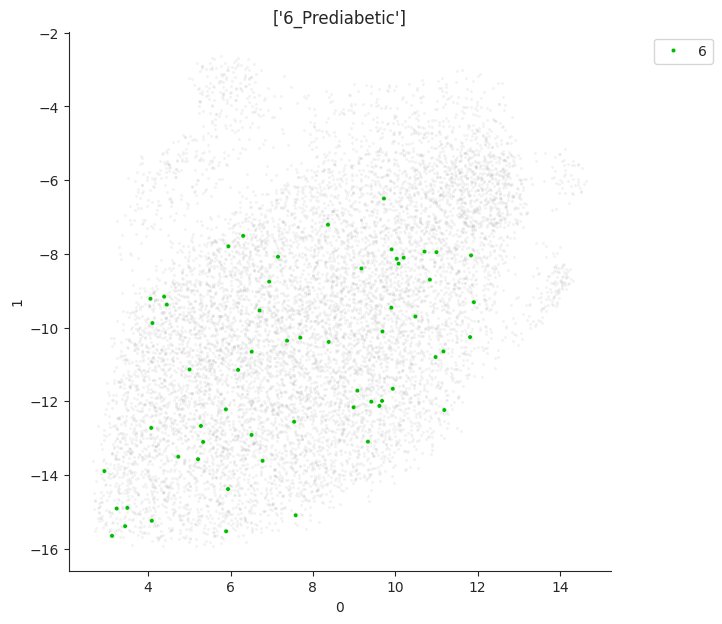

60


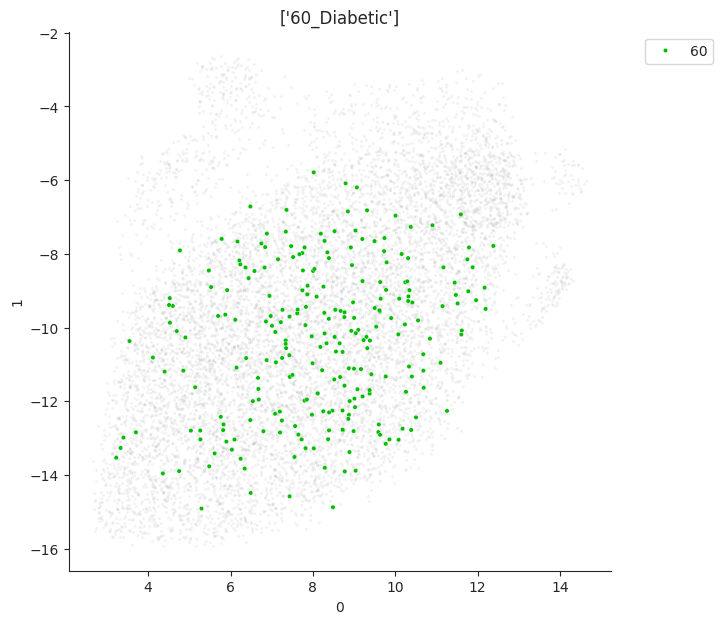

61


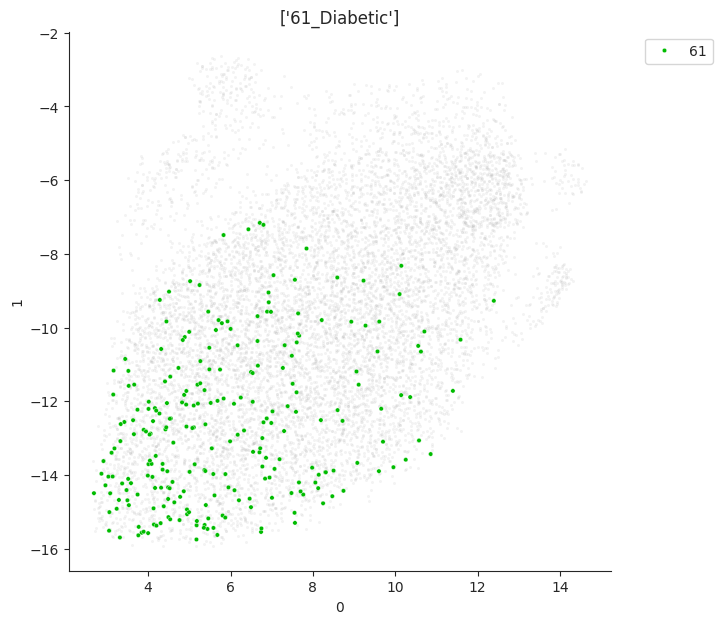

62


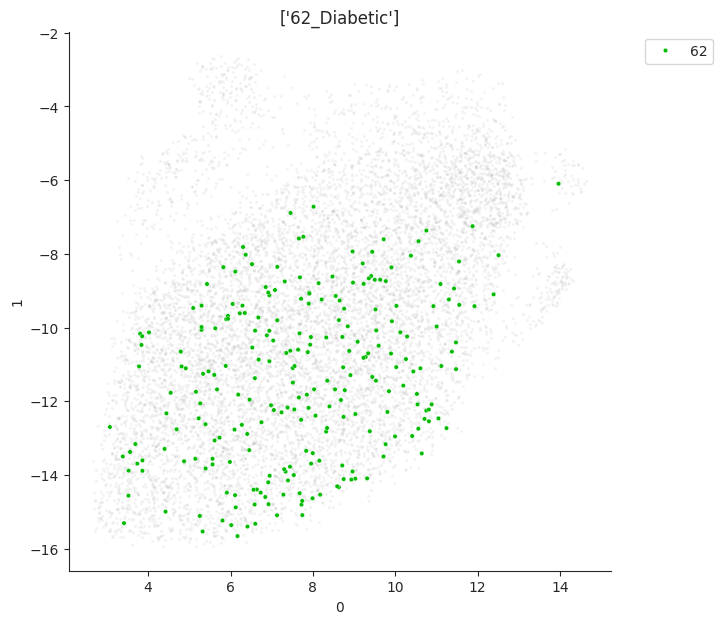

63


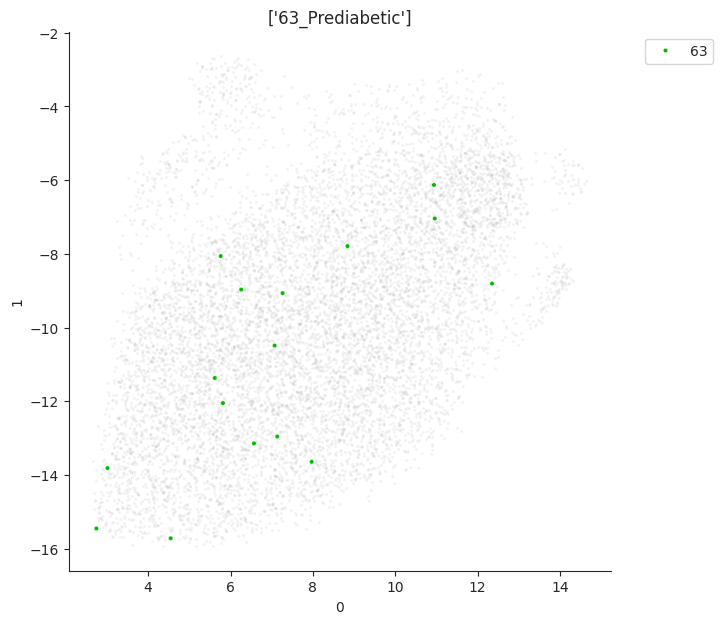

64


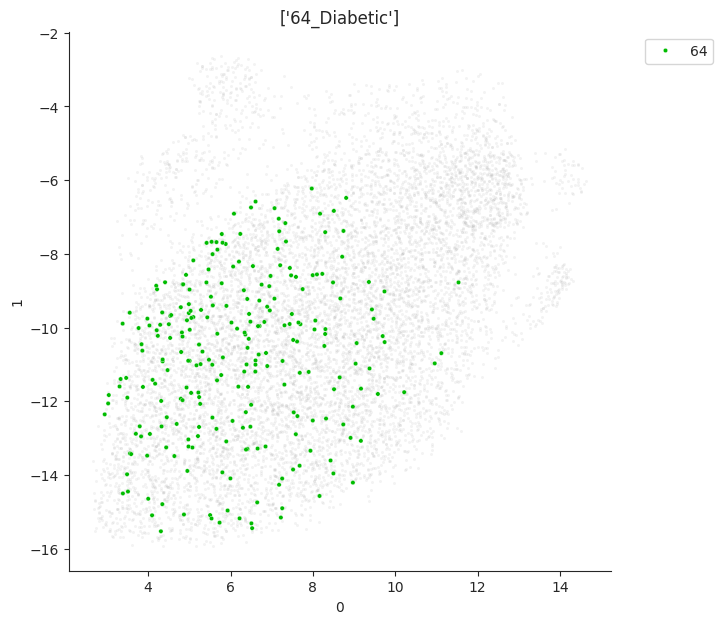

65


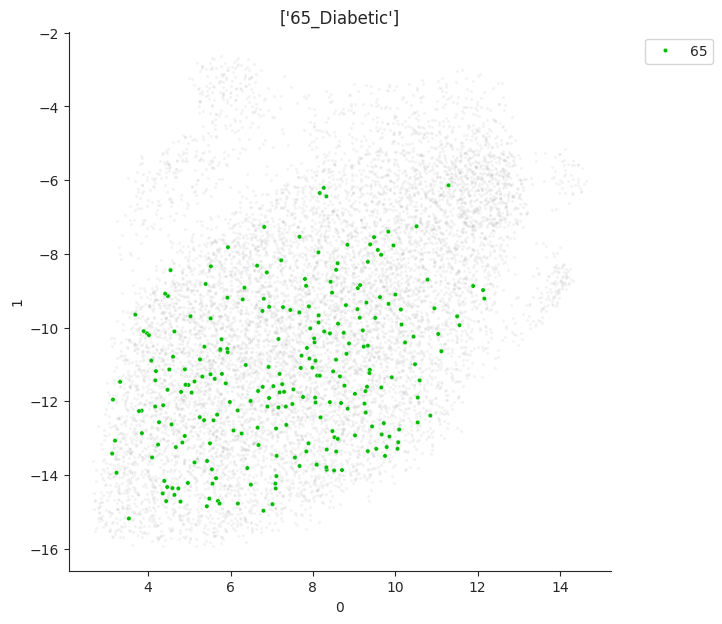

66


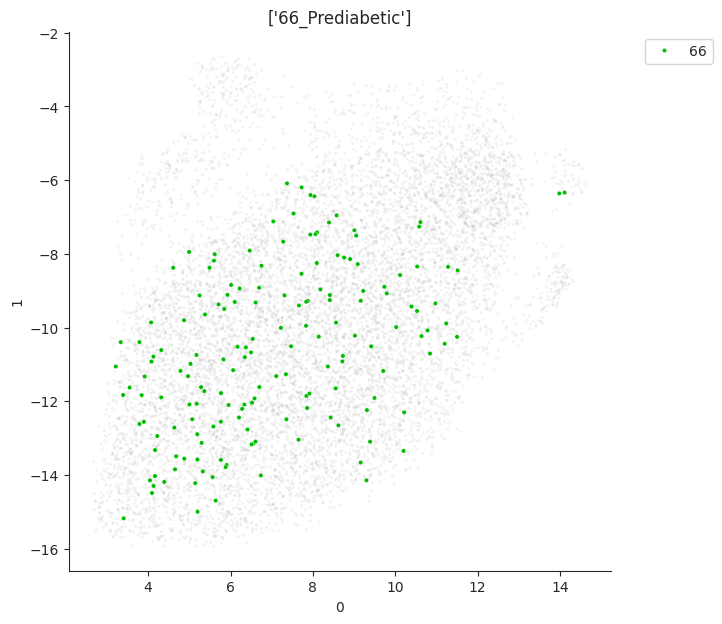

67


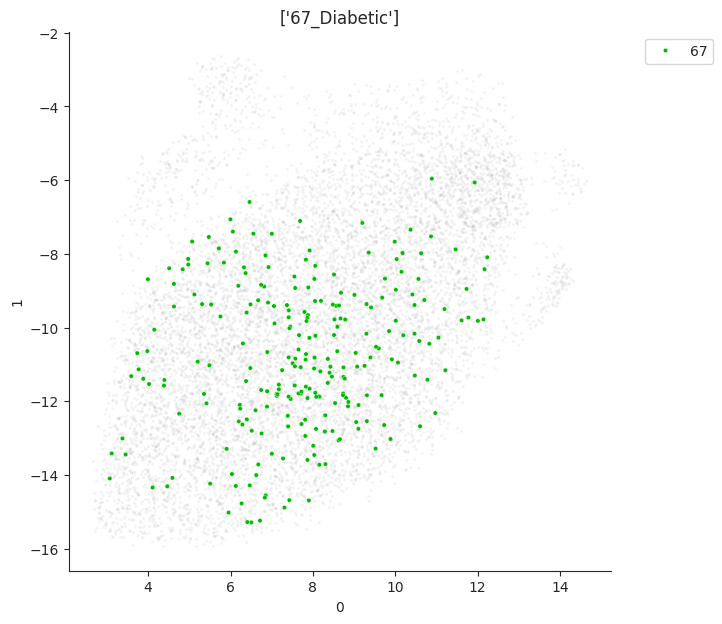

69


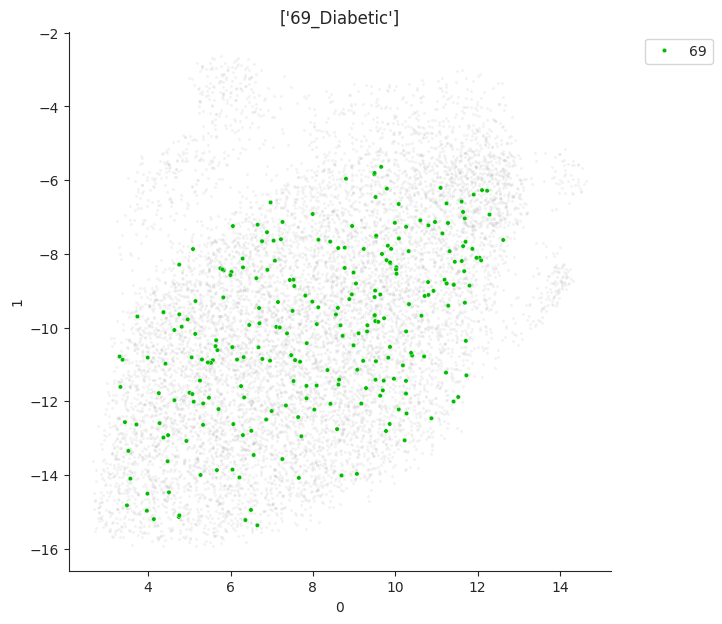

73


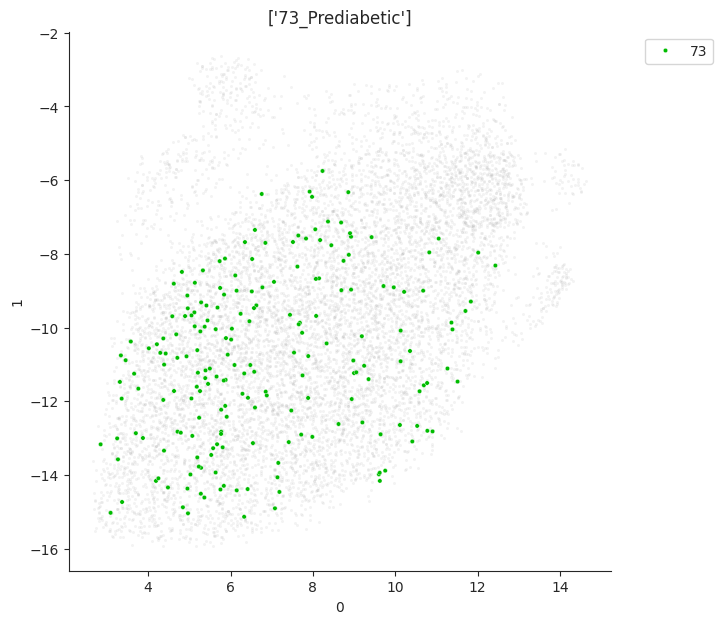

74


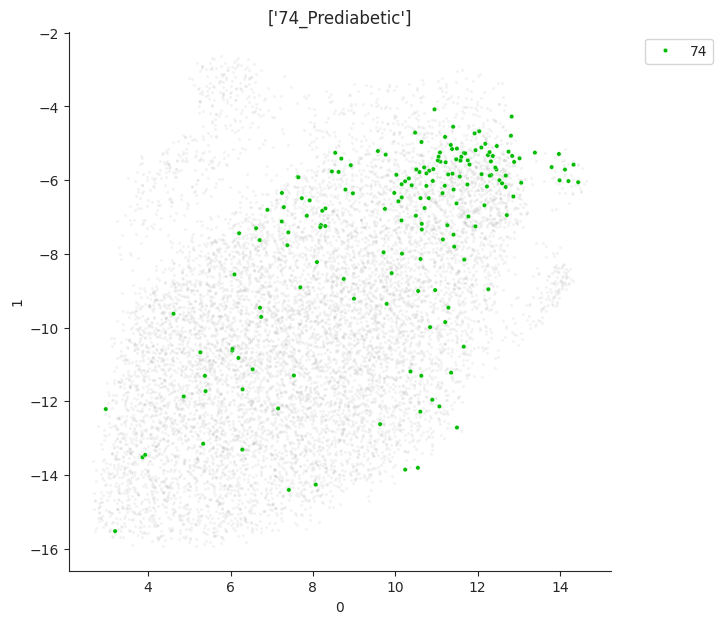

76


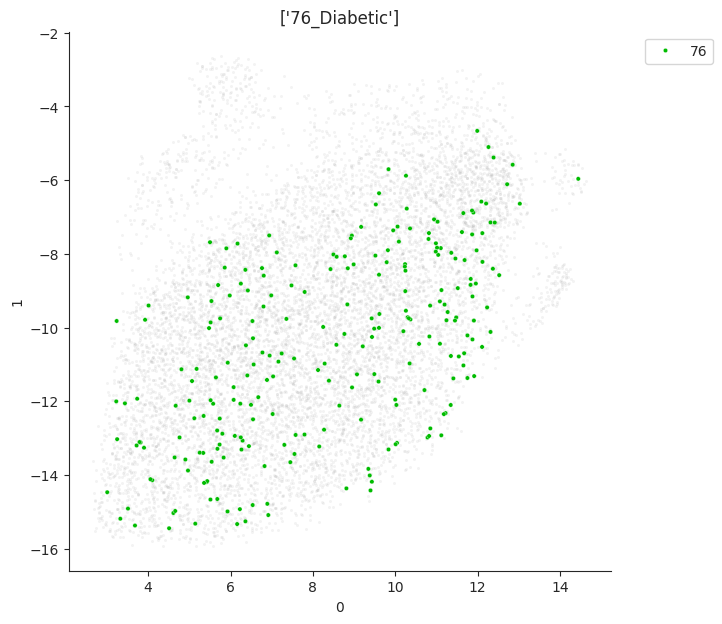

78


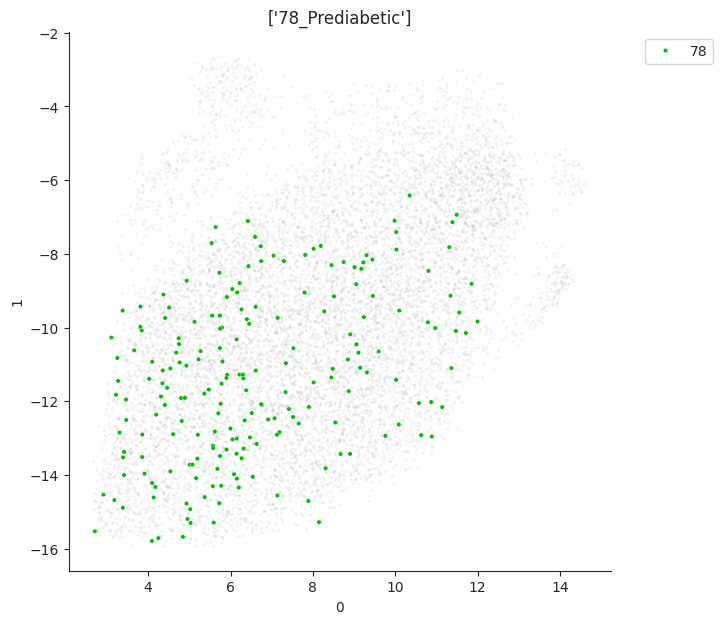

80


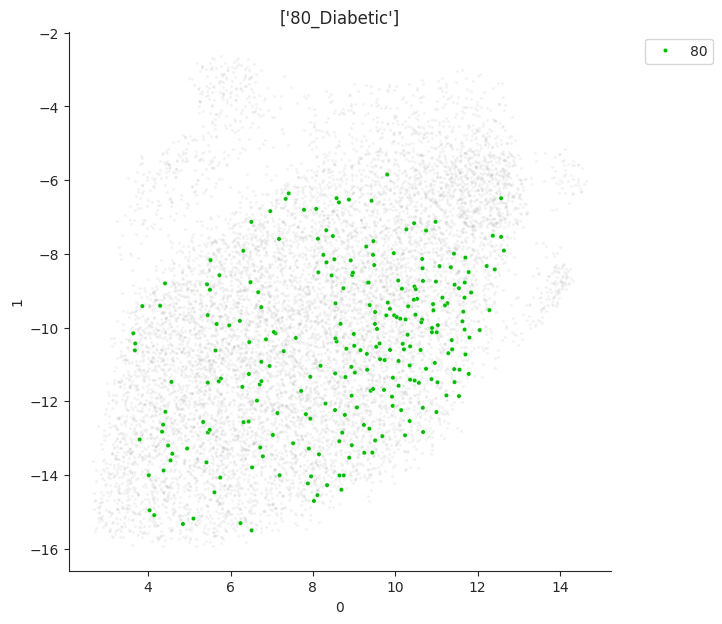

82


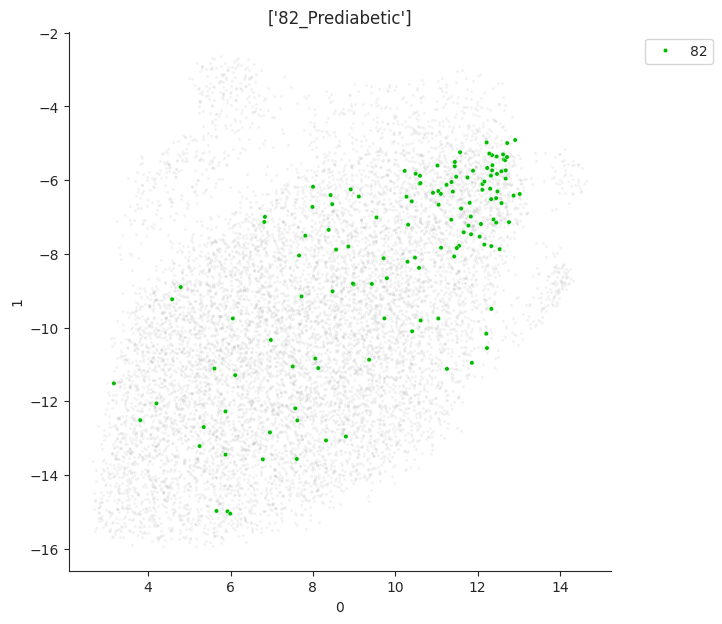

85


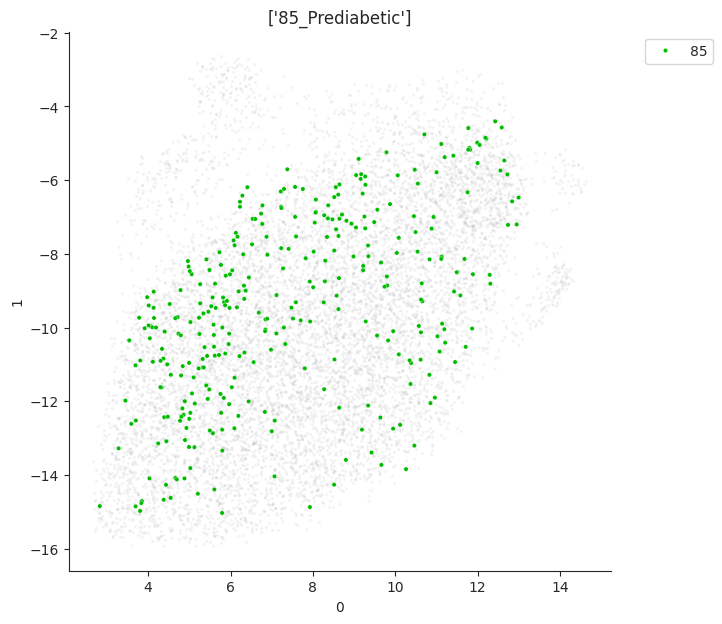

86


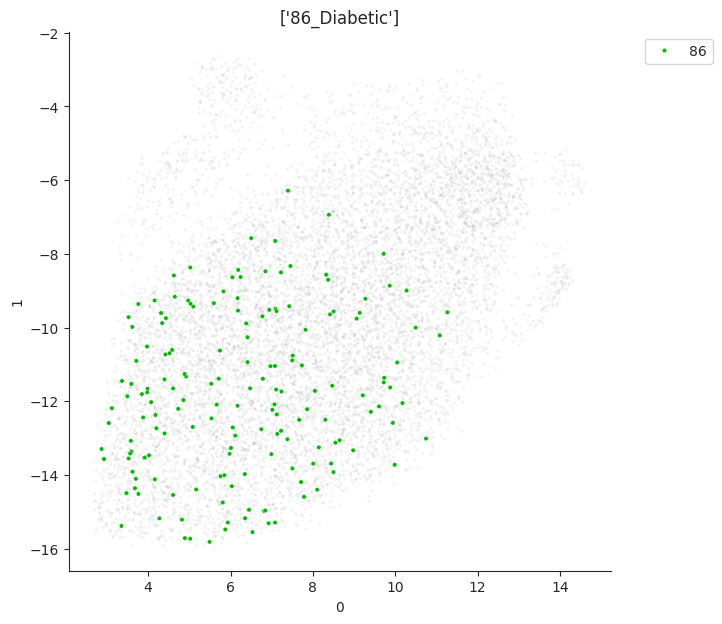

91


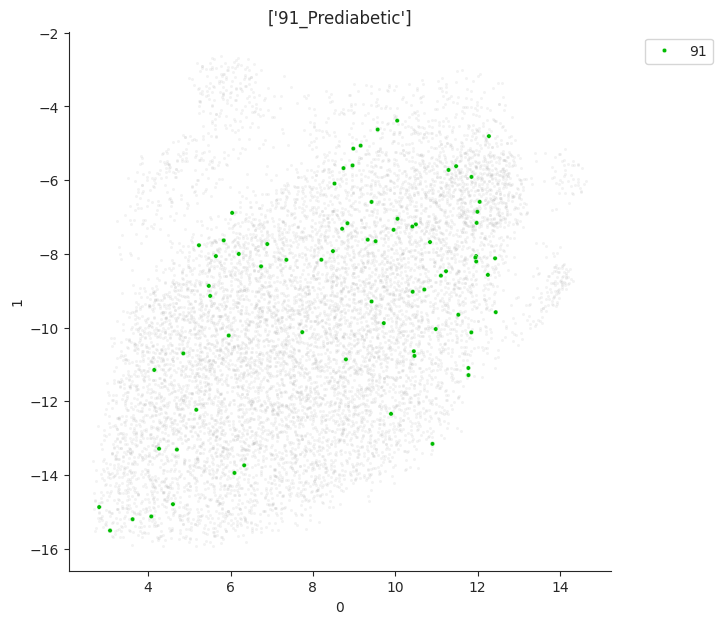

95


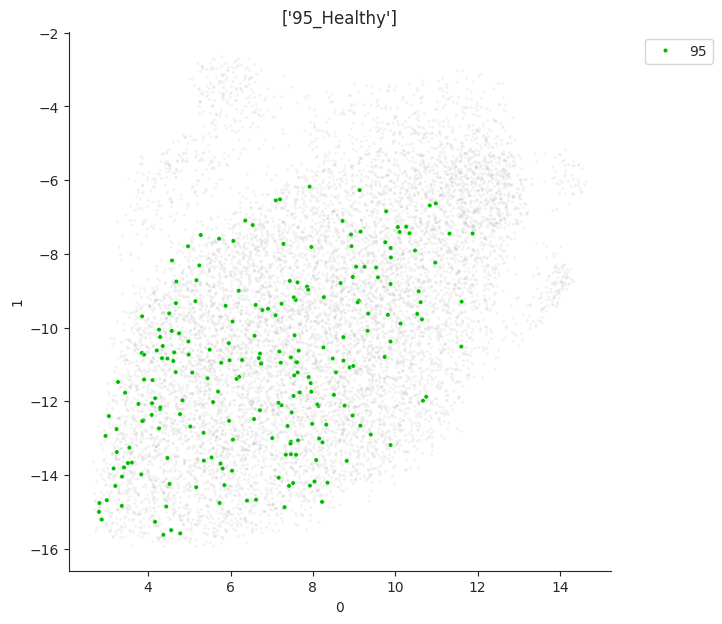

96


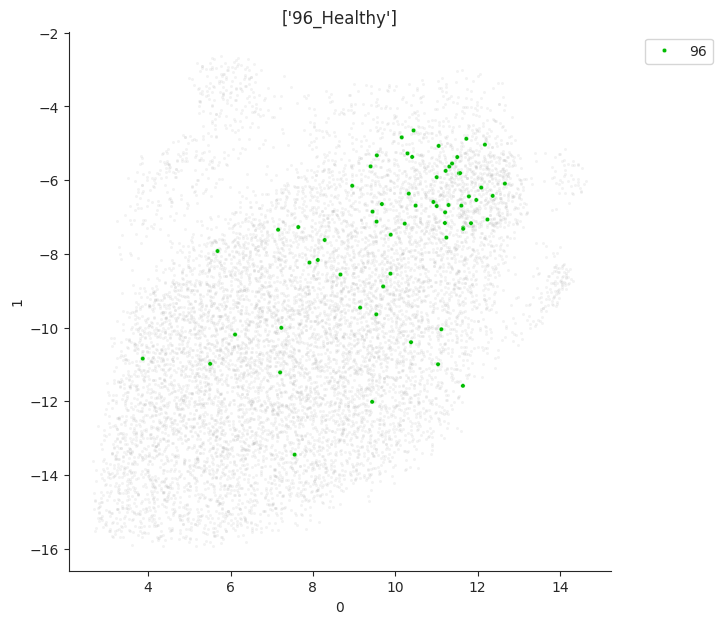

97


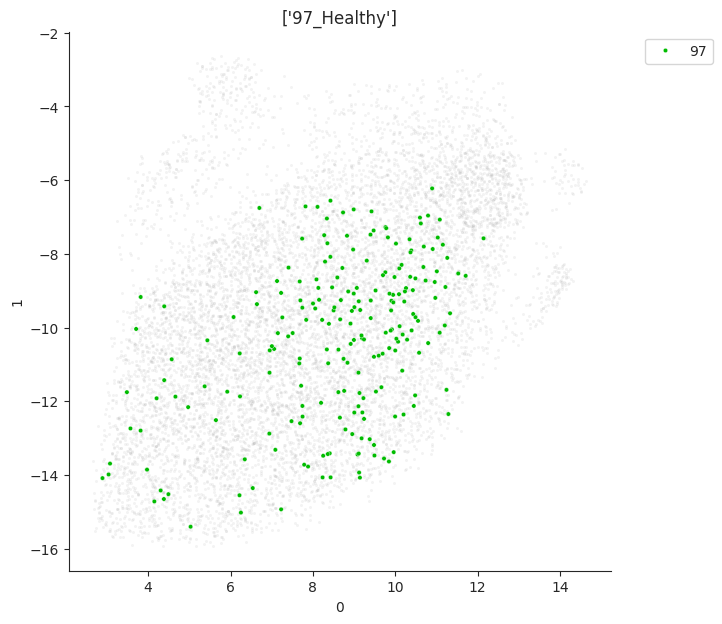

98


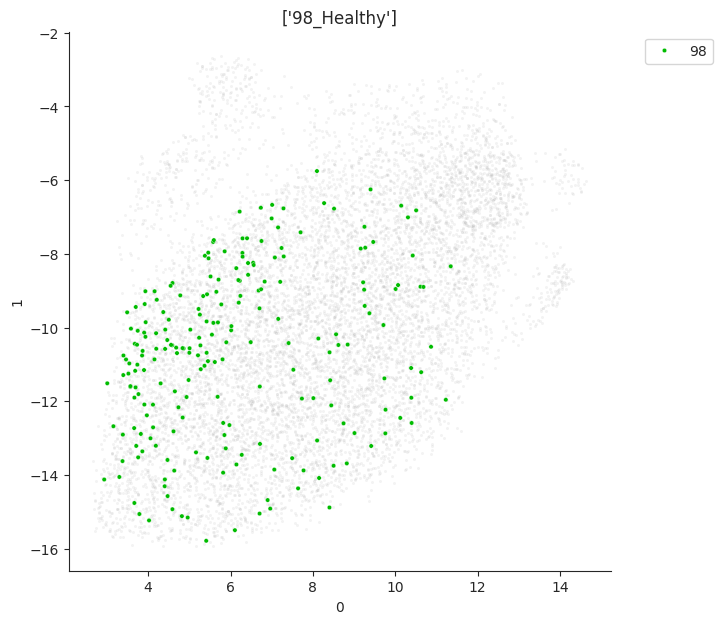

99


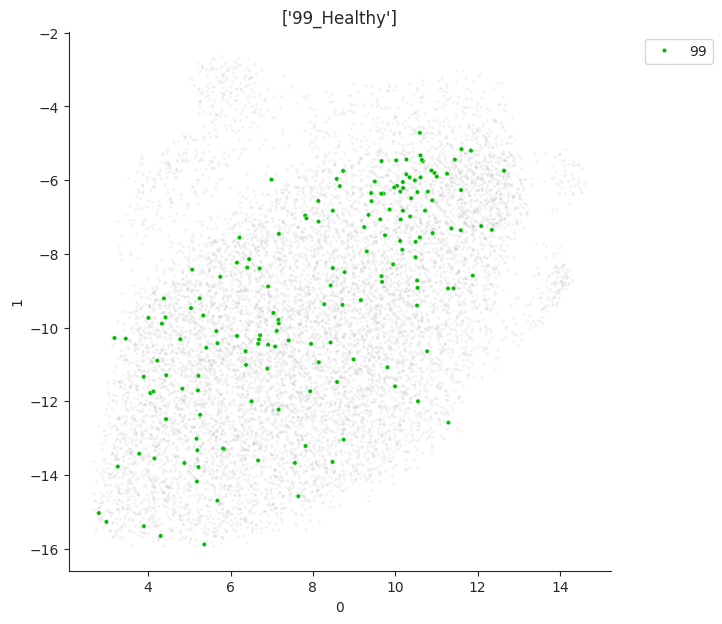

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6070,4.439791,-9.480517,35,control,Diabetic,Diabetic_control,35_control,1,5.0
6072,7.803930,-9.504251,46,control,Diabetic,Diabetic_control,46_control,1,9.0
6076,7.174655,-11.548168,67,control,Diabetic,Diabetic_control,67_control,1,7.0
6078,7.309592,-7.313773,35,control,Diabetic,Diabetic_control,35_control,1,4.0
6079,8.400229,-12.136962,62,control,Diabetic,Diabetic_control,62_control,1,2.0
...,...,...,...,...,...,...,...,...,...
48016,12.594169,-10.339138,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0
48017,11.721320,-6.231086,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0
48019,9.684473,-4.827662,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0


In [446]:
for disease in np.unique(embedding_df_again['patient_id']):
    print(disease)
    plt.figure(figsize=(7, 7))
    masking_condition1=embedding_df_again['patient_id']==disease
    masking_condition2=~embedding_df_again['label_leiden'].isna()
    masking_condition=np.logical_and(masking_condition1,masking_condition2)
    temp_df=embedding_df_again[masking_condition]
    sns.set_style('ticks')
    sns.scatterplot(data=embedding_df_again[~masking_condition],x=0,y=1,s=5,color="gray", alpha=0.09)
    sns.scatterplot(data=embedding_df_again[masking_condition],x=0,y=1,s=10,hue="patient_id",palette='nipy_spectral')
    sns.despine()
    plt.legend(loc='upper right',bbox_to_anchor=(1.2, 1)) 
    np.unique(temp_df['disease'])
    plt.title(disease+'_'+np.unique(temp_df['disease']))
    plt.show()

embedding_df_again

Diabetic


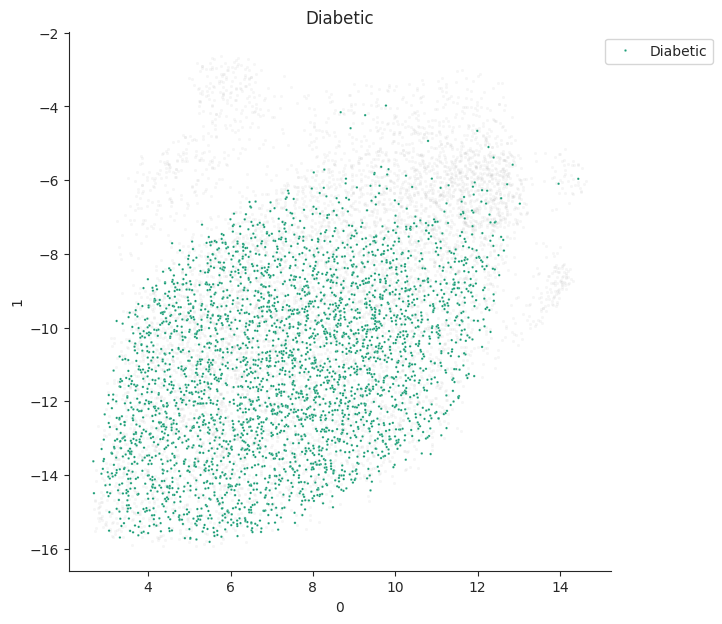

Healthy


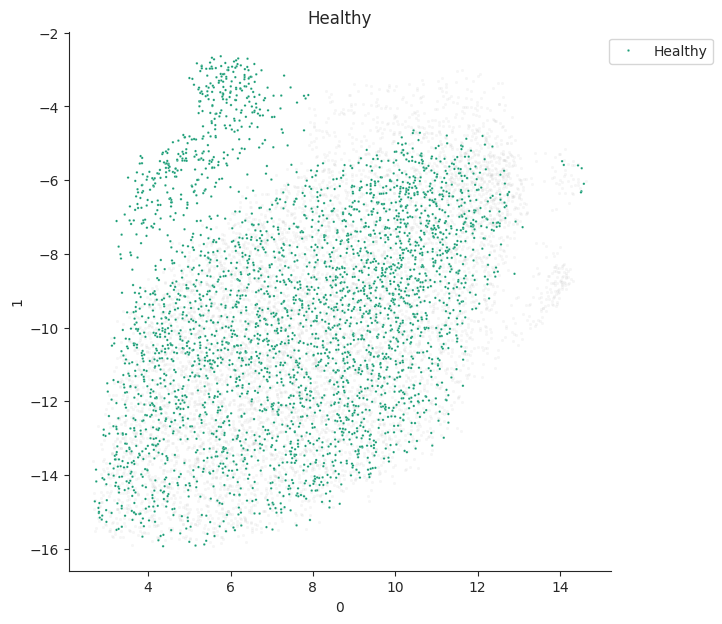

Prediabetic


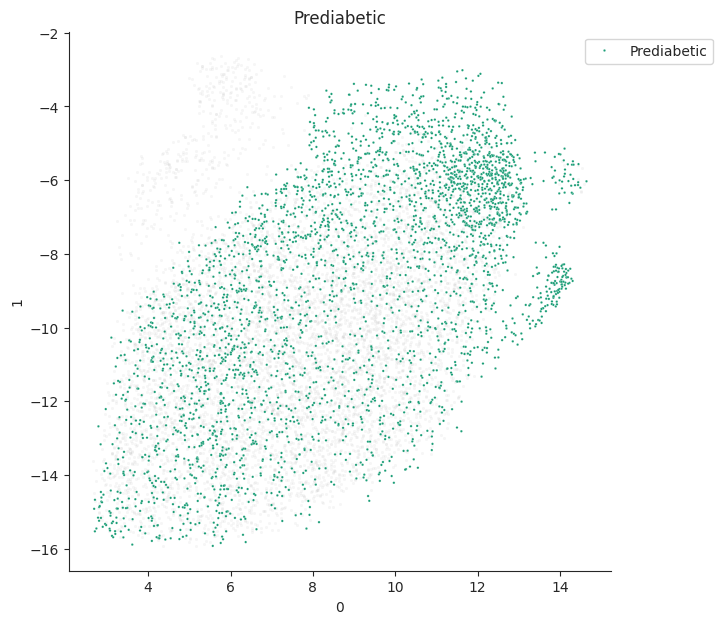

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6070,4.439791,-9.480517,35,control,Diabetic,Diabetic_control,35_control,1,5.0
6072,7.803930,-9.504251,46,control,Diabetic,Diabetic_control,46_control,1,9.0
6076,7.174655,-11.548168,67,control,Diabetic,Diabetic_control,67_control,1,7.0
6078,7.309592,-7.313773,35,control,Diabetic,Diabetic_control,35_control,1,4.0
6079,8.400229,-12.136962,62,control,Diabetic,Diabetic_control,62_control,1,2.0
...,...,...,...,...,...,...,...,...,...
48016,12.594169,-10.339138,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0
48017,11.721320,-6.231086,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0
48019,9.684473,-4.827662,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0


In [447]:
for disease in np.unique(embedding_df_again['disease']):
    print(disease)
    plt.figure(figsize=(7, 7))
    masking_condition1=embedding_df_again['disease']==disease
    masking_condition2=~embedding_df_again['label_leiden'].isna()
    masking_condition=np.logical_and(masking_condition1,masking_condition2)
    
    temp_df=embedding_df_again[embedding_df_again['disease']==disease]
    sns.scatterplot(data=embedding_df_again[~masking_condition],x=0,y=1,s=5,color="gray", alpha=0.07)
    sns.scatterplot(data=embedding_df_again[masking_condition].sample(frac=1).reset_index(drop=True),x=0,y=1,s=3,hue="disease",palette='Dark2')
    sns.despine()
    plt.legend(loc='upper right',bbox_to_anchor=(1.2, 1)) 
    np.unique(temp_df['disease'])
    plt.title(disease)
#     plt.xlim(-2,2)
#     plt.ylim(-2,2)
    plt.show()

embedding_df_again

In [448]:
latent_list_df_lab_control

,min_calliper,max_calliper,smallest_largest_calliper,min_radius,max_radius,med_radius,avg_radius,d25_radius,d75_radius,std_radius,...,HOnumnode,HOstdnodevol,HOtotnodevol,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6061,0.204545,0.275862,0.378003,0.183607,0.242704,0.245949,0.256228,0.185805,0.281898,0.212521,...,0.142857,0.165407,0.304826,64,control,Diabetic,Diabetic_control,64_control,0,NaN
6062,0.363636,0.275862,0.838180,0.324626,0.231668,0.346217,0.342429,0.340785,0.311451,0.064179,...,0.158730,0.101735,0.196701,80,control,Diabetic,Diabetic_control,80_control,0,NaN
6063,0.431818,0.344828,0.814513,0.244645,0.288515,0.402323,0.383062,0.371106,0.378381,0.158905,...,0.142857,0.151178,0.199145,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6064,0.386364,0.293103,0.847144,0.376092,0.233817,0.371747,0.370245,0.373931,0.333451,0.037272,...,0.126984,0.094365,0.172877,46,control,Diabetic,Diabetic_control,46_control,0,NaN
6065,0.340909,0.310345,0.675260,0.249955,0.264302,0.360250,0.361494,0.346743,0.364512,0.161757,...,0.031746,0.413369,0.170434,35,control,Diabetic,Diabetic_control,35_control,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48022,0.318182,0.310345,0.615237,0.295529,0.248750,0.336831,0.333402,0.298178,0.326986,0.119267,...,0.079365,0.078941,0.167379,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0
48023,0.295455,0.241379,0.744760,0.296203,0.182500,0.293063,0.290374,0.291791,0.272718,0.047949,...,0.095238,0.112836,0.059255,82,control,Prediabetic,Prediabetic_control,82_control,1,11.0
48024,0.318182,0.241379,0.817420,0.286397,0.198911,0.314156,0.309154,0.318754,0.282066,0.045865,...,0.063492,0.163286,0.082468,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN
48025,0.340909,0.258621,0.828319,0.342612,0.196079,0.320942,0.317395,0.320711,0.288995,0.028760,...,0.063492,0.118691,0.083690,45,control,Prediabetic,Prediabetic_control,45_control,0,NaN


0


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


  0%|          | 0/50 [00:00<?, ?it/s]/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
  2%|▏         | 1/50 [00:11<09:22, 11.48s/it]/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
  4%|▍         | 2/50 [00:22<08:48, 11.02s/it]/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(
  6%|▌         | 3/50 [00:32<08:29, 10.85s/it]/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/utils/validation.py:2732: UserWarning: X has feature 

<Figure size 600x1000 with 0 Axes>

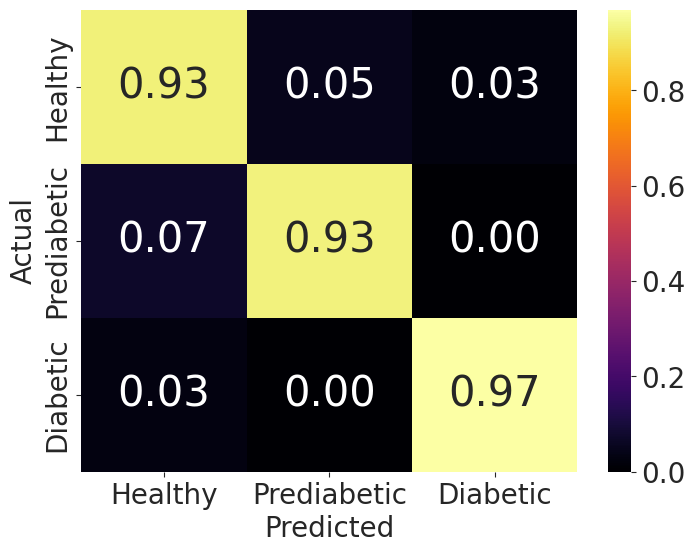

Accuracy (holdout): 0.9423
Accuracy (CV splits): [0.93861527 0.93004996 0.93361884 0.93361884 0.93932905]
Classification Report:
               precision    recall  f1-score   support

    Diabetic       0.90      0.93      0.91       982
     Healthy       0.95      0.93      0.94       984
 Prediabetic       0.98      0.97      0.97      1015

    accuracy                           0.94      2981
   macro avg       0.94      0.94      0.94      2981
weighted avg       0.94      0.94      0.94      2981

Confusion Matrix:
 [[0.92566191 0.04887984 0.02545825]
 [0.06910569 0.93089431 0.        ]
 [0.02955665 0.00098522 0.96945813]]
Permutation CV mean: 0.3325 (p-value=0.0000)
Permutation test mean: 0.3310 (p-value=0.0000)


In [449]:
from sklearn.base import clone
from sklearn.model_selection import train_test_split, cross_val_score, KFold, cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, ConfusionMatrixDisplay
from tqdm import tqdm
def random_forest_classifier(
    data,
    columns_drop,
    column_test,
    i,
    n_permutations=50,
    permutation_random_state=7,
):
    X = data.drop(columns_drop, axis=1)
    y = data[column_test]

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.3, random_state=i
    )

    smote = SMOTE(random_state=42)
    X_res, y_res = smote.fit_resample(X_train, y_train)
    X_res = pd.DataFrame(X_res, columns=X_train.columns)
    y_res = pd.Series(y_res, name=column_test).reset_index(drop=True)

    rf_clf = RandomForestClassifier(
        n_estimators=500, max_features=30, random_state=42, n_jobs=-1
    )
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)
    fold_indices = list(kfold.split(X_res, y_res))

    class_labels = np.sort(y_res.unique())
    X_res_values = X_res.to_numpy()
    y_res_array = y_res.to_numpy()

    fold_overall_scores = []
    fold_class_records = []
    cv_pred_array = np.empty(len(y_res_array), dtype=object)

    for fold_idx, (train_idx, val_idx) in enumerate(fold_indices):
        rf_fold = clone(rf_clf)
        rf_fold.fit(X_res_values[train_idx], y_res_array[train_idx])
        val_pred = rf_fold.predict(X_res_values[val_idx])

        cv_pred_array[val_idx] = val_pred
        fold_overall_scores.append(accuracy_score(y_res_array[val_idx], val_pred))

        fold_conf = confusion_matrix(
            y_res_array[val_idx],
            val_pred,
            labels=class_labels,
            normalize="true",
        )
        for label_idx, label in enumerate(class_labels):
            fold_class_records.append(
                {
                    "fold": fold_idx,
                    "class": label,
                    "accuracy": fold_conf[label_idx, label_idx],
                }
            )

    cv_scores = np.array(fold_overall_scores)
    cv_predictions = pd.Series(cv_pred_array, name="cv_prediction")
    fold_class_accuracy = pd.DataFrame(fold_class_records)

    rf_clf.fit(X_res, y_res)
    y_pred = rf_clf.predict(X_test)
    test_accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred)
    conf_matrix = confusion_matrix(y_test, y_pred, normalize="true")

    importance_df = pd.DataFrame(
        {"Feature": X_res.columns, "Importance": rf_clf.feature_importances_}
    )

    rng = np.random.default_rng(permutation_random_state)
    permuted_cv_scores = np.empty(n_permutations)
    permuted_test_scores = np.empty(n_permutations)
    perm_class_records = []
    perm_overall_records = []

    for perm_idx in tqdm(range(n_permutations)):
        perm_labels = rng.permutation(y_res_array)

        fold_scores = []
        for fold_idx, (train_idx, val_idx) in enumerate(fold_indices):
            rf_perm = clone(rf_clf)
            rf_perm.fit(X_res_values[train_idx], perm_labels[train_idx])
            val_perm_pred = rf_perm.predict(X_res_values[val_idx])

            acc = accuracy_score(perm_labels[val_idx], val_perm_pred)
            fold_scores.append(acc)
            perm_overall_records.append(
                {
                    "permutation": perm_idx,
                    "fold": fold_idx,
                    "accuracy": acc,
                }
            )

            perm_conf = confusion_matrix(
                perm_labels[val_idx],
                val_perm_pred,
                labels=class_labels,
                normalize="true",
            )
            for label_idx, label in enumerate(class_labels):
                perm_class_records.append(
                    {
                        "permutation": perm_idx,
                        "fold": fold_idx,
                        "class": label,
                        "accuracy": perm_conf[label_idx, label_idx],
                    }
                )

        permuted_cv_scores[perm_idx] = np.mean(fold_scores)

        rf_perm_full = clone(rf_clf)
        rf_perm_full.fit(X_res_values, perm_labels)
        perm_test_pred = rf_perm_full.predict(X_test)
        permuted_test_scores[perm_idx] = accuracy_score(y_test, perm_test_pred)

    permutation_summary = {
        "cv_scores": permuted_cv_scores,
        "test_scores": permuted_test_scores,
        "cv_p_value": np.mean(permuted_cv_scores >= cv_scores.mean()),
        "test_p_value": np.mean(permuted_test_scores >= test_accuracy),
        "class_accuracy": pd.DataFrame(perm_class_records),
        "overall_accuracy": pd.DataFrame(perm_overall_records),
    }

    return (
        conf_matrix,
        report,
        importance_df,
        cv_scores,
        test_accuracy,
        cv_predictions,
        fold_class_accuracy,
        permutation_summary,
    )

masking_condition = latent_list_df_lab_control["balanced_sample"] == 1
temp_df = latent_list_df_lab_control[masking_condition]

columns = [
    "patient_id",
    "constriction_size",
    "disease",
    "disease_constric",
    "patient_id_constric",
    "balanced_sample",
    "label_leiden"
]
n_runs = 1

for i in range(n_runs):
    print(i)
    (conf_matrix,
        report,
        importance_df,
        cv_scores,
        test_accuracy,
        cv_predictions,
        fold_class_accuracy,
        permutation_summary,
    ) = random_forest_classifier(
        temp_df, columns, "disease", i, n_permutations=50
    )

    dropped_index = np.where(importance_df["Importance"] < 0.009)
    importance_df_thresholded = importance_df.drop(dropped_index[0], axis=0)
    importance_df_thresholded = importance_df_thresholded.sort_values(
        "Importance", ascending=False
    )

    plt.figure(figsize=(6, 10))
    with plt.style.context(
        {
            "axes.labelsize": 20,
            "xtick.labelsize": 20,
            "ytick.labelsize": 20,
        }
    ):
        plt.figure(figsize=(8, 6))
        sns.heatmap(
            conf_matrix,
            annot=True,
            fmt=".2f",
            cmap="inferno",
            xticklabels=["Healthy", "Prediabetic", "Diabetic"],
            yticklabels=["Healthy", "Prediabetic", "Diabetic"],
            annot_kws={"size": 30},
        )
        plt.xlabel("Predicted")
        plt.ylabel("Actual")
        plt.show()

    print(f"Accuracy (holdout): {test_accuracy:.4f}")
    print(f"Accuracy (CV splits): {cv_scores}")
    print("Classification Report:\n", report)
    print("Confusion Matrix:\n", conf_matrix)

    print(
        f"Permutation CV mean: {permutation_summary['cv_scores'].mean():.4f} "
        f"(p-value={permutation_summary['cv_p_value']:.4f})"
    )
    print(
        f"Permutation test mean: {permutation_summary['test_scores'].mean():.4f} "
        f"(p-value={permutation_summary['test_p_value']:.4f})"
    )

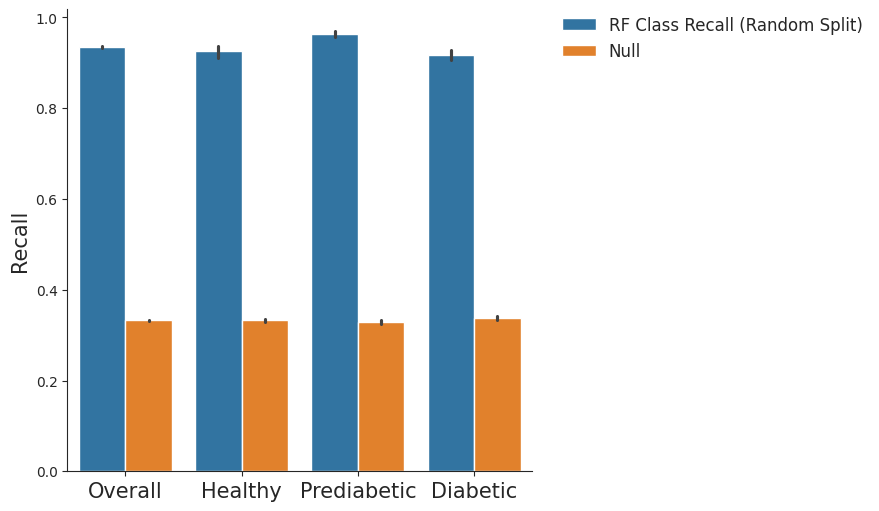

In [450]:
permutation_summary
model_class_df = fold_class_accuracy.copy()
model_class_df["source"] = "RF Class Recall (Random Split)"

perm_class_df = permutation_summary["class_accuracy"].copy()
perm_class_df["source"] = "Null"

model_overall_df = pd.DataFrame(
    {
        "class": ["Overall"] * len(cv_scores),
        "accuracy": cv_scores,
        "source": ["RF Class Recall (Random Split)"] * len(cv_scores),
    }
)

perm_overall_df = permutation_summary["overall_accuracy"].copy()
perm_overall_df["class"] = "Overall"
perm_overall_df["source"] = "Null"

plot_df = pd.concat(
    [model_class_df, perm_class_df, model_overall_df, perm_overall_df],
    ignore_index=True,
)
order = ['Overall', 'Healthy','Prediabetic','Diabetic']
class_order = sorted(fold_class_accuracy["class"].unique().tolist())
class_order.append("Overall")
plot_df["class"] = pd.Categorical(plot_df["class"], categories=class_order, ordered=True)

plt.figure(figsize=(6, 6))
sns.barplot(data=plot_df, x="class", y="accuracy", hue="source", order = order)
plt.ylabel("Recall",fontsize = 15)
plt.xlabel("")
plt.xticks(fontsize = 15)
sns.despine()
plt.title("")
plt.legend(title="", frameon=False,  fontsize=12, borderaxespad=0.0, bbox_to_anchor = (1.05,1))
plt.show()

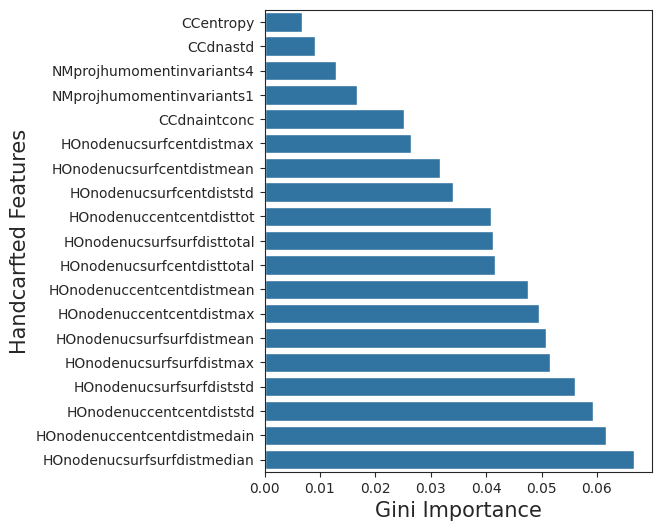

In [451]:
importance_df_sorted = importance_df.sort_values(by="Importance", ascending=True)
importance_df_sorted_top = importance_df_sorted[importance_df_sorted['Importance'] > 0.006]
plt.figure(figsize=(5,6))
sns.barplot(data =importance_df_sorted_top, x = "Importance", y = "Feature")
sns.despine
plt.xlabel('Gini Importance', fontsize = 15)
plt.ylabel('Handcarfted Features', fontsize = 15)
plt.show()

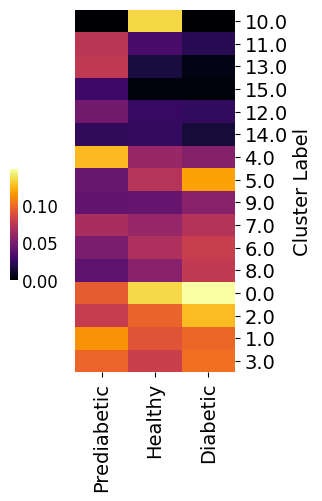

In [511]:
masking_condition2=~embedding_df_again['label_leiden'].isna()
embedding_control_sampled=embedding_df_again[masking_condition2]
embedding_control_sampled

cluster_compressed_pathalogy=embedding_control_sampled.groupby(['label_leiden', 'disease']).size().reset_index(name='count')
table_compressed = cluster_compressed_pathalogy.pivot(index='label_leiden', columns='disease', values='count')
table_compressed = table_compressed.fillna(0)
table_compressed_norm=table_compressed/table_compressed.sum()
table_compressed_norm=table_compressed_norm[['Healthy','Diabetic','Prediabetic']]

ax = sns.clustermap(table_compressed_norm,dendrogram_ratio=0.0001, figsize=(2.5, 5), cmap="inferno",annot=False,cbar_pos=(-0.2, .34, .03,0.4))
ax.ax_heatmap.set_xticklabels(ax.ax_heatmap.get_xticklabels(), rotation=90, horizontalalignment='center',fontsize=14)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0,fontsize=14)
ax.ax_heatmap.set_xlabel('')
ax.ax_heatmap.set_ylabel('Cluster Label',fontsize=14)
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.ax.tick_params(size=0)  # Remove tick lines
# cbar.set_ticks([0.02, 0.12, 0.22])  # Set fewer ticks
cbar.ax.tick_params(labelsize=12)  # Increase the size of tick labels
cbar.outline.set_linewidth(0)  # Make the colorbar outline thicker
cbar.ax.set_aspect(100)  # Adjust the aspect ratio to make the colorbar bigger


#plt.xlabel("Pathology", fontsize=13)
#plt.ylabel("Clusters", fontsize=15)
#plt.xticks(fontsize=14)
plt.show()

In [453]:
embedding_control_sampled

,0,1,patient_id,constriction_size,disease,disease_constric,patient_id_constric,balanced_sample,label_leiden
6070,4.439791,-9.480517,35,control,Diabetic,Diabetic_control,35_control,1,5.0
6072,7.803930,-9.504251,46,control,Diabetic,Diabetic_control,46_control,1,9.0
6076,7.174655,-11.548168,67,control,Diabetic,Diabetic_control,67_control,1,7.0
6078,7.309592,-7.313773,35,control,Diabetic,Diabetic_control,35_control,1,4.0
6079,8.400229,-12.136962,62,control,Diabetic,Diabetic_control,62_control,1,2.0
...,...,...,...,...,...,...,...,...,...
48016,12.594169,-10.339138,37,control,Prediabetic,Prediabetic_control,37_control,1,13.0
48017,11.721320,-6.231086,26,control,Prediabetic,Prediabetic_control,26_control,1,13.0
48019,9.684473,-4.827662,45,control,Prediabetic,Prediabetic_control,45_control,1,12.0
48022,7.526326,-7.411115,37,control,Prediabetic,Prediabetic_control,37_control,1,1.0


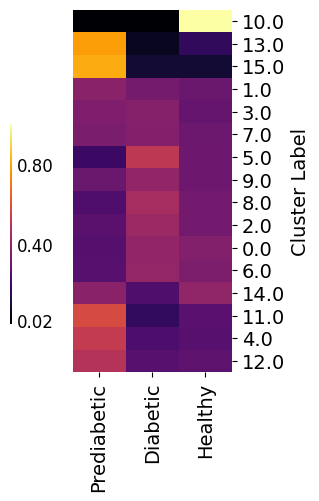

In [514]:
cluster_compressed_pathalogy=embedding_control_sampled.groupby(['label_leiden', 'disease']).size().reset_index(name='count')
table_compressed = cluster_compressed_pathalogy.pivot(index='label_leiden', columns='disease', values='count')
table_compressed_norm = table_compressed.div(table_compressed.sum(axis=1).replace(0, np.nan), axis=0).fillna(0.0)
table_compressed = table_compressed.fillna(0)
ax = sns.clustermap(table_compressed_norm,dendrogram_ratio=0.0001, figsize=(2.5, 5), cmap="inferno",annot=False,cbar_pos=(-0.2, .34, .03,0.4))
ax.ax_heatmap.set_xticklabels(ax.ax_heatmap.get_xticklabels(), rotation=90, horizontalalignment='center',fontsize=14)
ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0,fontsize=14)
ax.ax_heatmap.set_xlabel('')
ax.ax_heatmap.set_ylabel('Cluster Label',fontsize=14)
cbar = ax.ax_heatmap.collections[0].colorbar
cbar.ax.tick_params(size=0)  # Remove tick lines"
cbar.set_ticks([0.02, 0.4, 0.8])  # Set fewer ticks
cbar.ax.tick_params(labelsize=12)  # Increase the size of tick labels
cbar.outline.set_linewidth(0)  # Make the colorbar outline thicker
cbar.ax.set_aspect(100)  # Adjust the aspect ratio to make the colorbar bigger
#plt.suptitle('PBMCs subpopulation \n enrichment of disease stage',y=1.10,fontsize=15)

#plt.xlabel("Pathology", fontsize=13)
#plt.ylabel("Clusters", fontsize=15)
#plt.xticks(fontsize=14)
plt.show()




In [455]:
table_control_pat_spec_vec_list=[]
for pid in np.unique(embedding_control_sampled['patient_id']):
    print(pid)
    masking_condition=embedding_control_sampled['patient_id']==pid
    embedding_control_patient_spec=embedding_control_sampled[masking_condition]
    cluster_control_pathalogy_pat_spec=embedding_control_patient_spec.groupby(['label_leiden', 'disease']).size().reset_index(name='count')
    cluster_control_pathalogy_pat_spec=embedding_control_patient_spec.groupby(['label_leiden', 'disease']).size().reset_index(name='count')
    table_control_pat_spec_vec = cluster_control_pathalogy_pat_spec.pivot(index='disease',columns= 'label_leiden', values='count')
    table_control_pat_spec_vec=table_control_pat_spec_vec/table_control_pat_spec_vec.sum(axis=1)[0]
    table_control_pat_spec_vec['patient_id']=pid
    table_control_pat_spec_vec=table_control_pat_spec_vec.reset_index()
    table_control_pat_spec_vec_list.append(table_control_pat_spec_vec)
 
    

table_control_pat_spec_vec_df=pd.concat(table_control_pat_spec_vec_list, ignore_index=True)
table_control_pat_spec_vec_df=table_control_pat_spec_vec_df.sort_values('disease')
table_control_pat_spec_vec_df.fillna(0, inplace=True)
table_control_pat_spec_vec_df

table_control_pat_spec_vec_df.to_csv('hand_crafted_table_control_pat_spec_vec_df_htmap_1.csv')

103
105
106
107
108
109
110
111
112
113
114
15
2
22
23
26
30
35
37
39
40
41
43
44
45
46
47
48
51
52
55
6
60
61
62
63
64
65
66
67
69
73
74
76
78
80
82
85
86
91
95
96
97
98
99


In [456]:
table_control_pat_spec_vec_df
patients_to_filter = ['6', '48', '43', '47', '91', '41' ,'40', '63', '15', '22', '96','39', '114', '2', '39']
table_control_pat_spec_vec_df_filt = table_control_pat_spec_vec_df[~table_control_pat_spec_vec_df['patient_id'].isin(patients_to_filter)]

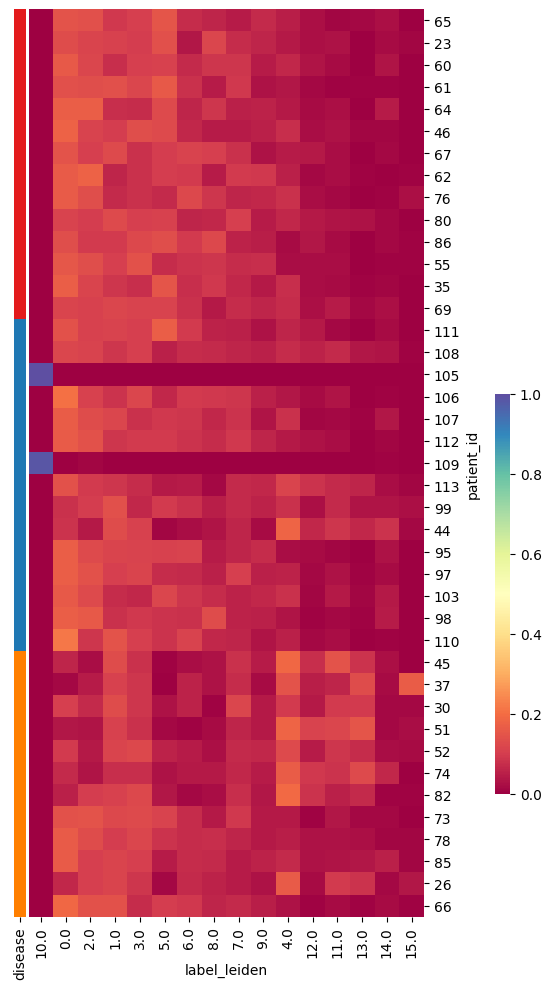

In [479]:
label_to_color = {
    'Diabetic': paired_palette[5],
    'Prediabetic': paired_palette[7],
    'Healthy': paired_palette[1],
}

labels = table_control_pat_spec_vec_df_filt['disease']
order = labels.sort_values().index

data_ordered = table_control_pat_spec_vec_df_filt.loc[order]
data_ordered.index = data_ordered['patient_id']

row_colors = data_ordered['disease'].map(label_to_color)

g = sns.clustermap(
    data_ordered.drop(columns=['disease', 'patient_id']),
    row_cluster=False,
    row_colors=row_colors,
    dendrogram_ratio=(0.005, 0.0001),
    figsize=(5, 10),
    cmap='Spectral',
    cbar_pos=(1, 0.2, 0.03, 0.4),
)
plt.xlabel('')
plt.title('')
plt.show()

In [480]:
import igraph as ig
import leidenalg as la
from sklearn.neighbors import kneighbors_graph
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, KFold, cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from sklearn.metrics import confusion_matrix, accuracy_score,classification_report, ConfusionMatrixDisplay

def random_forest_classifier_leave_one_out(train,test,columns_drop,column_test):
    
    X_train=train.drop(columns_drop,axis=1)
    y_train=train[column_test]

    X_test=test.drop(columns_drop,axis=1)
    y_test=test[column_test]

#    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
    # SMOTE
    smote = SMOTE(random_state=42)
    X_res, y_res = smote.fit_resample(X_train, y_train)


    rf_clf = RandomForestClassifier(n_estimators=300,max_features=20, random_state=42)
    kfold = KFold(n_splits=5, shuffle=True, random_state=42)
    cv_scores = cross_val_score(rf_clf, X_train, y_train, cv=kfold, scoring='accuracy')
    cv_predictions = cross_val_predict(rf_clf, X_train, y_train, cv=kfold)

    rf_clf.fit(X_train, y_train)
    y_pred = rf_clf.predict(X_test)
    global_importances = pd.Series(rf_clf.feature_importances_, index=X_train.columns)
    global_importances.sort_values(ascending=True, inplace=True)
    global_importances.plot.barh(color='green')
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.title("Global Feature Importance - Built-in Method")
    
    return(y_pred)
sns.reset_defaults()
from sklearn.metrics import recall_score, roc_auc_score, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import check_random_state
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
import numpy as np

def global_cv_vs_permutation_null_by_class(
    df,
    target: str,
    drop_cols,
    class_labels,
    cv_splits: int = 5,
    n_permutations: int = 200,
    random_state: int = 42,
    n_est: int = 300,
    max_feat: int = 20,
):
    """
    Multiclass observed CV metrics vs permutation null (label-shuffled).
    Returns:
      results: dict with overall + per-class observed metrics and null distributions
      y_true: 1D array of true labels (aligned to rows in df)
      y_pred: 1D array of CV out-of-sample predicted labels
      y_proba: 2D array of CV out-of-sample class probabilities (n_samples x n_classes)
      classes: array of class labels in column order of y_proba
    """
    X = df.drop(columns=drop_cols, axis=1).copy()
    y = df[target].values
    classes = np.array(class_labels)  # preserve desired order if provided

    pipe = Pipeline(steps=[
        ("smote", SMOTE(random_state=random_state)),
        ("rf", RandomForestClassifier(
            n_estimators=n_est,
            max_features=max_feat,
            random_state=random_state
        ))
    ])

    cv = StratifiedKFold(n_splits=cv_splits, shuffle=True, random_state=random_state)
    rng = check_random_state(random_state)

    # ---- Observed CV predictions (each sample predicted exactly once, out-of-sample)
    y_pred = cross_val_predict(pipe, X, y, cv=cv, method="predict")
    y_proba = cross_val_predict(pipe, X, y, cv=cv, method="predict_proba")

    # Align class order in y_proba columns to `classes`
    # (cross_val_predict uses the estimator's classes_; enforce reordering just in case)
    # Fit once to get the learned class order
    pipe.fit(X, y)
    learned_order = pipe.named_steps["rf"].classes_
    print(learned_order)
    # If the learned class order differs, reorder columns accordingly
    if not np.array_equal(learned_order, classes):
        # map from learned_order -> position in `classes`
        reorder_idx = [np.where(classes == c)[0][0] for c in learned_order]
        # Build y_proba in the canonical `classes` order
        y_proba_aligned = np.zeros_like(y_proba)
        for src_j, cls in enumerate(learned_order):
            dst_j = np.where(classes == cls)[0][0]
            y_proba_aligned[:, dst_j] = y_proba[:, src_j]
        y_proba = y_proba_aligned

    results = {}

    # ---- Overall metrics
    acc_obs = accuracy_score(y, y_pred)
    y_bin = label_binarize(y, classes=classes)
    auc_macro_obs = roc_auc_score(y_bin, y_proba, multi_class="ovr", average="macro")

    results["overall"] = {
        "acc_obs": acc_obs,
        "auc_macro_obs": auc_macro_obs,
        "acc_perm": [],
        "auc_macro_perm": []
    }

    # ---- Per-class (OvR) metrics
    for i, c in enumerate(classes):
        y_true_bin = (y == c).astype(int)
        y_pred_bin = (y_pred == c).astype(int)
        recall_c = recall_score(y_true_bin, y_pred_bin)  # class-wise recall
        auc_c = roc_auc_score(y_true_bin, y_proba[:, i]) # OvR AUC for class c
        results[f"class:{c}"] = {
            "recall_obs": recall_c,
            "auc_obs": auc_c,
            "recall_perm": [],
            "auc_perm": []
        }

    # ---- Permutation null distributions
    for b in range(n_permutations):
        y_perm = rng.permutation(y)
        y_pred_perm = cross_val_predict(pipe, X, y_perm, cv=cv, method="predict")
        y_proba_perm = cross_val_predict(pipe, X, y_perm, cv=cv, method="predict_proba")

        # Overall
        results["overall"]["acc_perm"].append(accuracy_score(y_perm, y_pred_perm))
        y_bin_perm = label_binarize(y_perm, classes=classes)
        results["overall"]["auc_macro_perm"].append(
            roc_auc_score(y_bin_perm, y_proba_perm, multi_class="ovr", average="macro")
        )

        # Per-class
        for i, c in enumerate(classes):
            y_true_bin = (y_perm == c).astype(int)
            y_pred_bin = (y_pred_perm == c).astype(int)
            results[f"class:{c}"]["recall_perm"].append(
                recall_score(y_true_bin, y_pred_bin)
            )
            results[f"class:{c}"]["auc_perm"].append(
                roc_auc_score(y_true_bin, y_proba_perm[:, i])
            )

    # Convert lists to arrays
    for k in results.keys():
        for key in results[k]:
            if isinstance(results[k][key], list):
                results[k][key] = np.array(results[k][key])

    return results, y, y_pred, y_proba, classes

from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

def plot_multiclass_roc_from_cv(y_true, y_proba, classes, title="Multiclass ROC (CV out-of-sample)"):
    # One-vs-rest ROC per class + micro-average
    from sklearn.preprocessing import label_binarize
    y_bin = label_binarize(y_true, classes=classes)

    plt.figure(figsize=(5,5))
    for i, c in enumerate(classes):
        fpr, tpr, _ = roc_curve(y_bin[:, i], y_proba[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, lw=2, label=f"{c} (AUC={roc_auc:.2f})")

    # micro-average
    fpr, tpr, _ = roc_curve(y_bin.ravel(), y_proba.ravel())
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, 'k--', lw=1.5, label=f"micro-average (AUC={roc_auc:.2f})")

    plt.plot([0,1],[0,1],'k:', lw=1)
    plt.xlabel("False Positive Rate", fontsize=12)
    plt.ylabel("True Positive Rate", fontsize=12)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.title(title, pad=20)
    sns.despine()
    plt.legend(frameon=False,  fontsize=12, borderaxespad=0.0)
    plt.tight_layout()
    plt.ylim(0,1)
    plt.show()

def plot_cv_vs_null_by_class(results, class_labels, title="Observed CV vs Null by Class"):
    labels, obs_acc, null_acc, null_acc_err = [], [], [], []
    obs_auc, null_auc, null_auc_err = [], [], []

    # Overall first
    labels.append("Overall")
    obs_acc.append(results["overall"]["acc_obs"])
    null_acc.append(np.mean(results["overall"]["acc_perm"]))
    null_acc_err.append(np.std(results["overall"]["acc_perm"]))
    obs_auc.append(results["overall"]["auc_macro_obs"])
    null_auc.append(np.mean(results["overall"]["auc_macro_perm"]))
    null_auc_err.append(np.std(results["overall"]["auc_macro_perm"]))

    # Classes
    for c in class_labels:
        r = results[f"class:{c}"]
        labels.append(str(c))
        obs_acc.append(r["recall_obs"])
        null_acc.append(np.mean(r["recall_perm"]))
        null_acc_err.append(np.std(r["recall_perm"]))
        obs_auc.append(r["auc_obs"])
        null_auc.append(np.mean(r["auc_perm"]))
        null_auc_err.append(np.std(r["auc_perm"]))

    x = np.arange(len(labels))
    width = 0.35

    # Accuracy/Recall plot
    plt.figure(figsize=(5,6))
    plt.bar(x - width/2, obs_acc, width, label="Observed Recall/Accuracy")
    plt.bar(x + width/2, null_acc, width, yerr=null_acc_err, capsize=4, label="Null Recall/Accuracy")
    plt.xticks(x, labels, rotation=30, fontsize=15)
    plt.yticks(fontsize=15)
    plt.ylabel("Score", fontsize=15)
    plt.xlabel("Pathology and Overall", fontsize=15)
    plt.title(title + " (Recall / Accuracy)", pad=20)
    plt.legend(frameon=False,  fontsize=15, borderaxespad=0.0)
    sns.despine()
    plt.tight_layout()
    plt.ylim(0,1)
    plt.show()

    # AUC plot
    plt.figure(figsize=(5,6))
    plt.bar(x - width/2, obs_auc, width, label="Observed AUC")
    plt.bar(x + width/2, null_auc, width, yerr=null_auc_err, capsize=4, label="Null AUC")
    plt.xticks(x, labels, rotation=30, fontsize=15)
    plt.yticks(fontsize=15)
    plt.ylabel("ROC-AUC", fontsize=15)
    plt.xlabel("Pathology and Overall", fontsize=15)
    plt.title(title + " (OvR AUC)", pad=20)
    # remove the legend border and background
    plt.legend(frameon=False,  fontsize=15, borderaxespad=0.0)
    sns.despine()
    plt.tight_layout()
    plt.ylim(0,1)
    plt.show()

In [481]:
table_control_pat_spec_vec_df_filt
results, y_true, y_pred, y_proba, classes = global_cv_vs_permutation_null_by_class(
    df=table_control_pat_spec_vec_df_filt,
    target='disease',
    drop_cols=['patient_id','disease'],
    class_labels=["Healthy","Diabetic","Prediabetic"],
    cv_splits=5,
    n_permutations=50,
    random_state=42
)




/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

['Diabetic' 'Healthy' 'Prediabetic']


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

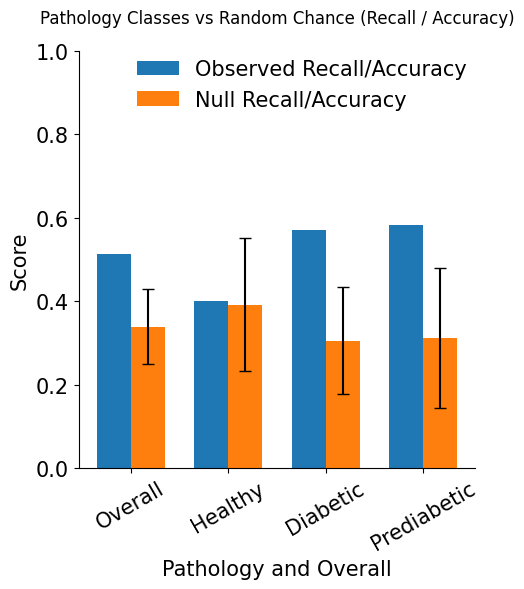

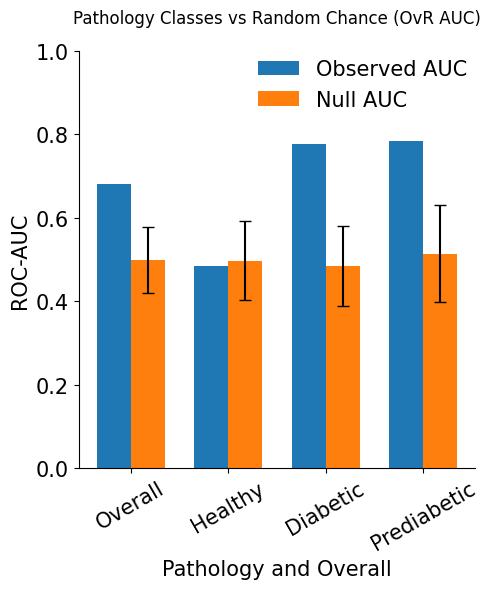

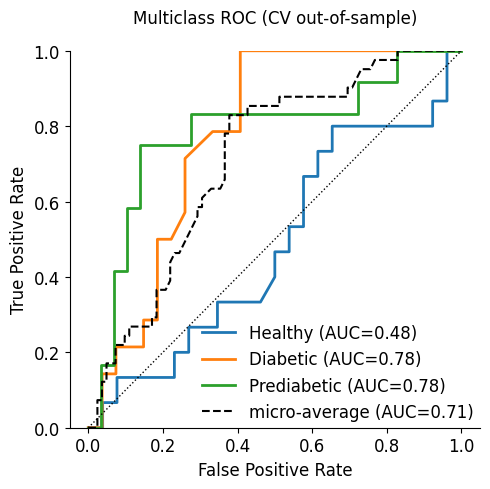

In [608]:
plot_cv_vs_null_by_class(results, ["Healthy","Diabetic","Prediabetic"],title="Pathology Classes vs Random Chance")

plot_multiclass_roc_from_cv(y_true, y_proba, classes)

In [500]:
true_label_mat=[]
pid_pred_mat=[]
patient_id_mat = []
for patient_id in table_control_pat_spec_vec_df_filt['patient_id'].unique():
    print(patient_id)
    this_patient_enrichement =  table_control_pat_spec_vec_df_filt[table_control_pat_spec_vec_df_filt['patient_id']==patient_id]
    other_patients_enrichement = table_control_pat_spec_vec_df_filt[table_control_pat_spec_vec_df_filt['patient_id']!=patient_id]
    [pid_pred]=random_forest_classifier_leave_one_out(other_patients_enrichement,this_patient_enrichement,['patient_id','disease'],'disease')

    true_label_mat.append(this_patient_enrichement['disease'].tolist())    
    pid_pred_mat.append(pid_pred)
    patient_id_mat.append(patient_id)



65


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


35


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


55


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


86


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


80


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


76


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


69


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


67


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


46


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


64


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


62


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


61


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


60


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


23


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


98


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


103


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


97


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


95


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


44


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


99


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


113


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


110


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


109


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


111


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


112


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


107


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


106


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


105


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


108


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


85


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


78


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


74


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


73


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


82


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


26


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


52


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


51


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


30


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


37


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


45


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


66


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


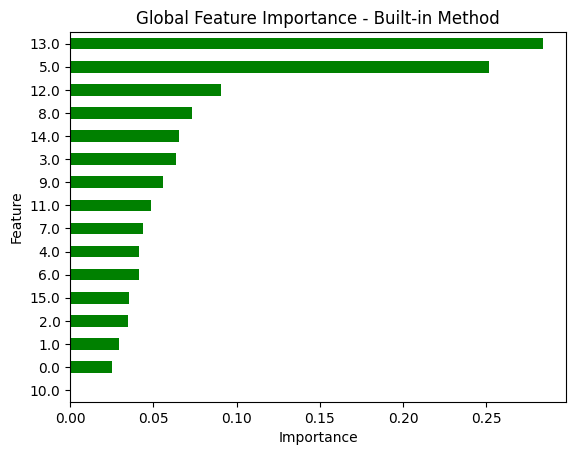

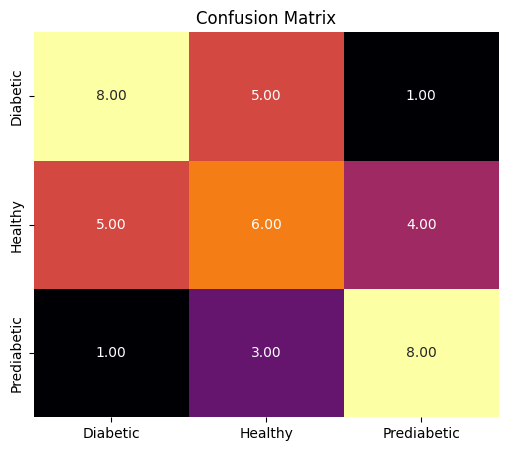

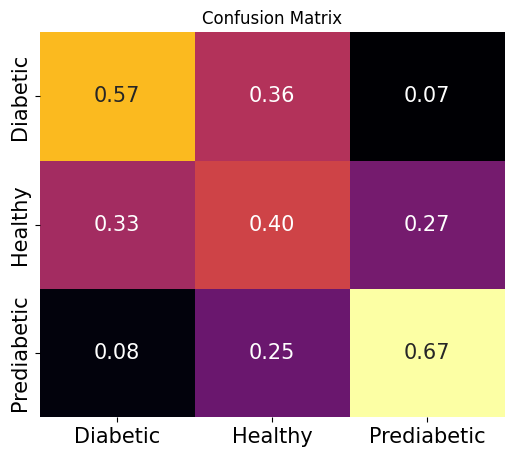

In [501]:
confusion_matrix_here = confusion_matrix(true_label_mat, pid_pred_mat)
confusion_matrix_df = pd.DataFrame(confusion_matrix_here, index=['Diabetic','Healthy', 'Prediabetic'], columns=['Diabetic','Healthy',  'Prediabetic'])
confusion_matrix_df
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix_df, annot=True, fmt='.2f', cmap='inferno', cbar=False)
plt.title('Confusion Matrix')
plt.show()

confusion_matrix_here = confusion_matrix(true_label_mat, pid_pred_mat, normalize= "true")
confusion_matrix_df = pd.DataFrame(confusion_matrix_here, index=['Diabetic','Healthy', 'Prediabetic'], columns=['Diabetic','Healthy',  'Prediabetic'])
confusion_matrix_df
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix_df, annot=True, fmt='.2f', cmap='inferno', cbar=False, annot_kws={"fontsize": 15})
plt.title('Confusion Matrix')
plt.yticks(fontsize = 15)
plt.xticks(fontsize = 15)
plt.show()

In [506]:
print(len(pid_pred_mat))
print(len(patient_id_mat))
print(len(true_label_mat))
pid_pred_mat

41
41
41


['Diabetic',
 'Diabetic',
 'Healthy',
 'Diabetic',
 'Prediabetic',
 'Healthy',
 'Healthy',
 'Healthy',
 'Diabetic',
 'Diabetic',
 'Healthy',
 'Diabetic',
 'Diabetic',
 'Diabetic',
 'Healthy',
 'Diabetic',
 'Healthy',
 'Diabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Healthy',
 'Healthy',
 'Diabetic',
 'Diabetic',
 'Healthy',
 'Diabetic',
 'Healthy',
 'Prediabetic',
 'Healthy',
 'Healthy',
 'Prediabetic',
 'Diabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Prediabetic',
 'Healthy']

In [508]:
true_vs_pred = pd.DataFrame({'patient_id': patient_id_mat, 'prediction': pid_pred_mat,'disease': true_label_mat})
true_vs_pred
true_vs_pred["disease"] = true_vs_pred["disease"].apply(
    lambda x: x[0] if isinstance(x, (list, tuple)) else x
)
true_vs_pred

pd_ht_map = table_control_pat_spec_vec_df_filt.merge(true_vs_pred, on =['patient_id','disease'])
pd_ht_map

,disease,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,11.0,12.0,13.0,14.0,patient_id,10.0,15.0,prediction
0,Diabetic,0.147541,0.090164,0.139344,0.102459,0.049180,0.151639,0.073770,0.045082,0.061475,0.069672,0.008197,0.024590,0.012295,0.024590,65,0.000000,0.000000,Diabetic
1,Diabetic,0.168033,0.086066,0.114754,0.077869,0.077869,0.151639,0.077869,0.065574,0.090164,0.040984,0.016393,0.020492,0.004098,0.008197,35,0.000000,0.000000,Diabetic
2,Diabetic,0.155556,0.102222,0.133333,0.142222,0.022222,0.071111,0.084444,0.071111,0.088889,0.075556,0.022222,0.022222,0.000000,0.004444,55,0.000000,0.004444,Healthy
3,Diabetic,0.134146,0.097561,0.097561,0.121951,0.018293,0.134146,0.097561,0.054878,0.121951,0.048780,0.018293,0.036585,0.000000,0.012195,86,0.000000,0.006098,Diabetic
4,Diabetic,0.110656,0.127049,0.098361,0.102459,0.065574,0.106557,0.061475,0.102459,0.065574,0.045082,0.032787,0.040984,0.028689,0.012295,80,0.000000,0.000000,Prediabetic
5,Diabetic,0.163934,0.069672,0.135246,0.081967,0.081967,0.069672,0.122951,0.061475,0.086066,0.065574,0.012295,0.020492,0.000000,0.004098,76,0.000000,0.024590,Healthy
6,Diabetic,0.114754,0.118852,0.106557,0.110656,0.073770,0.110656,0.081967,0.073770,0.040984,0.061475,0.045082,0.024590,0.012295,0.024590,69,0.000000,0.000000,Healthy
7,Diabetic,0.147541,0.127049,0.102459,0.081967,0.045082,0.098361,0.110656,0.081967,0.102459,0.028689,0.020492,0.040984,0.000000,0.012295,67,0.000000,0.000000,Healthy
8,Diabetic,0.176230,0.098361,0.110656,0.135246,0.077869,0.127049,0.065574,0.045082,0.045082,0.053279,0.028689,0.020492,0.008197,0.008197,46,0.000000,0.000000,Diabetic
9,Diabetic,0.168033,0.077869,0.168033,0.073770,0.040984,0.127049,0.061475,0.053279,0.086066,0.057377,0.024590,0.016393,0.000000,0.045082,64,0.000000,0.000000,Diabetic


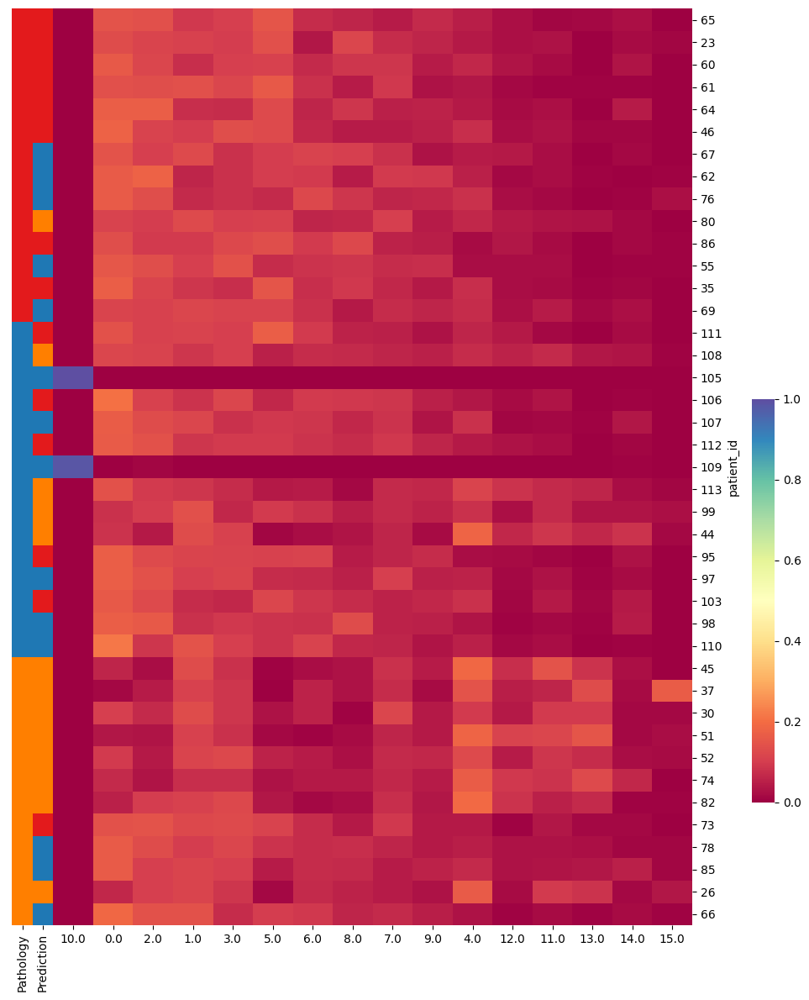

In [509]:
label_to_color = {
    'Diabetic': paired_palette[5],
    'Prediabetic': paired_palette[7],
    'Healthy': paired_palette[1],
}

labels = pd_ht_map['disease']
order = labels.sort_values().index

data_ordered = pd_ht_map.loc[order]
data_ordered.index = data_ordered['patient_id']

row_colors = data_ordered['disease'].map(label_to_color),data_ordered['prediction'].map(label_to_color)
row_colors = pd.DataFrame({
    "Pathology": data_ordered["disease"].map(label_to_color),
    "Prediction": data_ordered["prediction"].map(label_to_color),
}, index=data_ordered.index)
g = sns.clustermap(
    data_ordered.drop(columns=['disease', 'patient_id','prediction']),
    row_cluster=False,
    row_colors=row_colors,
    dendrogram_ratio=(0.005, 0.0001),
    figsize=(9, 12),
    cmap='Spectral',
    cbar_pos=(1, 0.2, 0.03, 0.4),
)
plt.title('')
plt.show()

98


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


103


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


97


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


95


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


44


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


99


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


113


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


110


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


109


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


111


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


112


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


107


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


106


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


105


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


108


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


85


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


78


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


74


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


73


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


82


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


26


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


52


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


51


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


30


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


37


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


45


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


66


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


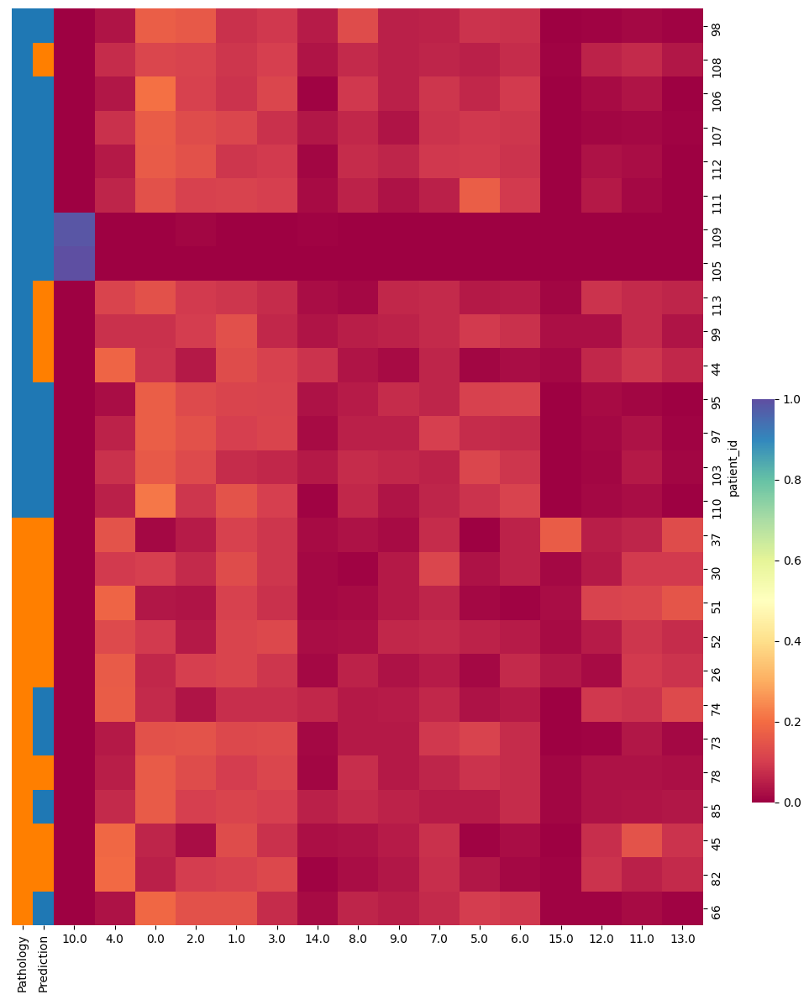

65


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


35


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


55


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


86


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


80


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


76


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


69


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


67


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


46


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


64


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


62


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


61


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


60


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


23


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


85


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


78


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


74


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


73


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


82


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


26


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


52


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


51


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


30


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


37


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


45


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


66


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


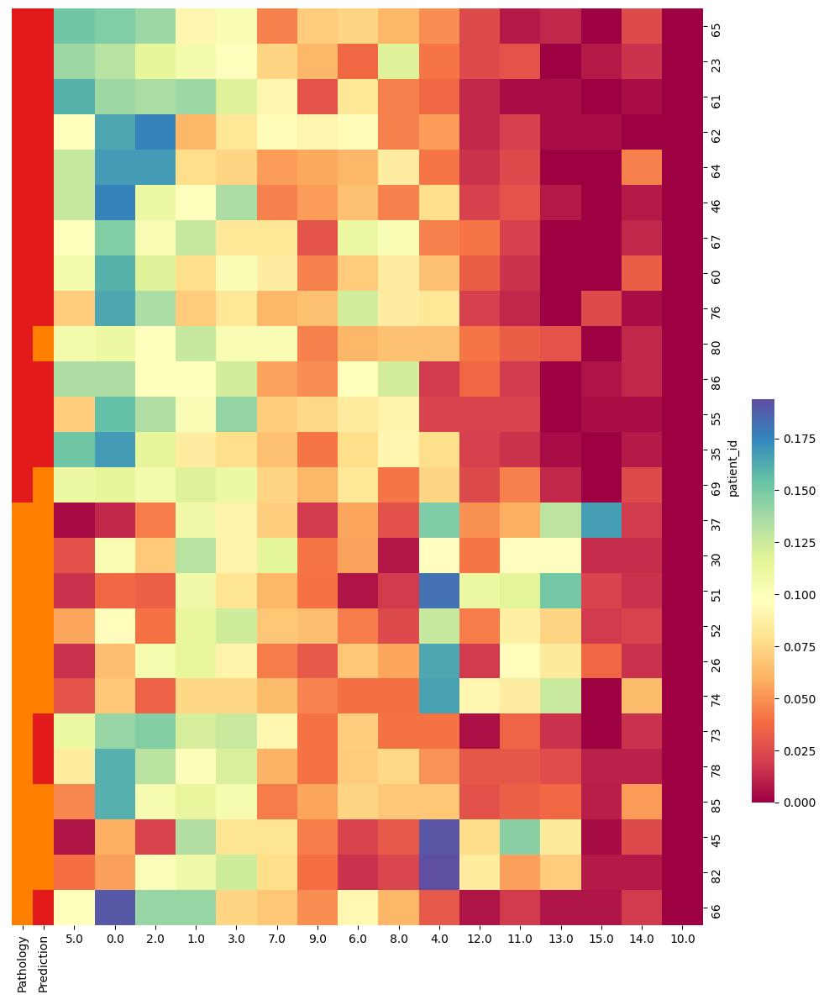

65


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


35


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


55


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


86


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


80


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


76


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


69


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


67


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


46


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


64


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


62


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


61


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


60


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


23


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


98


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


103


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


97


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


95


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


44


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


99


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


113


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


110


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


109


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


111


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


112


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


107


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


106


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


105


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


108


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(


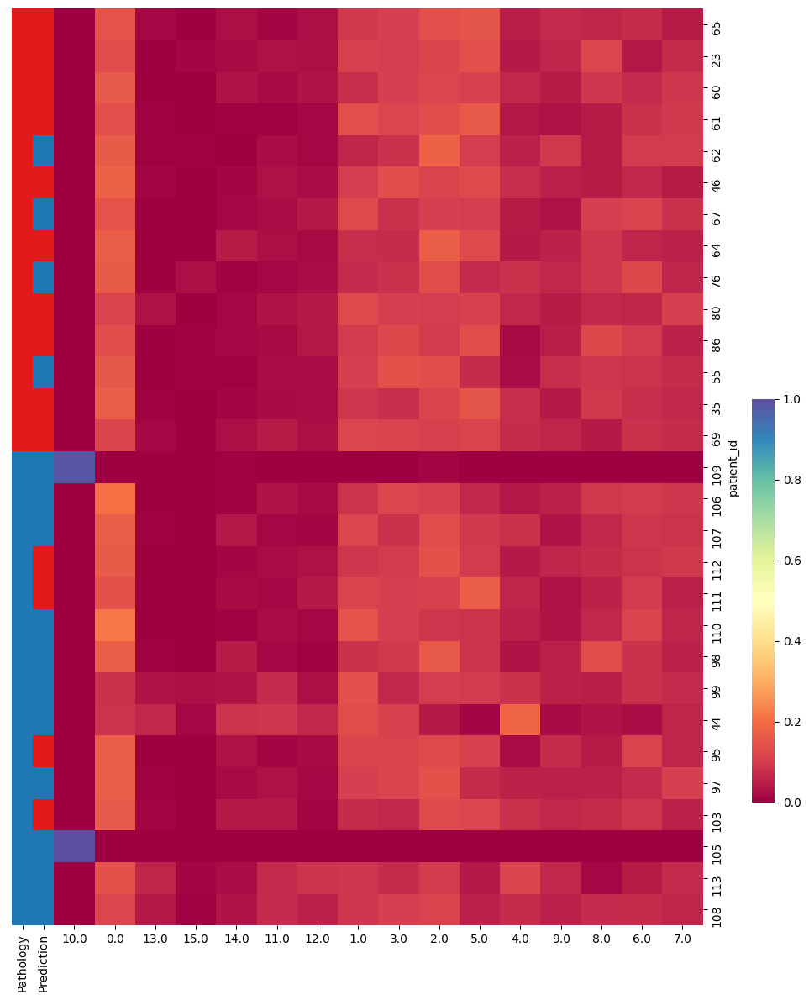

In [510]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import KFold
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

def random_forest_classifier_leave_one_out(
    train_df,
    test_df,
    columns_drop,
    column_test,
    *,
    n_estimators=300,
    max_features=20,
    random_state=42,
):
    X_train = train_df.drop(columns_drop, axis=1)
    y_train = train_df[column_test]

    X_test = test_df.drop(columns_drop, axis=1)
    y_test = test_df[column_test]

    smote = SMOTE(random_state=random_state)
    X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

    X_resampled = pd.DataFrame(X_resampled, columns=X_train.columns)
    y_resampled = pd.Series(y_resampled, name=column_test).reset_index(drop=True)

    rf_clf = RandomForestClassifier(
        n_estimators=n_estimators,
        max_features=max_features,
        random_state=random_state,
        n_jobs=-1,
    )
    rf_clf.fit(X_resampled, y_resampled)

    y_pred = rf_clf.predict(X_test)
    y_proba = rf_clf.predict_proba(X_test)

    feature_importances = pd.Series(
        rf_clf.feature_importances_,
        index=X_resampled.columns,
        name="importance",
    ).sort_values(ascending=False)

    return {
        "predictions": y_pred,
        "probabilities": y_proba,
        "classes": rf_clf.classes_,
        "feature_importance": feature_importances,
    }


true_label_mat = []
pid_pred_mat = []
run_type = []
patient_id_list = []

feature_importance_records = []
probability_records = []

two_way_enrichement = (
    table_control_pat_spec_vec_df_filt.copy()
)

for disease_here in two_way_enrichement["disease"].unique():
    subset = two_way_enrichement[
        two_way_enrichement["disease"] != disease_here
    ]
    labels = subset["disease"].unique()
    patient_id_list_this_run = []
    true_label_mat_this_run = []
    pid_pred_mat_this_run = [] 

    for patient_id in subset["patient_id"].unique():
        print(patient_id)
        test_rows = subset[subset["patient_id"] == patient_id]
        train_rows = subset[subset["patient_id"] != patient_id]

        result = random_forest_classifier_leave_one_out(
            train_rows,
            test_rows,
            ["patient_id", "disease"],
            "disease",
        )

        # Predictions / probabilities (usually a single row per patient)
        true_label = test_rows["disease"].iloc[0]
        pred_label = result["predictions"][0]
        class_probs = result["probabilities"][0]

        true_label_mat.append(true_label)
        pid_pred_mat.append(pred_label)
        run_type.append(f"{labels[0]} vs {labels[1]}")
        patient_id_list.append(patient_id)

        probability_entry = {
            "patient_id": patient_id,
            "run_type": f"{labels[0]} vs {labels[1]}",
            "true_label": true_label,
            "pred_label": pred_label,
        }
        probability_entry.update(
            {
                f"prob_{cls}": prob
                for cls, prob in zip(result["classes"], class_probs)
            }
        )
        probability_records.append(probability_entry)

        importance_series = result["feature_importance"]
        feature_importance_records.extend(
            {
                "patient_id": patient_id,
                "run_type": f"{labels[0]} vs {labels[1]}",
                "feature": feature_name,
                "importance": importance_value,
            }
            for feature_name, importance_value in importance_series.items()
        )
        patient_id_list_this_run.append(patient_id)
        true_label_mat_this_run.append(true_label)
        pid_pred_mat_this_run.append(pred_label)

    true_vs_pred = pd.DataFrame({'patient_id': patient_id_list_this_run, 'prediction': pid_pred_mat_this_run,'disease': true_label_mat_this_run})
    true_vs_pred
    true_vs_pred["disease"] = true_vs_pred["disease"].apply(
        lambda x: x[0] if isinstance(x, (list, tuple)) else x
    )
    true_vs_pred

    pd_ht_map = subset.merge(true_vs_pred, on =['patient_id','disease'])
    label_to_color = {
        'Diabetic': paired_palette[5],
        'Prediabetic': paired_palette[7],
        'Healthy': paired_palette[1],
    }

    labels = pd_ht_map['disease']
    order = labels.sort_values().index

    data_ordered = pd_ht_map.loc[order]
    data_ordered.index = data_ordered['patient_id']

    row_colors = data_ordered['disease'].map(label_to_color),data_ordered['prediction'].map(label_to_color)
    row_colors = pd.DataFrame({
        "Pathology": data_ordered["disease"].map(label_to_color),
        "Prediction": data_ordered["prediction"].map(label_to_color),
    }, index=data_ordered.index)
    g = sns.clustermap(
        data_ordered.drop(columns=['disease', 'patient_id','prediction']),
        row_cluster=False,
        row_colors=row_colors,
        dendrogram_ratio=(0.005, 0.0001),
        figsize=(9, 12),
        cmap='Spectral',
        cbar_pos=(1, 0.2, 0.03, 0.4),
    )
    plt.title('')
    plt.show()



probability_df = pd.DataFrame(probability_records)
feature_importance_df = pd.DataFrame(feature_importance_records)

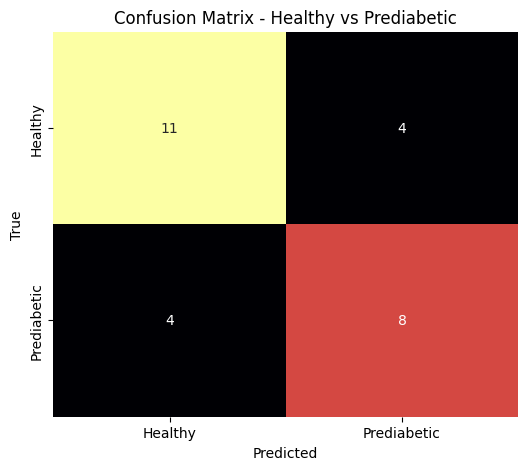

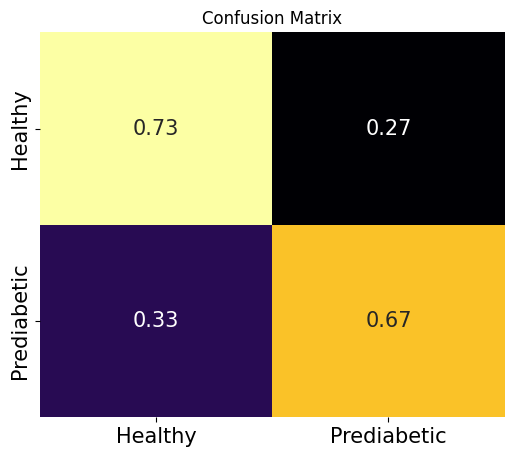

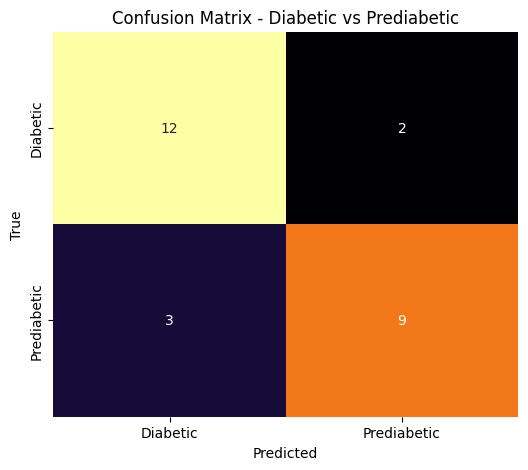

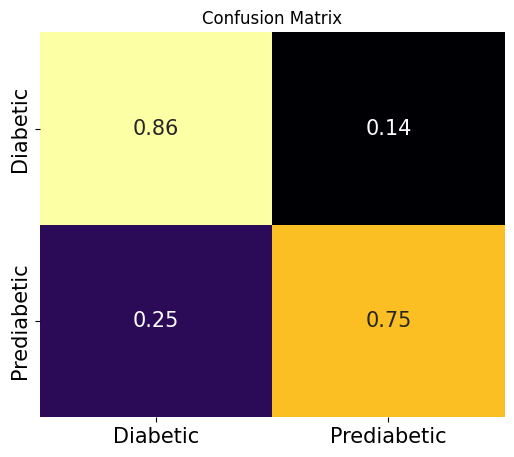

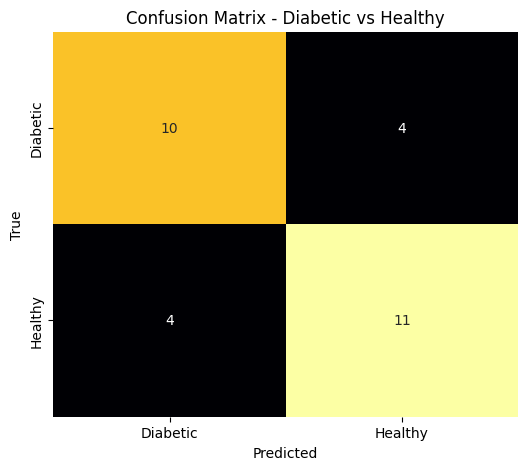

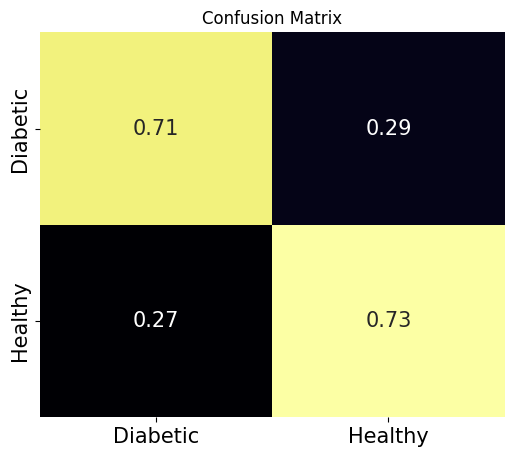

In [464]:
from sklearn.metrics import confusion_matrix, accuracy_score,classification_report, ConfusionMatrixDisplay


two_way_predictions = pd.DataFrame({'true':true_label_mat,'pred':pid_pred_mat,'run_type':run_type,'patient_id':patient_id_list})

for cm in two_way_predictions['run_type'].unique():
    cm_split = cm.split(' vs ')
    true_label_mat_filt = two_way_predictions['true'][two_way_predictions['run_type']==cm]
    pid_pred_mat_filt = two_way_predictions['pred'][two_way_predictions['run_type']==cm]
    confusion_matrix_here = confusion_matrix(true_label_mat_filt, pid_pred_mat_filt)
    confusion_matrix_df = pd.DataFrame(confusion_matrix_here, index=[cm_split[0],cm_split[1]], columns=[cm_split[0],cm_split[1]])
    confusion_matrix_df
    plt.figure(figsize=(6,5))
    sns.heatmap(confusion_matrix_df, annot=True, fmt='d', cmap='inferno', cbar=False)
    plt.title('Confusion Matrix - ' + str(cm))
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()
    confusion_matrix_here_norm = confusion_matrix(true_label_mat_filt, pid_pred_mat_filt, normalize= "true")
    confusion_matrix_df = pd.DataFrame(confusion_matrix_here_norm, index=[cm_split[0],cm_split[1]], columns=[cm_split[0],cm_split[1]])
    confusion_matrix_df
    plt.figure(figsize=(6,5))
    sns.heatmap(confusion_matrix_df, annot=True, fmt='.2f', cmap='inferno', cbar=False, annot_kws={"fontsize": 15})
    plt.title('Confusion Matrix')
    plt.yticks(fontsize = 15)
    plt.xticks(fontsize = 15)
    plt.show()


In [465]:
from sklearn.metrics import recall_score, roc_auc_score, accuracy_score
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils import check_random_state
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
import numpy as np
import pandas as pd

def binary_cv_vs_permutation_null(
    df: pd.DataFrame,
    target: str,
    drop_cols,
    pos_label,                  # e.g. "T2D" (required)
    neg_label=None,             # e.g. "Prediabetes" (optional if dataset is already binary)
    cv_splits: int = 5,
    n_permutations: int = 200,
    random_state: int = 42,
    n_est: int = 300,
    max_feat="sqrt",
    smote_k: int = 3,
):
    """
    Binary observed CV metrics vs permutation null using *named* class labels.
    Returns:
      results: dict with observed metrics and null distributions
      y_true:  original labels (in df order, filtered to the two classes)
      y_pred:  CV out-of-sample predicted labels (same label names)
      y_proba_pos: CV out-of-sample P(pos_label)
      pos_label, neg_label: the label names used
    """
    # Keep only the columns you want as features
    X = df.drop(columns=drop_cols, axis=1).copy()
    y = df[target].values

    # Determine which two labels are used
    uniq = pd.unique(y)
    if pos_label not in uniq:
        raise ValueError(f"pos_label={pos_label!r} not found in labels {uniq.tolist()}.")
    if neg_label is None:
        # If exactly two classes, pick the other as negative; else require explicit neg_label
        if len(uniq) == 2:
            neg_label = next(lbl for lbl in uniq if lbl != pos_label)
        else:
            raise ValueError(
                f"Dataset has >2 classes {uniq.tolist()}. "
                f"Please specify neg_label explicitly."
            )

    # Filter to the two classes only (if df had more than two labels originally)
    keep = (y == pos_label) | (y == neg_label)
    X = X.loc[keep].values
    y = y[keep]

    pipe = Pipeline(steps=[
        ("smote", SMOTE(random_state=random_state, k_neighbors=smote_k)),
        ("rf", RandomForestClassifier(
            n_estimators=n_est,
            max_features=max_feat,
            random_state=random_state,
            n_jobs=-1
        ))
    ])

    cv = StratifiedKFold(n_splits=cv_splits, shuffle=True, random_state=random_state)
    rng = check_random_state(random_state)

    n = len(y)
    y_pred = np.empty(n, dtype=object)
    y_proba_pos = np.empty(n, dtype=float)

    # -------- Observed CV predictions (manual CV; no cross_val_predict) --------
    for tr, va in cv.split(X, y):
        pipe.fit(X[tr], y[tr])
        proba = pipe.predict_proba(X[va])      # (n_val, 2) in the order pipe.rf.classes_
        preds = pipe.predict(X[va])

        classes_fit = pipe.named_steps["rf"].classes_
        pos_idx = int(np.where(classes_fit == pos_label)[0][0])

        y_pred[va] = preds
        y_proba_pos[va] = proba[:, pos_idx]

    # -------- Observed metrics --------
    y_pos = (y == pos_label).astype(int)
    y_pred_pos = (y_pred == pos_label).astype(int)

    acc_obs = accuracy_score(y, y_pred)
    recall_pos_obs = recall_score(y_pos, y_pred_pos)
    auc_obs = roc_auc_score(y_pos, y_proba_pos)

    results = {
        "overall": {
            "acc_obs": acc_obs,
            "recall_pos_obs": recall_pos_obs,
            "auc_obs": auc_obs,
            "acc_perm": [],
            "recall_pos_perm": [],
            "auc_perm": []
        },
        "labels": {"pos": pos_label, "neg": neg_label}
    }

    # -------- Permutation null --------
    for _ in range(n_permutations):
        y_perm = rng.permutation(y)

        y_pred_perm = np.empty(n, dtype=object)
        y_proba_pos_perm = np.empty(n, dtype=float)

        for tr, va in cv.split(X, y_perm):
            pipe.fit(X[tr], y_perm[tr])
            proba = pipe.predict_proba(X[va])
            preds = pipe.predict(X[va])

            classes_fit = pipe.named_steps["rf"].classes_
            pos_idx = int(np.where(classes_fit == pos_label)[0][0])

            y_pred_perm[va] = preds
            y_proba_pos_perm[va] = proba[:, pos_idx]

        y_perm_pos = (y_perm == pos_label).astype(int)
        y_pred_perm_pos = (y_pred_perm == pos_label).astype(int)

        results["overall"]["acc_perm"].append(accuracy_score(y_perm, y_pred_perm))
        results["overall"]["recall_pos_perm"].append(recall_score(y_perm_pos, y_pred_perm_pos))
        results["overall"]["auc_perm"].append(roc_auc_score(y_perm_pos, y_proba_pos_perm))

    # lists -> arrays
    for k in ("acc_perm", "recall_pos_perm", "auc_perm"):
        results["overall"][k] = np.array(results["overall"][k])

    return results, y, y_pred, y_proba_pos, pos_label, neg_label




def plot_cv_vs_null_binary(results, title="Observed CV vs Permutation Null (Binary)"):
    """
    Expects the structure from the binary evaluator:
      results["overall"]["acc_obs"], ["recall_pos_obs"], ["auc_obs"]
      and corresponding *_perm arrays.
    """
    obs_acc   = results["overall"]["acc_obs"]
    obs_rec   = results["overall"]["recall_pos_obs"]
    obs_auc   = results["overall"]["auc_obs"]

    null_acc  = np.mean(results["overall"]["acc_perm"])
    null_rec  = np.mean(results["overall"]["recall_pos_perm"])
    null_auc  = np.mean(results["overall"]["auc_perm"])

    err_acc   = np.std(results["overall"]["acc_perm"])
    err_rec   = np.std(results["overall"]["recall_pos_perm"])
    err_auc   = np.std(results["overall"]["auc_perm"])

    labels = ["Accuracy", "Recall(+)", "ROC-AUC"]
    obs    = [obs_acc, obs_rec, obs_auc]
    null   = [null_acc, null_rec, null_auc]
    errs   = [err_acc, err_rec, err_auc]

    x = np.arange(len(labels))
    width = 0.35

    plt.figure(figsize=(6,5))
    plt.bar(x - width/2, obs,  width, label="Observed")
    plt.bar(x + width/2, null, width, yerr=errs, capsize=4, label="Permutation null")
    plt.xticks(x, labels, fontsize=12)
    plt.yticks(fontsize=12)
    plt.ylabel("Score", fontsize=12)
    plt.title(title, pad=20)
    plt.legend(frameon=False, fontsize=12, borderaxespad=0.0)
    sns.despine()
    plt.ylim(0, 1)
    plt.tight_layout()
    plt.show()


In [466]:
two_way_btw_prediabetes_diabetes = table_control_pat_spec_vec_df_filt['disease'] != "Healthy"
two_way_enrichement_pre_dia = table_control_pat_spec_vec_df_filt[two_way_btw_prediabetes_diabetes]
two_way_enrichement_pre_dia

results, y, y_pred, y_proba_pos, pos, neg = binary_cv_vs_permutation_null(
df=two_way_enrichement_pre_dia,
target='disease',
drop_cols=['patient_id','disease'],
pos_label="Diabetic",                 # your positive class *by name*
neg_label="Prediabetic",
cv_splits=5,
n_permutations=200,
random_state=42
)


/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

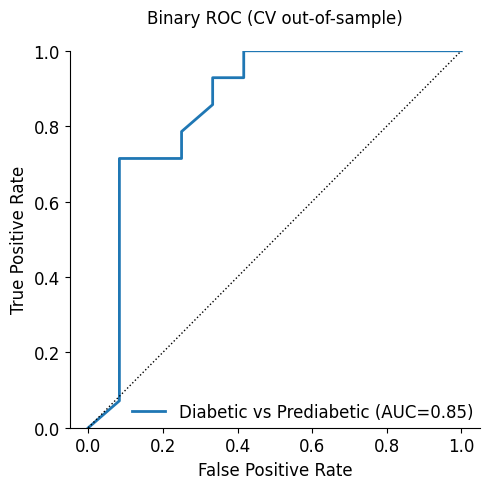

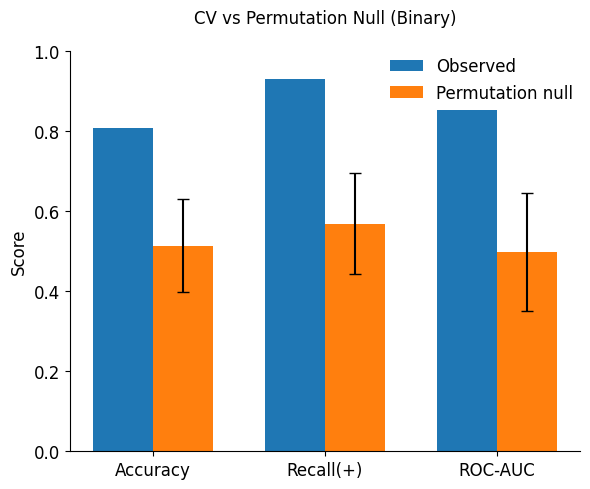

In [467]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_curve, auc

def plot_binary_roc_from_cv(y_true, y_proba, pos_label, neg_label,classes=None,
                            title="Binary ROC (CV out-of-sample)"):
    """
    y_true: 1D array of labels (can be strings/numbers)
    y_proba: either 1D (P(pos)) or 2D (n_samples x 2) probs
    pos_label: the positive class label (e.g., "T2D")
    classes: optional array-like of class labels in the same column order as y_proba (if 2D)
    """
    y_true = np.asarray(y_true)

    # Get P(pos) as a 1D vector
    if y_proba.ndim == 1:
        p_pos = np.asarray(y_proba)
    else:
        if classes is None:
            # Assume column 1 is positive if not specified (common convention)
            pos_idx = 1
        else:
            classes = np.asarray(classes)
            try:
                pos_idx = int(np.where(classes == pos_label)[0][0])
            except IndexError:
                raise ValueError(f"pos_label={pos_label!r} not found in classes={classes.tolist()}")
        p_pos = y_proba[:, pos_idx]

    y_bin = (y_true == pos_label).astype(int)

    fpr, tpr, _ = roc_curve(y_bin, p_pos)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(5,5))
    plt.plot(fpr, tpr, lw=2, label=f"{pos_label} vs {neg_label} (AUC={roc_auc:.2f})")
    plt.plot([0,1], [0,1], 'k:', lw=1)
    plt.xlabel("False Positive Rate", fontsize=12)
    plt.ylabel("True Positive Rate", fontsize=12)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.title(title, pad=20)
    sns.despine()
    plt.legend(frameon=False, fontsize=12, borderaxespad=0.0)
    plt.tight_layout()
    plt.ylim(0,1)
    plt.show()



plot_binary_roc_from_cv(y, y_proba_pos, pos_label="Diabetic", neg_label = "Prediabetic")
plot_cv_vs_null_binary(results, title="CV vs Permutation Null (Binary)")

/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

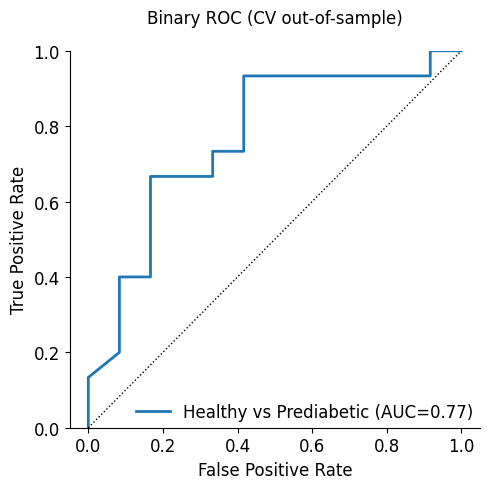

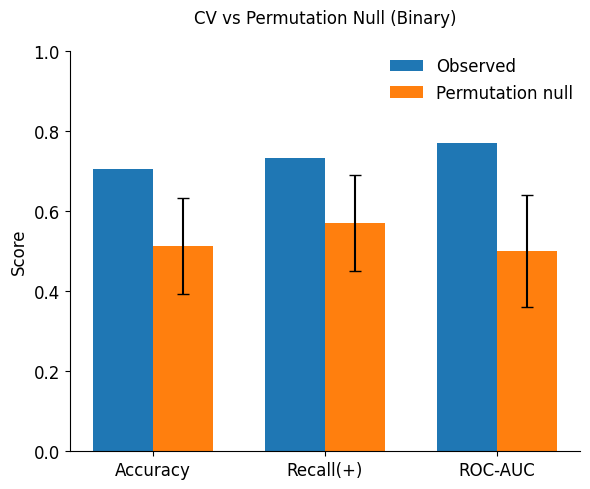

In [468]:
two_way_btw_prediabetes_diabetes = table_control_pat_spec_vec_df_filt['disease'] != "Diabetic"
two_way_enrichement_pre_dia = table_control_pat_spec_vec_df_filt[two_way_btw_prediabetes_diabetes]
two_way_enrichement_pre_dia

results, y, y_pred, y_proba_pos, pos, neg = binary_cv_vs_permutation_null(
df=two_way_enrichement_pre_dia,
target='disease',
drop_cols=['patient_id','disease'],
pos_label="Healthy",                 # your positive class *by name*
neg_label="Prediabetic",
cv_splits=5,
n_permutations=50,
random_state=42
)

plot_binary_roc_from_cv(y, y_proba_pos, pos_label="Healthy", neg_label = "Prediabetic")
plot_cv_vs_null_binary(results, title="CV vs Permutation Null (Binary)")

/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/local_home/guptaraj/anaconda3/envs/analysis_pipeline/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-lea

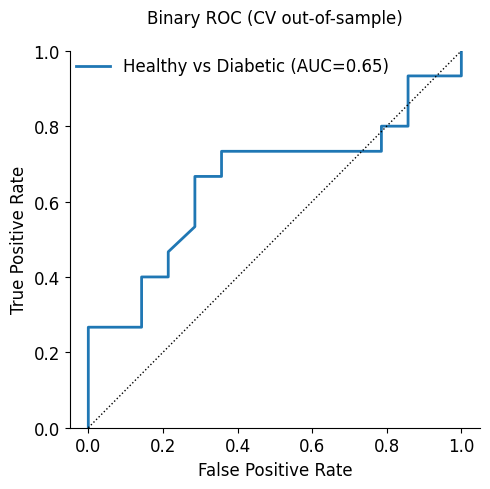

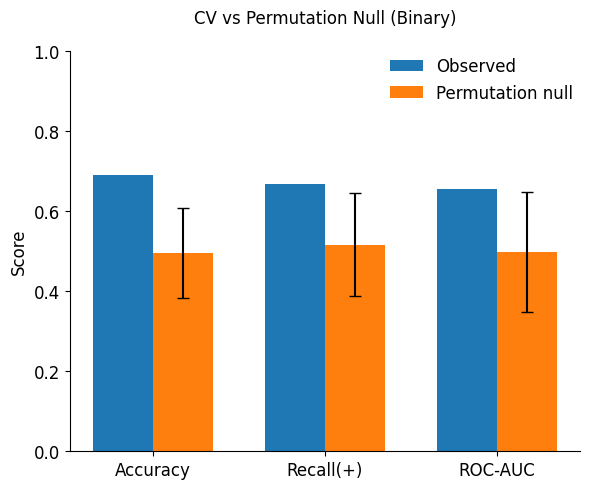

In [469]:
two_way_btw_prediabetes_diabetes = table_control_pat_spec_vec_df_filt['disease'] != "Prediabetic"
two_way_enrichement_pre_dia = table_control_pat_spec_vec_df_filt[two_way_btw_prediabetes_diabetes]
two_way_enrichement_pre_dia

results, y, y_pred, y_proba_pos, pos, neg = binary_cv_vs_permutation_null(
df=two_way_enrichement_pre_dia,
target='disease',
drop_cols=['patient_id','disease'],
pos_label="Healthy",                 # your positive class *by name*
neg_label="Diabetic",
cv_splits=5,
n_permutations=50,
random_state=42
)

plot_binary_roc_from_cv(y, y_proba_pos, pos_label="Healthy", neg_label = "Diabetic")
plot_cv_vs_null_binary(results, title="CV vs Permutation Null (Binary)")

In [470]:
feature_importance_df

,patient_id,run_type,feature,importance
0,98,Healthy vs Prediabetic,13.0,0.530881
1,98,Healthy vs Prediabetic,3.0,0.083697
2,98,Healthy vs Prediabetic,15.0,0.054391
3,98,Healthy vs Prediabetic,1.0,0.045634
4,98,Healthy vs Prediabetic,14.0,0.039312
...,...,...,...,...
1307,108,Diabetic vs Healthy,4.0,0.021064
1308,108,Diabetic vs Healthy,1.0,0.012987
1309,108,Diabetic vs Healthy,13.0,0.007365
1310,108,Diabetic vs Healthy,15.0,0.004951


In [471]:

grp_order = (feature_importance_df.groupby('feature')['importance']
               .mean()
               .sort_values(ascending=False)
               .index)
grp_order

Index([13.0,  5.0, 11.0,  8.0,  3.0, 14.0,  9.0, 12.0, 15.0,  1.0,  6.0,  7.0,
        2.0,  0.0,  4.0, 10.0],
      dtype='float64', name='feature')

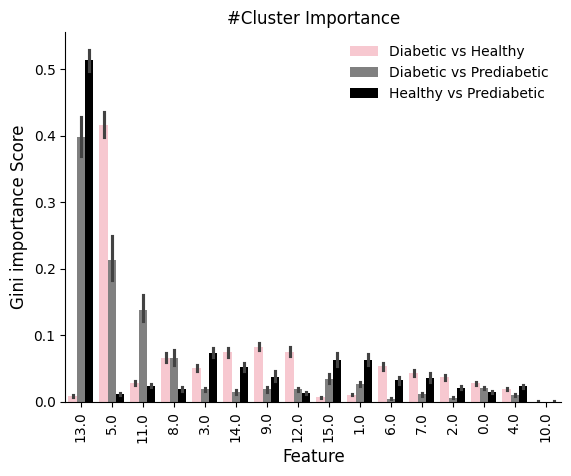

In [472]:
from statsmodels.formula.api import ols
import statsmodels.api as sm
from statsmodels.stats.multicomp import pairwise_tukeyhsd

feature_importance_df_sorted = feature_importance_df.sort_values(['importance','feature'], ascending=[True, False])
sns.barplot(data = feature_importance_df_sorted ,y = feature_importance_df_sorted['importance'], x = feature_importance_df_sorted['feature'],hue = 'run_type' ,palette =['pink','gray','black'] ,order =  grp_order)
sns.despine()
plt.title('#Cluster Importance', fontsize = 12)
plt.xlabel('Feature', fontsize = 12)
plt.ylabel('Gini importance Score', fontsize = 12)
plt.legend(frameon=False, title=None)
# plt.text(0.98, 0.98,
#         f"F = {F:.2f}\nP = {p:.3e}",
#         transform=ax.transAxes, ha='right', va='top',
#         bbox=dict(boxstyle='round', fc='white', ec='black'))
# print(anova_table)  # check overall p-value
plt.xticks(rotation = 90)
plt.show()
model = ols('importance ~ C(feature)', data=feature_importance_df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
p = float(anova_table.loc['C(feature)', 'PR(>F)'])
F = float(anova_table.loc['C(feature)', 'F'])

In [473]:

concentration_score


label_leiden,disease,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,11.0,12.0,13.0,14.0,patient_id,10.0,15.0
37,Diabetic,0.147541,0.090164,0.139344,0.102459,0.049180,0.151639,0.073770,0.045082,0.061475,0.069672,0.008197,0.024590,0.012295,0.024590,65,0.000000,0.000000
17,Diabetic,0.168033,0.086066,0.114754,0.077869,0.077869,0.151639,0.077869,0.065574,0.090164,0.040984,0.016393,0.020492,0.004098,0.008197,35,0.000000,0.000000
30,Diabetic,0.155556,0.102222,0.133333,0.142222,0.022222,0.071111,0.084444,0.071111,0.088889,0.075556,0.022222,0.022222,0.000000,0.004444,55,0.000000,0.004444
48,Diabetic,0.134146,0.097561,0.097561,0.121951,0.018293,0.134146,0.097561,0.054878,0.121951,0.048780,0.018293,0.036585,0.000000,0.012195,86,0.000000,0.006098
45,Diabetic,0.110656,0.127049,0.098361,0.102459,0.065574,0.106557,0.061475,0.102459,0.065574,0.045082,0.032787,0.040984,0.028689,0.012295,80,0.000000,0.000000
43,Diabetic,0.163934,0.069672,0.135246,0.081967,0.081967,0.069672,0.122951,0.061475,0.086066,0.065574,0.012295,0.020492,0.000000,0.004098,76,0.000000,0.024590
40,Diabetic,0.114754,0.118852,0.106557,0.110656,0.073770,0.110656,0.081967,0.073770,0.040984,0.061475,0.045082,0.024590,0.012295,0.024590,69,0.000000,0.000000
39,Diabetic,0.147541,0.127049,0.102459,0.081967,0.045082,0.098361,0.110656,0.081967,0.102459,0.028689,0.020492,0.040984,0.000000,0.012295,67,0.000000,0.000000
25,Diabetic,0.176230,0.098361,0.110656,0.135246,0.077869,0.127049,0.065574,0.045082,0.045082,0.053279,0.028689,0.020492,0.008197,0.008197,46,0.000000,0.000000
36,Diabetic,0.168033,0.077869,0.168033,0.073770,0.040984,0.127049,0.061475,0.053279,0.086066,0.057377,0.024590,0.016393,0.000000,0.045082,64,0.000000,0.000000


0.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.295e-02 U_stat=1.260e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.671e-02 (ns) U_stat=3.700e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.130e-01 U_stat=1.080e+02


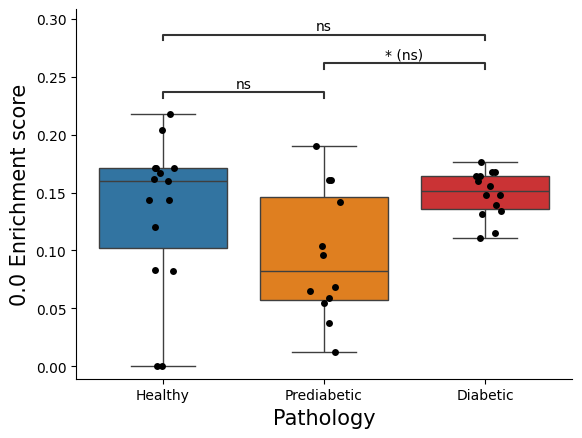

1.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.494e-01 U_stat=6.000e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.016e-02 U_stat=1.210e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.826e-01 U_stat=1.040e+02


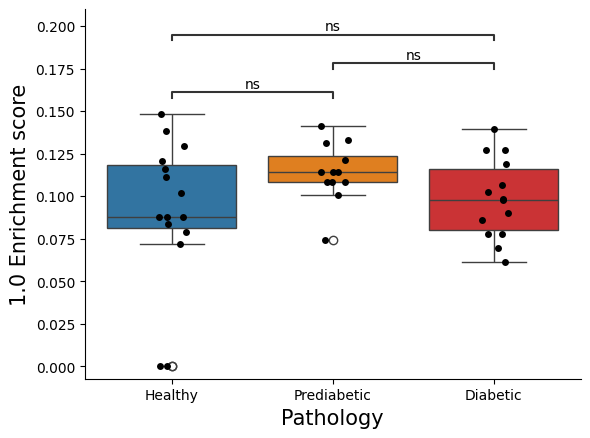

2.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.411e-01 U_stat=1.100e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.519e-02 (ns) U_stat=4.000e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.690e-01 U_stat=7.300e+01


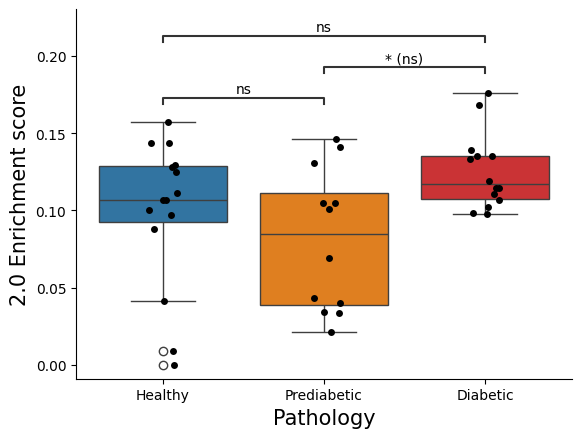

3.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.408e-01 U_stat=7.000e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.992e-01 U_stat=7.600e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.431e-01 U_stat=7.100e+01


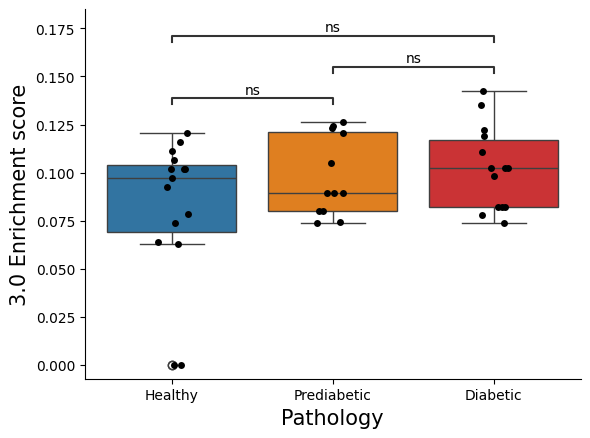

4.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.325e-02 U_stat=4.300e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.086e-02 U_stat=1.340e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.433e-01 U_stat=1.130e+02


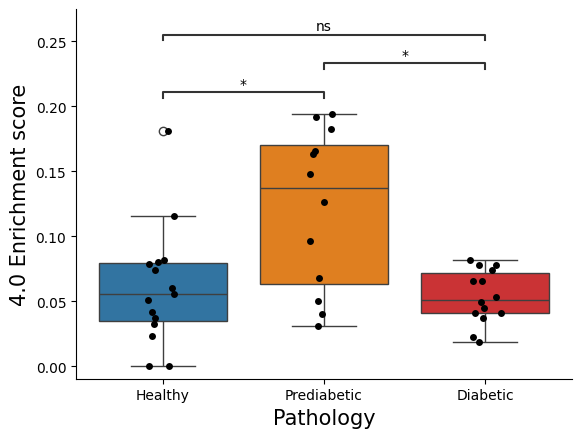

5.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.794e-01 U_stat=1.180e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.898e-04 U_stat=1.100e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.197e-03 U_stat=3.700e+01


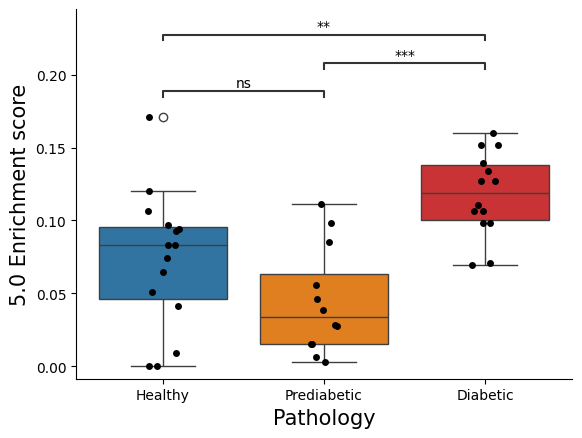

6.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.689e-02 U_stat=1.295e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.087e-02 U_stat=3.400e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:9.131e-01 U_stat=1.020e+02


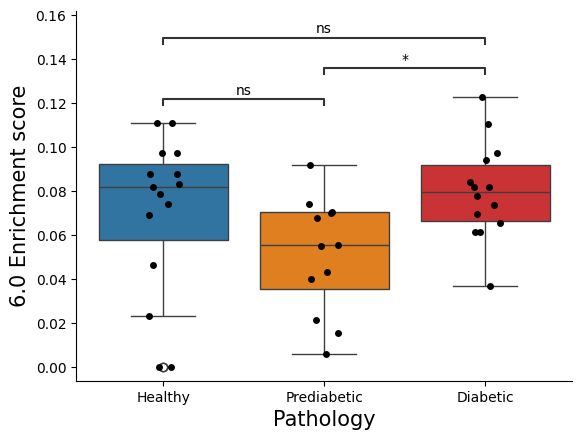

7.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.405e-01 U_stat=7.000e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.995e-01 U_stat=7.600e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:3.702e-01 U_stat=8.400e+01


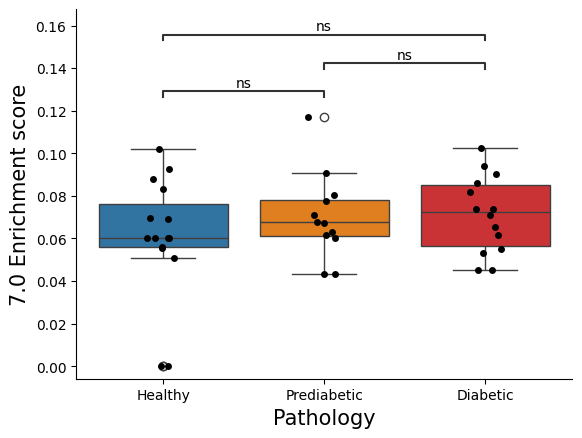

8.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.044e-01 U_stat=1.165e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.073e-03 U_stat=2.000e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.208e-01 U_stat=6.900e+01


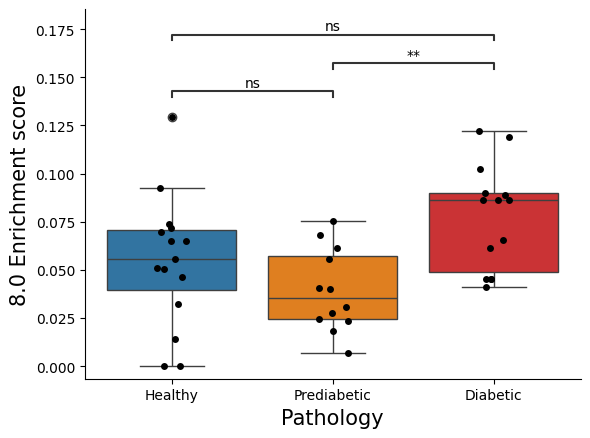

9.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.739e-01 U_stat=1.020e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.208e-02 (ns) U_stat=4.400e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.971e-01 U_stat=7.500e+01


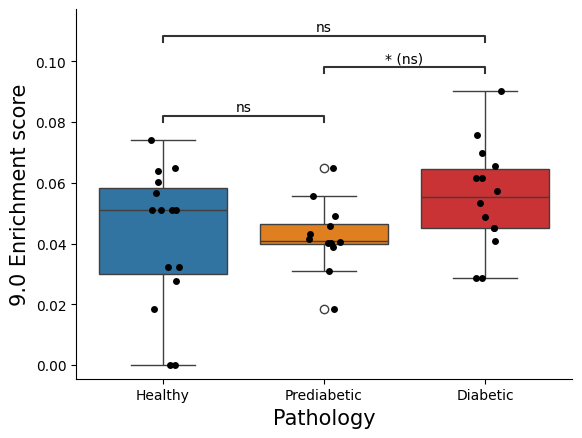

11.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.764e-03 U_stat=3.500e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.337e-04 U_stat=1.560e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.263e-01 U_stat=1.200e+02


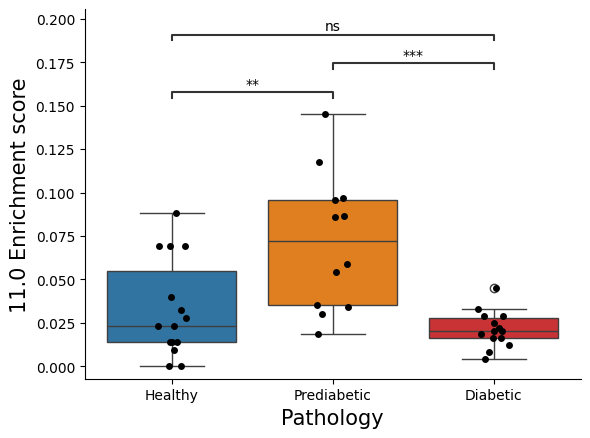

12.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.677e-02 U_stat=5.050e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.003e-02 U_stat=1.210e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.187e-01 U_stat=8.600e+01


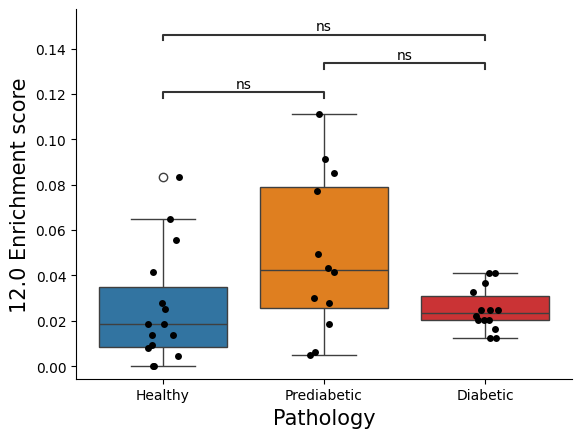

13.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.669e-04 U_stat=1.550e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:5.599e-05 U_stat=1.620e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:4.867e-01 U_stat=1.205e+02


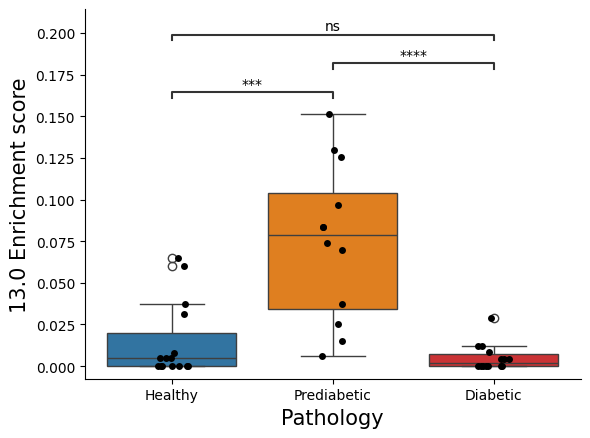

14.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.508e-01 U_stat=9.700e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.049e-01 U_stat=1.160e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.493e-01 U_stat=1.385e+02


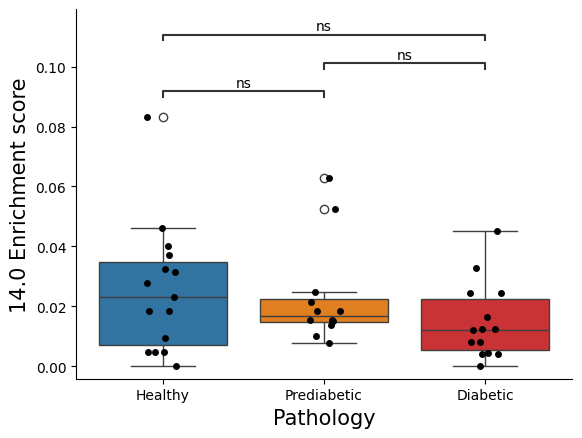

10.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:2.167e-01 U_stat=1.020e+02
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.000e+00 U_stat=8.400e+01
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:1.800e-01 U_stat=1.190e+02


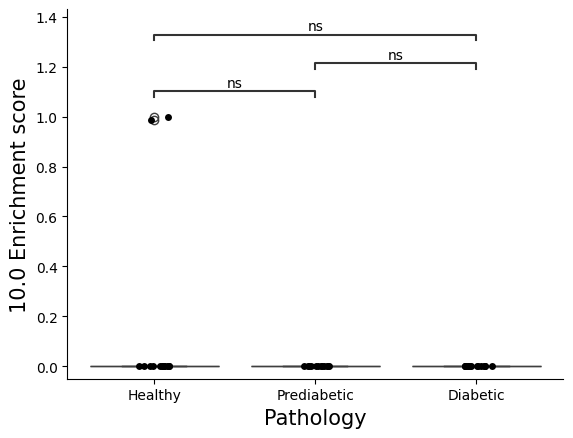

15.0
p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Healthy vs. Prediabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:7.109e-03 U_stat=3.750e+01
Prediabetic vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:6.913e-03 U_stat=1.350e+02
Healthy vs. Diabetic: Mann-Whitney-Wilcoxon test two-sided with Benjamini-Hochberg correction, P_val:8.314e-01 U_stat=1.005e+02


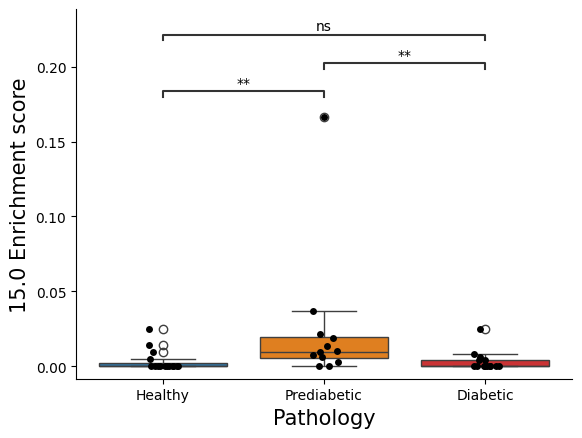

In [474]:
from statannotations.Annotator import Annotator
pairs = [('Healthy', 'Prediabetic'), ('Healthy', 'Diabetic'),('Prediabetic','Diabetic')]
for i in table_control_pat_spec_vec_df_filt.drop(columns = ['disease','patient_id']).columns.tolist():
    print(i)
    cond1 = table_control_pat_spec_vec_df_filt['disease'] != 'Healthy'
    concentration_score = table_control_pat_spec_vec_df_filt#[cond1]
    order = ['Healthy', 'Prediabetic', 'Diabetic']
    ax = sns.boxplot(concentration_score, x= 'disease' ,y = i, hue = 'disease', palette =(control_palette[0],control_palette[1],control_palette[2]), order = order)
    ax = sns.stripplot(concentration_score, x= 'disease' ,y = i,color = "black")
    sns.despine()
    # y_line = float(value) # adjust as needed
    # plt.axhline(y=y_line, color="red", linestyle="--", linewidth=1.5)
    annotator = Annotator(ax, pairs, data=concentration_score, x='disease', y=i, order = order)

    annotator.configure(
        test="Mann-Whitney",
        text_format="star",      # or "simple", "passthrough"
        comparisons_correction="BH",  # Benjamini-Hochberg; set to None to skip
        verbose=2,               # prints stats to console
    )
    annotator.apply_and_annotate()
    # plt.annotate(
    #     "Threshold ="+str(value),
    #     xy=(0.02, y_line + 0.02),  # small offset
    #     xycoords=("axes fraction", "data"),
    #     color="black",
    # )
    plt.ylabel(str(i)+' Enrichment score', fontsize = 15)
    plt.xlabel('Pathology', fontsize = 15)
    plt.show()

In [475]:
cohort_details = pd.read_csv('cohort_details.csv')

cohort_details = cohort_details.rename(columns={"Sample No": "patient_id"})
cohort_details
table_control_pat_spec_vec_df_filt = pd.DataFrame(table_control_pat_spec_vec_df_filt)

In [476]:
table_control_pat_spec_vec_df_filt = table_control_pat_spec_vec_df_filt.copy(); cohort_details = cohort_details.copy()
table_control_pat_spec_vec_df_filt['patient_id'] = pd.to_numeric(table_control_pat_spec_vec_df_filt['patient_id'], errors='coerce')
cohort_details['patient_id'] = pd.to_numeric(cohort_details['patient_id'], errors='coerce')

# If you need missing-friendly ints, use pandas nullable Int64
table_control_pat_spec_vec_df_filt['patient_id'] = table_control_pat_spec_vec_df_filt['patient_id'].astype('Int64')
cohort_details['patient_id'] = cohort_details['patient_id'].astype('Int64')

out = table_control_pat_spec_vec_df_filt.merge(cohort_details, on='patient_id', how='left', validate='one_to_one')

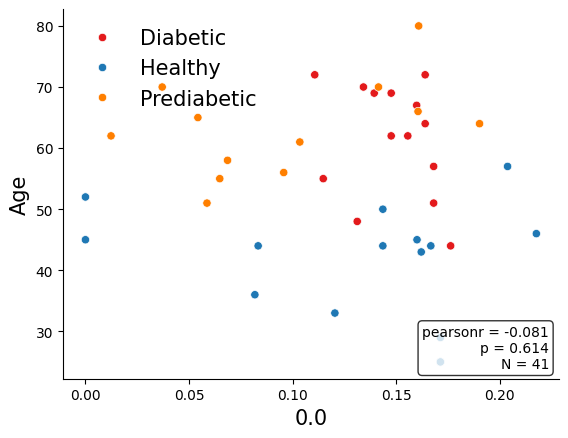

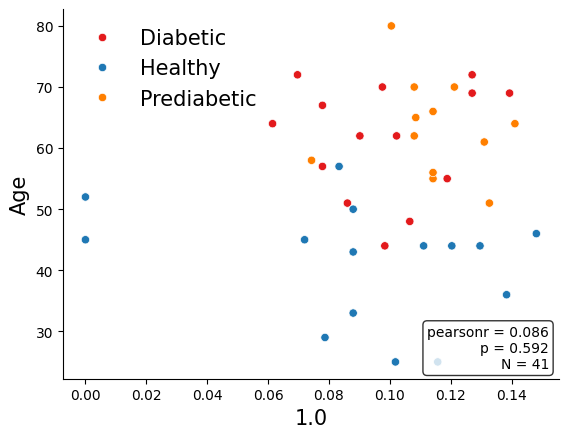

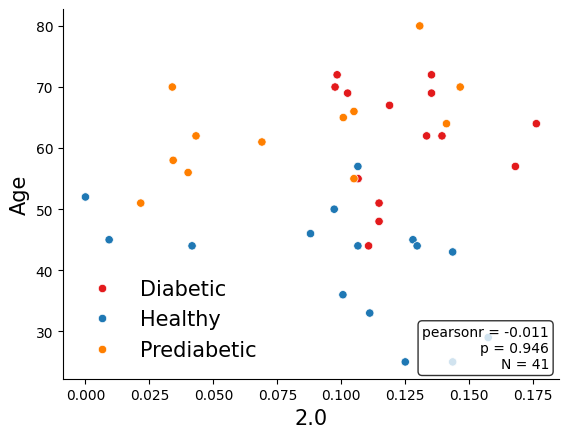

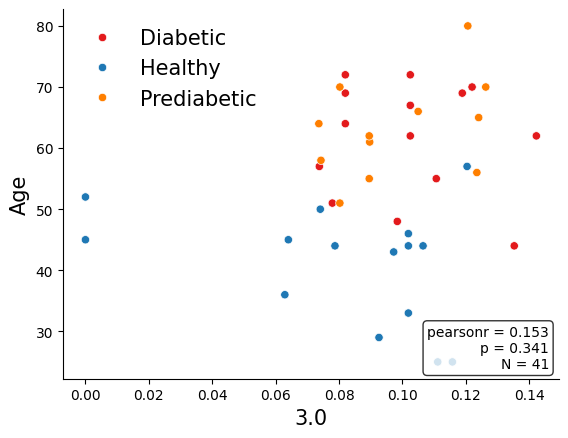

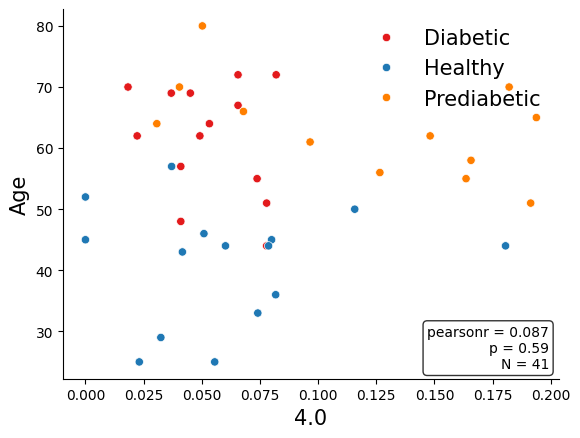

...

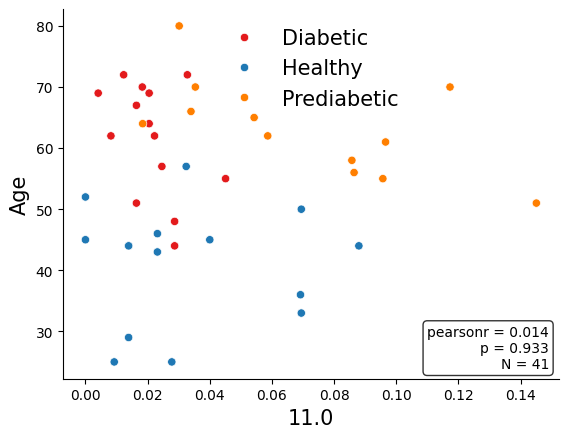

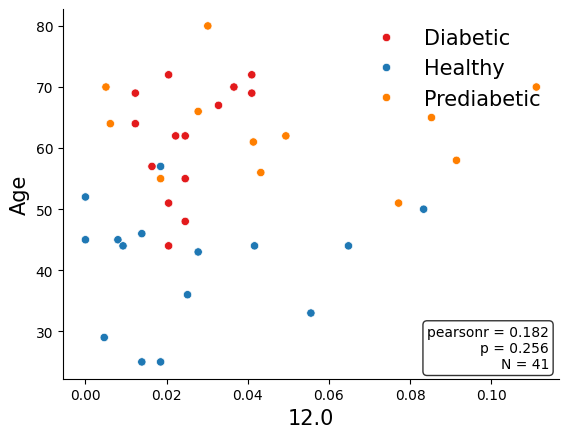

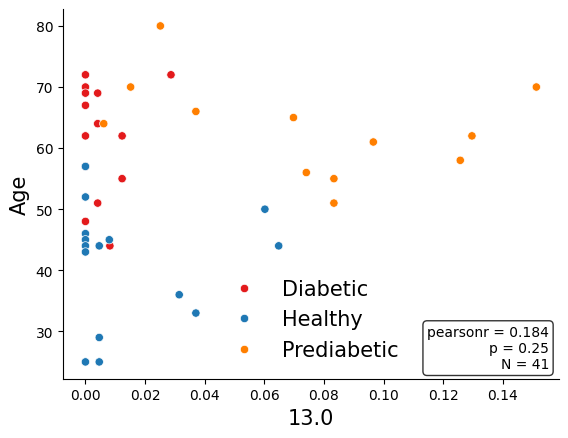

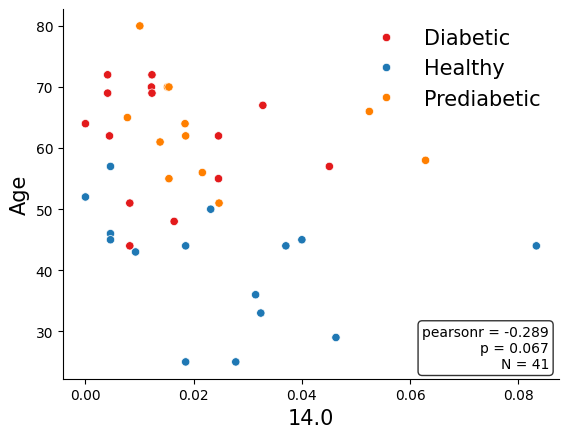

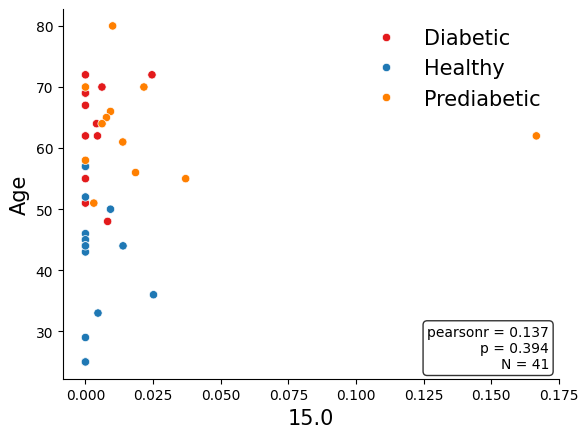

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  2.469788  0.036828   
1      Healthy         2  [F, M]  t-test_welch  0.451795  0.659127   
2  Prediabetic         2  [M, F]  t-test_welch  0.505460  0.642569   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  1.365460  0.110483  
1   {'F': 7, 'M': 8}  0.234185  0.659127  
2  {'M': 10, 'F': 2}  0.291774  0.659127  


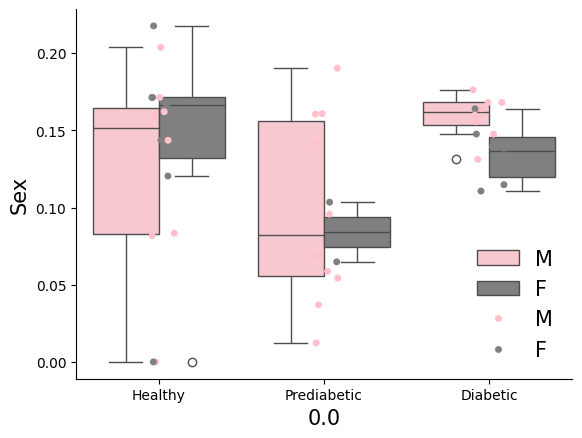

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -1.870381  0.106090   
1      Healthy         2  [F, M]  t-test_welch  0.137950  0.892496   
2  Prediabetic         2  [M, F]  t-test_welch -1.014334  0.412932   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -1.055807  0.318270  
1   {'F': 7, 'M': 8}  0.071582  0.892496  
2  {'M': 10, 'F': 2} -0.673195  0.619398  


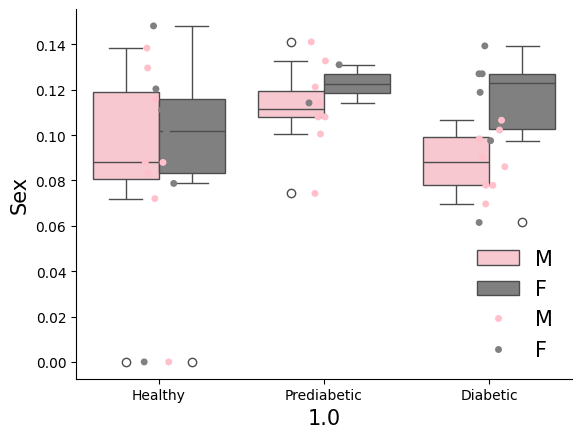

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.692975  0.508545   
1      Healthy         2  [F, M]  t-test_welch  0.439454  0.668059   
2  Prediabetic         2  [M, F]  t-test_welch -0.302845  0.782225   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.386269  0.782225  
1   {'F': 7, 'M': 8}  0.228383  0.782225  
2  {'M': 10, 'F': 2} -0.183077  0.782225  


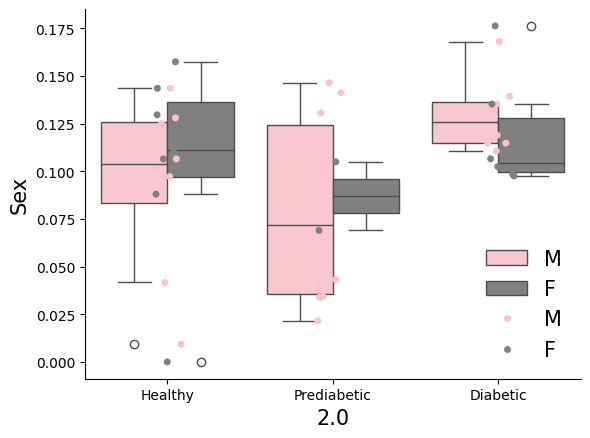

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -0.102639  0.919949   
1      Healthy         2  [F, M]  t-test_welch  0.254951  0.802835   
2  Prediabetic         2  [M, F]  t-test_welch  1.431705  0.186019   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -0.054029  0.919949  
1   {'F': 7, 'M': 8}  0.131962  0.919949  
2  {'M': 10, 'F': 2}  0.640306  0.558056  


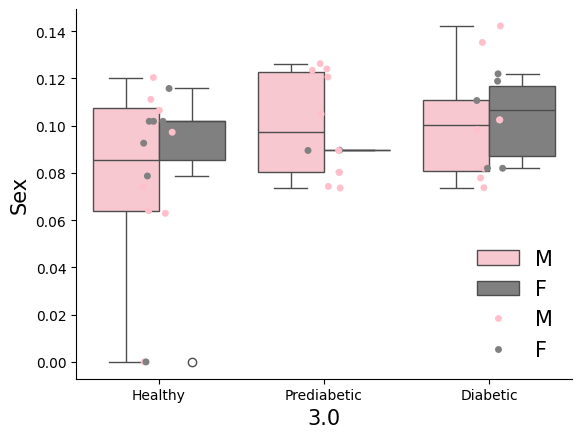

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.733900  0.477815   
1      Healthy         2  [F, M]  t-test_welch -0.861787  0.408695   
2  Prediabetic         2  [M, F]  t-test_welch -0.262817  0.818491   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.393885  0.716722  
1   {'F': 7, 'M': 8} -0.436316  0.716722  
2  {'M': 10, 'F': 2} -0.180591  0.818491  


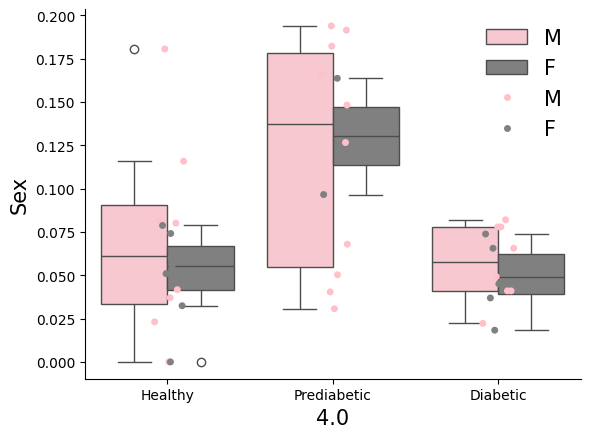

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.001413  0.998896   
1      Healthy         2  [F, M]  t-test_welch  0.501718  0.624824   
2  Prediabetic         2  [M, F]  t-test_welch  2.015734  0.074674   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.000747  0.998896  
1   {'F': 7, 'M': 8}  0.260694  0.937236  
2  {'M': 10, 'F': 2}  0.983873  0.224023  


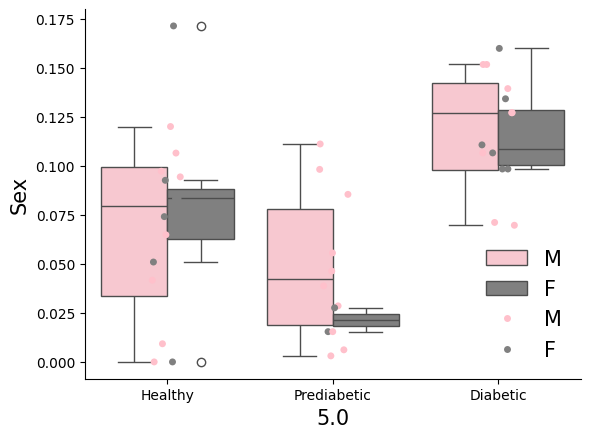

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -1.261945  0.231013   
1      Healthy         2  [F, M]  t-test_welch  0.400354  0.695417   
2  Prediabetic         2  [M, F]  t-test_welch -1.145549  0.294147   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -0.664194  0.441220  
1   {'F': 7, 'M': 8}  0.206593  0.695417  
2  {'M': 10, 'F': 2} -0.598443  0.441220  


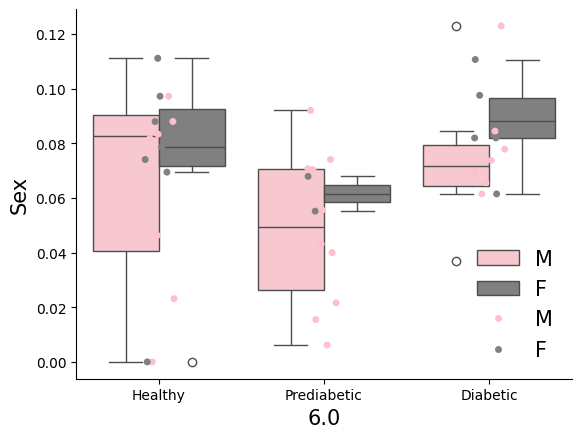

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -2.355026  0.040666   
1      Healthy         2  [F, M]  t-test_welch -0.197826  0.846434   
2  Prediabetic         2  [M, F]  t-test_welch -0.319827  0.801942   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -1.286165  0.121998  
1   {'F': 7, 'M': 8} -0.102759  0.846434  
2  {'M': 10, 'F': 2} -0.312344  0.846434  


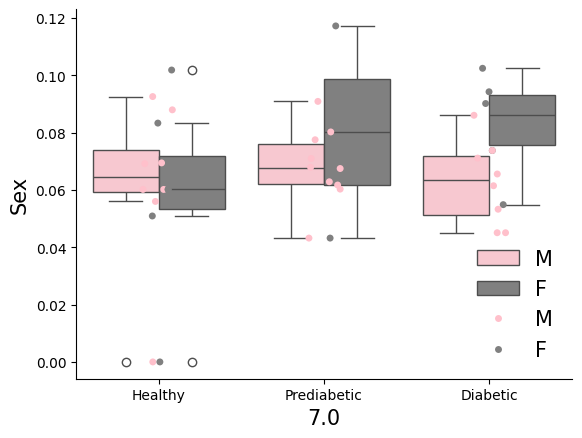

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.793149  0.450691   
1      Healthy         2  [F, M]  t-test_welch  0.796261  0.441662   
2  Prediabetic         2  [M, F]  t-test_welch  0.389075  0.757248   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.441189  0.676037  
1   {'F': 7, 'M': 8}  0.414619  0.676037  
2  {'M': 10, 'F': 2}  0.346785  0.757248  


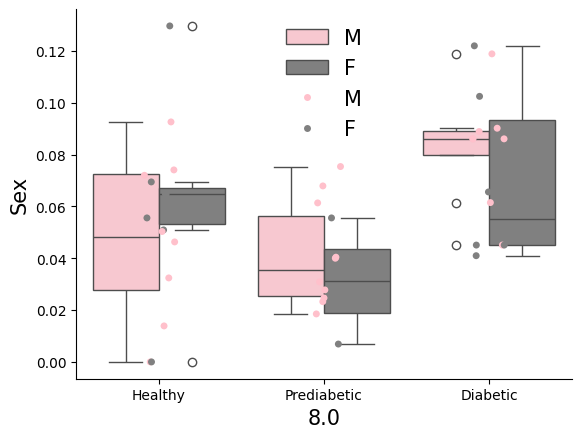

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.787678  0.456791   
1      Healthy         2  [F, M]  t-test_welch -1.185612  0.257666   
2  Prediabetic         2  [M, F]  t-test_welch  1.156471  0.354849   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.442731  0.456791  
1   {'F': 7, 'M': 8} -0.607085  0.456791  
2  {'M': 10, 'F': 2}  0.749233  0.456791  


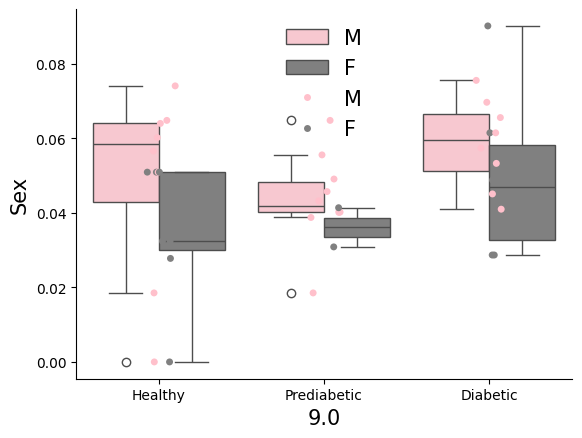

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch       NaN       NaN   
1      Healthy         2  [F, M]  t-test_welch  0.103841  0.918959   
2  Prediabetic         2  [M, F]  t-test_welch       NaN       NaN   

         n_per_group   cohen_d  p_adj  
0   {'M': 8, 'F': 6}       NaN    NaN  
1   {'F': 7, 'M': 8}  0.053887    NaN  
2  {'M': 10, 'F': 2}       NaN    NaN  


/tmp/ipykernel_3328293/1981069598.py:56: RuntimeWarning: invalid value encountered in scalar divide
  d_eff = (np.nanmean(x) - np.nanmean(y)) / np.sqrt(
/tmp/ipykernel_3328293/1981069598.py:56: RuntimeWarning: invalid value encountered in scalar divide
  d_eff = (np.nanmean(x) - np.nanmean(y)) / np.sqrt(


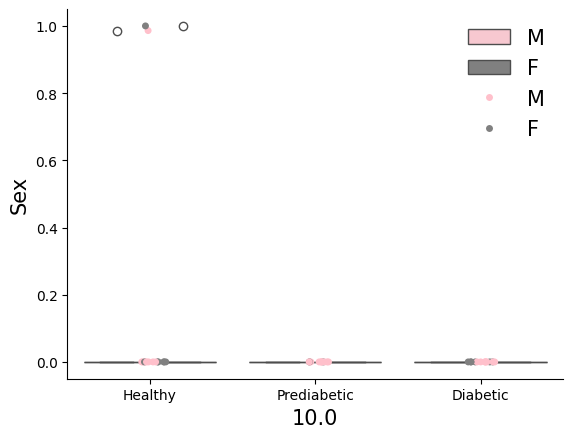

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -0.612821  0.558850   
1      Healthy         2  [F, M]  t-test_welch -1.314109  0.212375   
2  Prediabetic         2  [M, F]  t-test_welch -2.261436  0.049997   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -0.343615  0.558850  
1   {'F': 7, 'M': 8} -0.672535  0.318563  
2  {'M': 10, 'F': 2} -1.011795  0.149990  


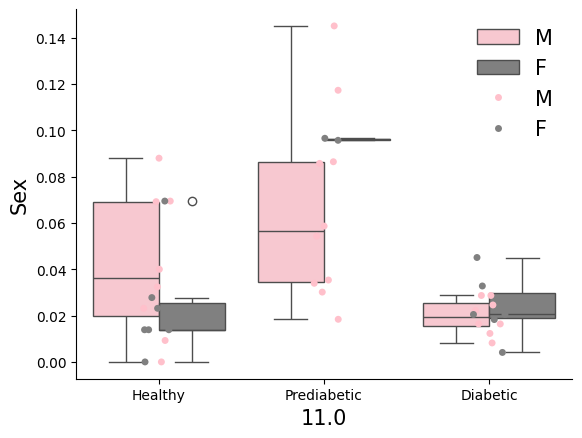

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -0.898852  0.403564   
1      Healthy         2  [F, M]  t-test_welch -0.855011  0.408502   
2  Prediabetic         2  [M, F]  t-test_welch  1.391265  0.241603   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -0.511563  0.408502  
1   {'F': 7, 'M': 8} -0.437845  0.408502  
2  {'M': 10, 'F': 2}  0.797928  0.408502  


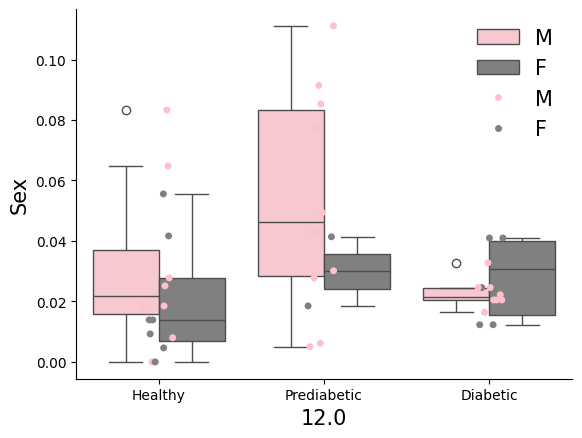

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch -1.068086  0.323978   
1      Healthy         2  [F, M]  t-test_welch -1.195009  0.258911   
2  Prediabetic         2  [M, F]  t-test_welch -1.041654  0.322585   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6} -0.604311  0.323978  
1   {'F': 7, 'M': 8} -0.605326  0.323978  
2  {'M': 10, 'F': 2} -0.494958  0.323978  


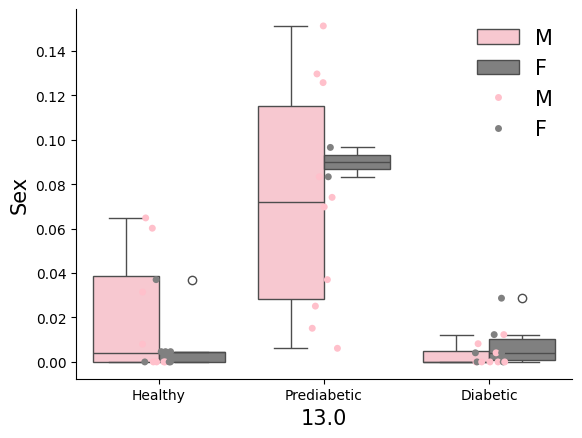

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  1.117563  0.286846   
1      Healthy         2  [F, M]  t-test_welch -0.495784  0.628888   
2  Prediabetic         2  [M, F]  t-test_welch  1.730539  0.116385   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.580912  0.430269  
1   {'F': 7, 'M': 8} -0.253174  0.628888  
2  {'M': 10, 'F': 2}  0.780121  0.349155  


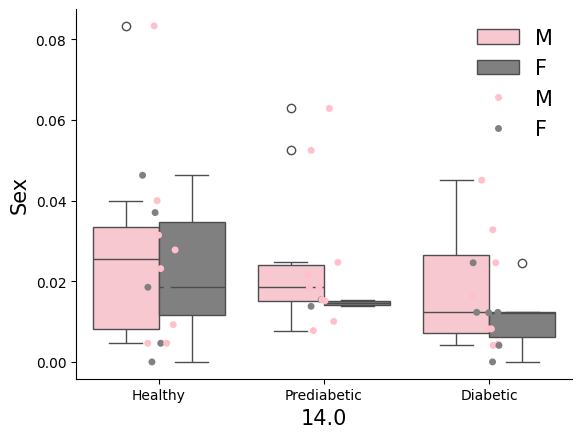

         label  k_groups  groups          test      stat         p  \
0     Diabetic         2  [M, F]  t-test_welch  0.912772  0.385804   
1      Healthy         2  [F, M]  t-test_welch -1.585112  0.153840   
2  Prediabetic         2  [M, F]  t-test_welch -0.056071  0.957112   

         n_per_group   cohen_d     p_adj  
0   {'M': 8, 'F': 6}  0.463187  0.578707  
1   {'F': 7, 'M': 8} -0.794446  0.461520  
2  {'M': 10, 'F': 2} -0.029487  0.957112  


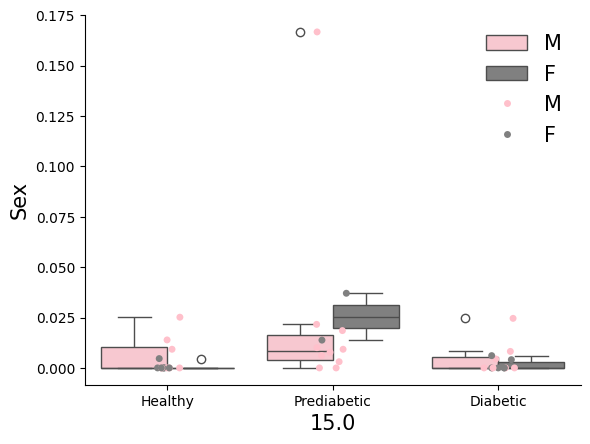

In [544]:
from scipy.stats import spearmanr, pearsonr

out[0.0]

interesting_clusters = [0.0,1.0,2.0,3.0,4.0, 5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0]



for cluster in interesting_clusters:
    d = out[[cluster, 'Age']].dropna()
    n = len(d)
    r, p = pearsonr(d[cluster], d['Age'])
    ax = sns.scatterplot(out, x = cluster, y = 'Age', hue = 'disease',palette =(control_palette[0],control_palette[1],control_palette[2]) )
    sns.despine()
    ax.text(
    0.98, 0.02,
    f"pearsonr = {r:.3f}\np = {p:.3g}\nN = {n}",
    transform=ax.transAxes, ha="right", va="bottom",
    bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", alpha=0.8)
    )
    plt.xlabel(cluster,fontsize = 15)
    plt.ylabel('Age',fontsize = 15)
    plt.legend(frameon=False, title=None, fontsize = 15)
    plt.show()

import numpy as np
import pandas as pd
from scipy import stats
from statsmodels.stats.multitest import multipletests

def pvals_by_label(
    df, value_col="value", label_col="label", group_col="group",
    two_group_test="welch",          # "welch" or "mannwhitney"
    multi_group_test="kruskal",      # "anova" or "kruskal"
    p_adjust="fdr_bh",               # multiple-testing correction
    dropna=True
):
    rows = []
    for lbl, sub in df.groupby(label_col, dropna=False):
        d = sub[[value_col, group_col]].dropna() if dropna else sub[[value_col, group_col]]
        # collect groups in appearance order
        grouped = [(g, gdf[value_col].to_numpy()) for g, gdf in d.groupby(group_col, sort=False)]
        k = len(grouped)
        if k < 2:
            continue  # not enough groups to test

        names = [str(g) for g, _ in grouped]
        arrays = [arr for _, arr in grouped]

        if k == 2:
            x, y = arrays
            if two_group_test == "welch":
                stat, p = stats.ttest_ind(x, y, equal_var=False, nan_policy="omit")
                test = "t-test_welch"
                # Cohen's d (pooled SD)
                d_eff = (np.nanmean(x) - np.nanmean(y)) / np.sqrt(
                    (np.nanvar(x, ddof=1) + np.nanvar(y, ddof=1)) / 2
                )
                effect_name, effect = "cohen_d", d_eff
            elif two_group_test == "mannwhitney":
                stat, p = stats.mannwhitneyu(x, y, alternative="two-sided")
                test = "mannwhitney"
                # Cliff's delta from U: delta = 2U/(n1*n2) - 1
                n1, n2 = len(x), len(y)
                effect_name, effect = "cliffs_delta", 2*stat/(n1*n2) - 1
            else:
                raise ValueError("two_group_test must be 'welch' or 'mannwhitney'")

            rows.append({
                "label": lbl, "k_groups": k, "groups": names, "test": test,
                "stat": float(stat), "p": float(p),
                "n_per_group": {names[0]: len(x), names[1]: len(y)},
                effect_name: float(effect),
            })

        else:
            if multi_group_test == "anova":
                stat, p = stats.f_oneway(*arrays)
                test = "anova"
            elif multi_group_test == "kruskal":
                stat, p = stats.kruskal(*arrays)
                test = "kruskal"
            else:
                raise ValueError("multi_group_test must be 'anova' or 'kruskal'")

            rows.append({
                "label": lbl, "k_groups": k, "groups": names, "test": test,
                "stat": float(stat), "p": float(p),
                "n_per_group": dict(zip(names, map(len, arrays))),
            })

    out = pd.DataFrame(rows)
    if not out.empty and p_adjust:
        out["p_adj"] = multipletests(out["p"].values, method=p_adjust)[1]
    return out


for cluster in interesting_clusters:
    input_df = out[[cluster,'disease','Sex']]
    output_p = pvals_by_label(
    input_df, value_col=cluster, label_col="disease", group_col="Sex",
    two_group_test="welch",          # "welch" or "mannwhitney"
    multi_group_test="kruskal",      # "anova" or "kruskal"
    p_adjust="fdr_bh",               # multiple-testing correction
    dropna=True
    )
    print(output_p)
    
    order = ['Healthy','Prediabetic','Diabetic']
    sns.boxplot(out, y = cluster, x = 'disease', hue = 'Sex', palette =['pink','gray'],order=order)
    sns.stripplot(out, y = cluster, x = 'disease', hue = 'Sex', palette =['pink','gray'],order=order)
    sns.despine()
    plt.xlabel(cluster,fontsize = 15)
    plt.ylabel('Sex',fontsize = 15)
    plt.legend(frameon=False, title=None, fontsize = 15)
    plt.show()


    
